In [1]:
import scipy
import numpy             as np
import matplotlib.pyplot as plt
from data      import make_rectangle, insert_shape, plot_data
from agent     import Agent
from tst_optim import cas_train_cbf, get_h, get_learning_cbfs_lagrangian
from utils     import plot_cbf

import hj_reachability as hj

from timeit import default_timer as timer

%load_ext autoreload
%autoreload 2

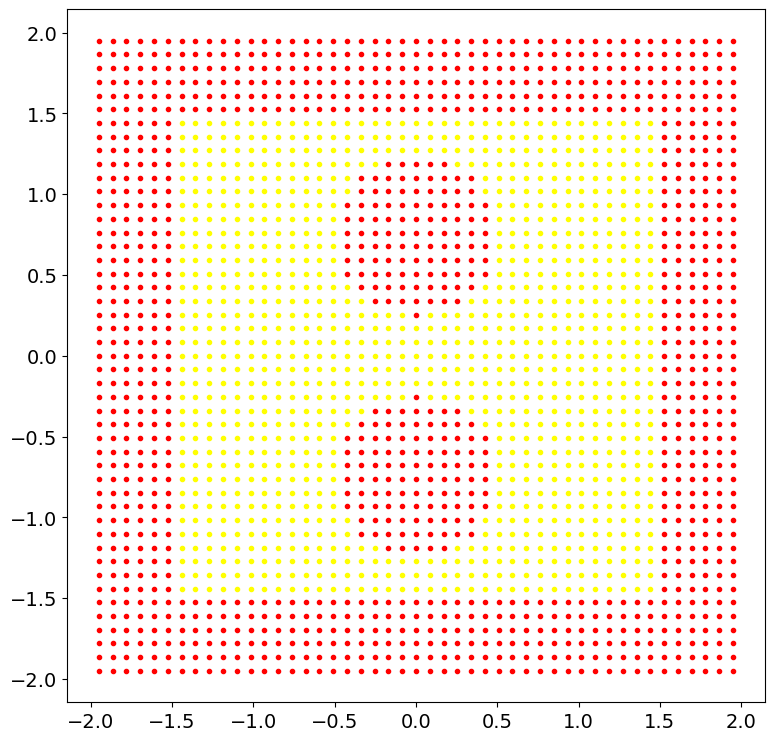

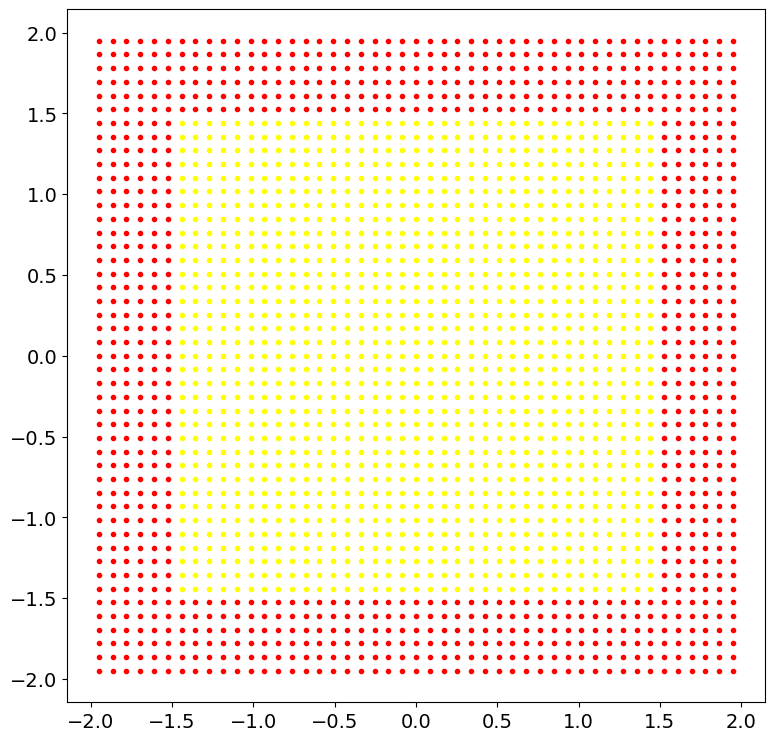

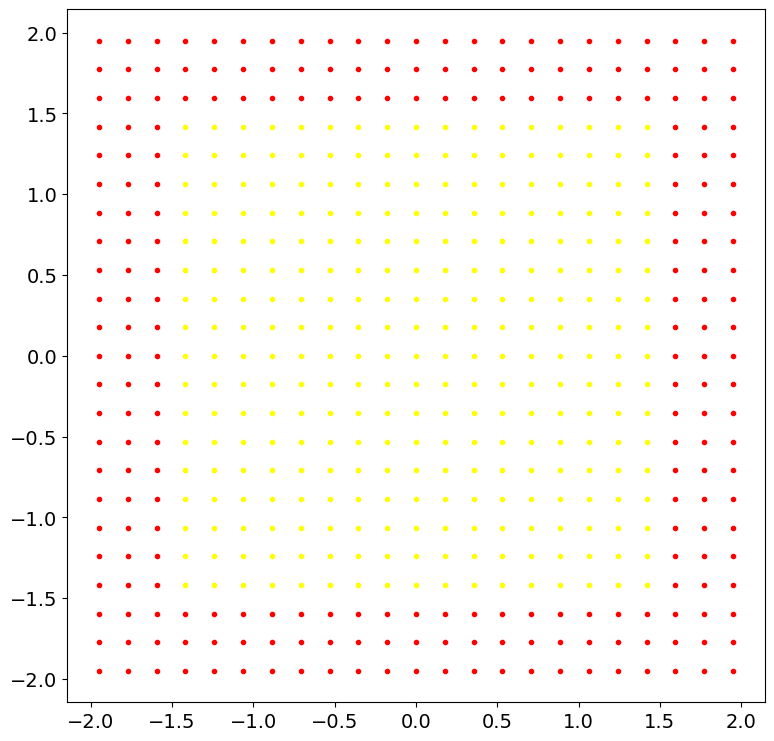

In [2]:
#########################
### Data Construction ###
#########################

# grid parameters 
width         = 3
unsafe_margin = 0.3

# main grid -- unsafe_margin defines wall obstacles
grid, obs_dict = make_rectangle(height=width, width=width, density=150, unsafe_margin=unsafe_margin, center=(0,0))

# generate two circular obstacles
obs_dict = insert_shape(np.array([0,  0.75]), grid, obs_dict, shape='circle', scale=0.5, theta=0)
obs_dict = insert_shape(np.array([0, -0.75]), grid, obs_dict, shape='circle', scale=0.5, theta=0)

# supplementary grids for [c]enters and unsafe [s]amples
c_grid, c_obs_dict = make_rectangle(height=width, width=width, density=150, unsafe_margin=unsafe_margin, center=(0,0))
s_grid, s_obs_dict = make_rectangle(height=width, width=width, density=35 , unsafe_margin=unsafe_margin, center=(0,0))

# show the created grids
plot_data(  grid,   obs_dict)
plot_data(c_grid, c_obs_dict)
plot_data(s_grid, s_obs_dict)

In [3]:
###########################
### Agent Configuration ###
###########################

dynamics = hj.systems.Planar()
bf = 31   # csrbf order
b  = 0.0    # offset 
s  = 0.66 # csrbf zeroing
sensor_radius = 1
rx = 1.5 # sample radius
nm = 0.2 # nm * n_safe = number of neighbors to consider
p  = 0.5 # num neighber percentile under which boundary
rc = 1   # radius around scan in which centers are chosen

# make agent
a = Agent(dynamics, np.array([0, 0]), grid, obs_dict, width=width, 
                                            sensor_radius=1, 
                                            bf = bf, 
                                            b = b, 
                                            s = s)

obstacles=np.array([pt for pt in grid if obs_dict[tuple(np.round(pt, 3))] != 0])
a.obstacles = obstacles

In [4]:
############################
### Scan for initial CBF ###
############################

# scan for obstacles and generate unsafe samples
scan_safe, scan_unsafe = a.scan()
samples  = a.sample(rx, grid=s_grid)
if scan_unsafe.shape[0] != 0:
    x_unsafe = np.vstack((scan_unsafe, samples))
else: # in case no obstacles detected
    x_unsafe = samples

# create buffer region
n_safe = scan_safe.shape[0]
x_buffer, x_safe = a.make_buffer(scan_safe, int(nm * n_safe), p)

# collect centers within rc from c_grid
C = []
for x in c_grid:
    if np.linalg.norm(x - a.pos) <= rc:
        C.append(x)
C = np.array(C)
print(C.shape)
a.centers.append(C)

(437, 2)


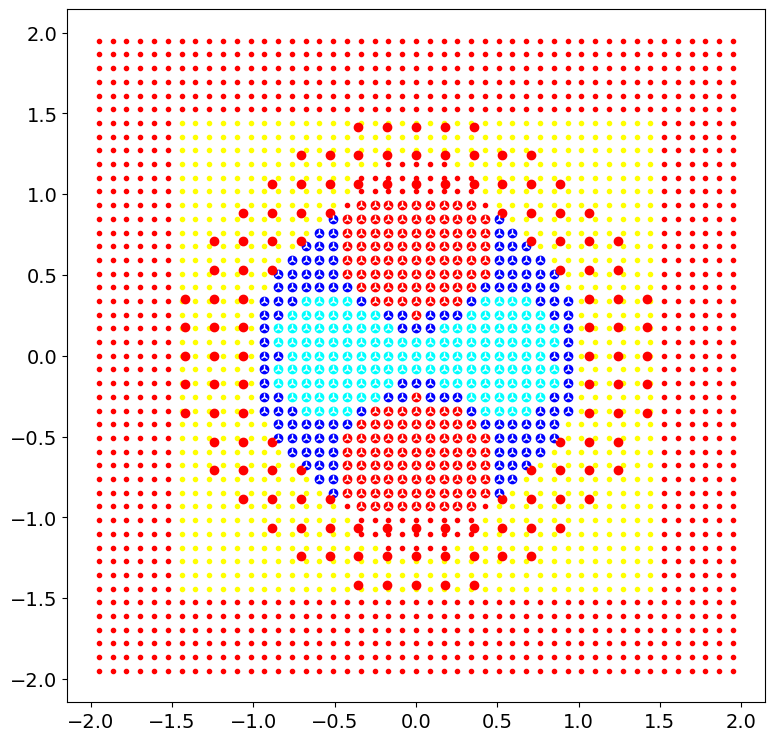

In [5]:
#############################
### Plot initial CBF data ###
#############################

plot_data(grid, obs_dict, [(x_safe  , "cyan"  , 'o'), 
                           (x_buffer, "blue"  , 'o'), 
                           (x_unsafe, "red"   , 'o'),
                           (C       , "white" , '2')])

In [6]:
##############################
### Initial CBF Parameters ###
##############################

gamma_safe   = 0.3
gamma_unsafe = 0.0
gamma_dyn    = 0.1
lam_safe     = 25
lam_dyn      = 5
lam_unsafe   = 125
lam_dh       = 1

In [7]:
#########################
### Solve Initial CBF ###
#########################

h = get_h(a)
L = get_learning_cbfs_lagrangian(a, x_safe, x_buffer, x_unsafe, lam_safe, lam_dyn, lam_unsafe, lam_dh, gamma_safe, gamma_dyn, gamma_unsafe)
theta, _, _ = scipy.optimize.fmin_l_bfgs_b(L, np.random.rand(C.shape[0], 1), approx_grad=False, iprint=50)
a.thetas.append(theta)
a.rectify_c_and_theta()

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          437     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.87094D+03    |proj g|=  2.64498D+01

At iterate   50    f=  8.46552D+02    |proj g|=  1.01370D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  437     82    139      1     0     0   4.721D-01   8.465D+02
  F =   846.52341055607315     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(437, 2)


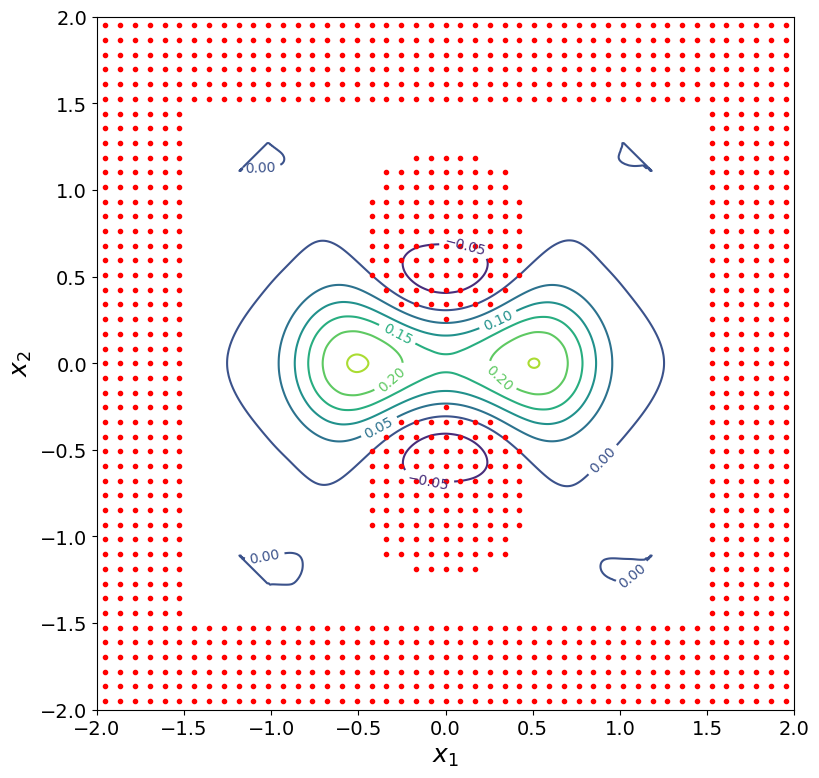

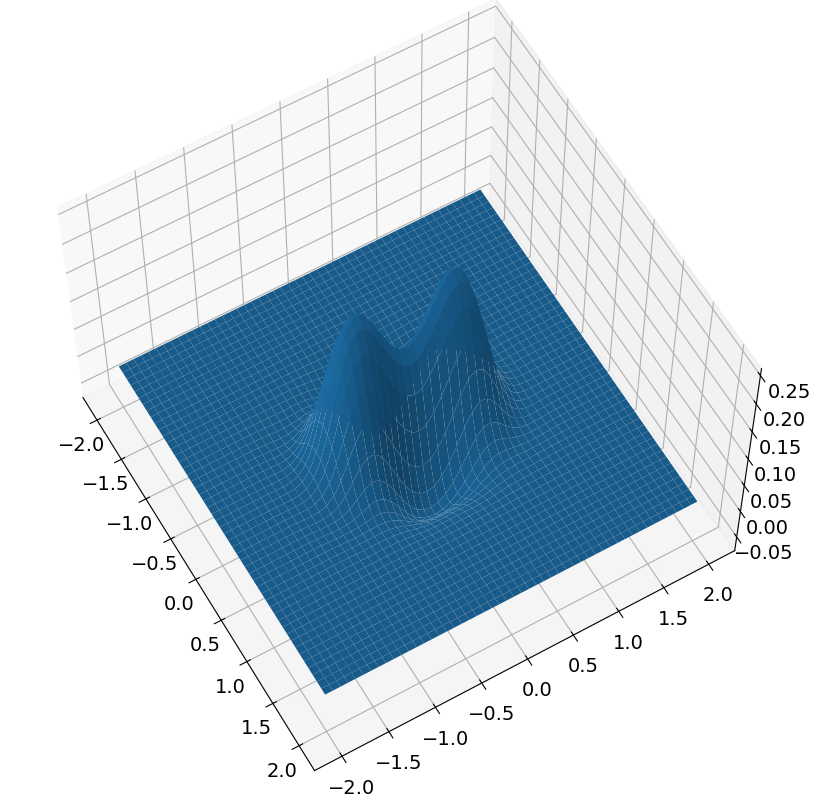

In [8]:
########################
### Plot Initial CBF ###
########################

#start = timer()
plot_cbf(a, np.array(a.centers), np.array(a.thetas), obstacles=obstacles)
#elapsed_time = timer() - start
#print("time:", elapsed_time)

In [9]:
##################################
### Configure Safe Exploration ###
##################################

tol  = 0.05 # h-value at which to halt approac
dx   = 0.2 # if |x'-x|<dx, approach again
tend = 50  # Duration of boundary approach
T    = 3   # MPC horizon (default timestep is 0.05)
N    = 30  # number of CBFs to learn

target: [-1.46460605  1.90795852]
target in goto [-1.46460605  1.90795852]
position is [0 0]
h is 0.15710648135206404
start time is 0


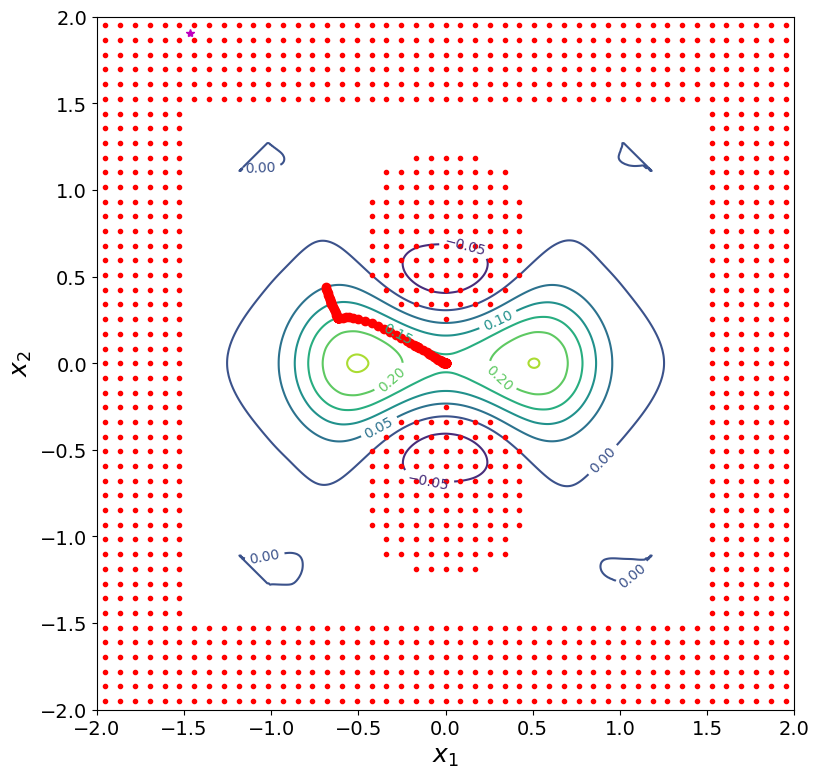

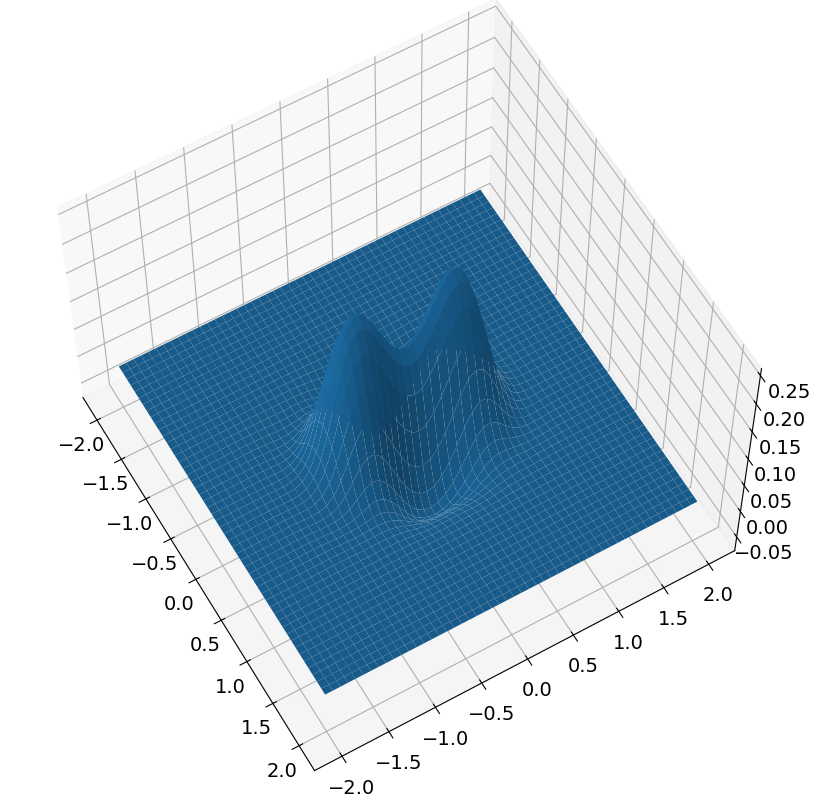

new position is [-0.68740668  0.43921615]
h is now 0.05000000000000002
new time is 50
dx: 0.8157443078593025


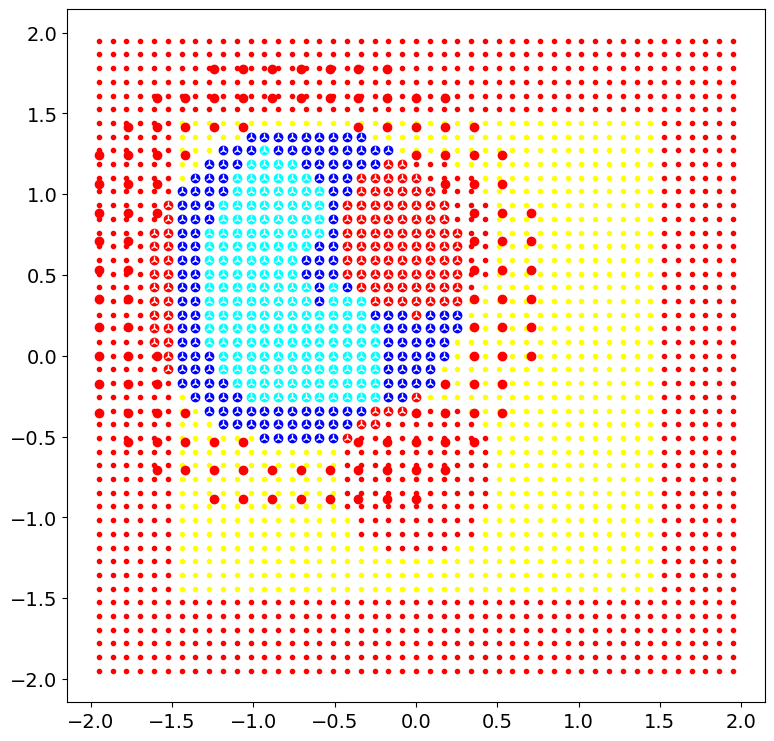

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          432     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.29659D+05    |proj g|=  1.08973D+02


 This problem is unconstrained.



At iterate   50    f=  8.34904D+02    |proj g|=  1.31949D+00

At iterate  100    f=  8.34677D+02    |proj g|=  2.28182D+00

At iterate  150    f=  8.34656D+02    |proj g|=  1.06759D+00

At iterate  200    f=  8.34648D+02    |proj g|=  8.43523D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  432    240    365      1     0     0   1.181D+00   8.346D+02
  F =   834.63966151195939     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(437, 2)
(432, 2)
numc 432
cmax before 437
numc <= self.cmax
Cnew shape before (432, 2)
Cnew shape after (432, 2)
theta shape before (432,)
theta_shape a

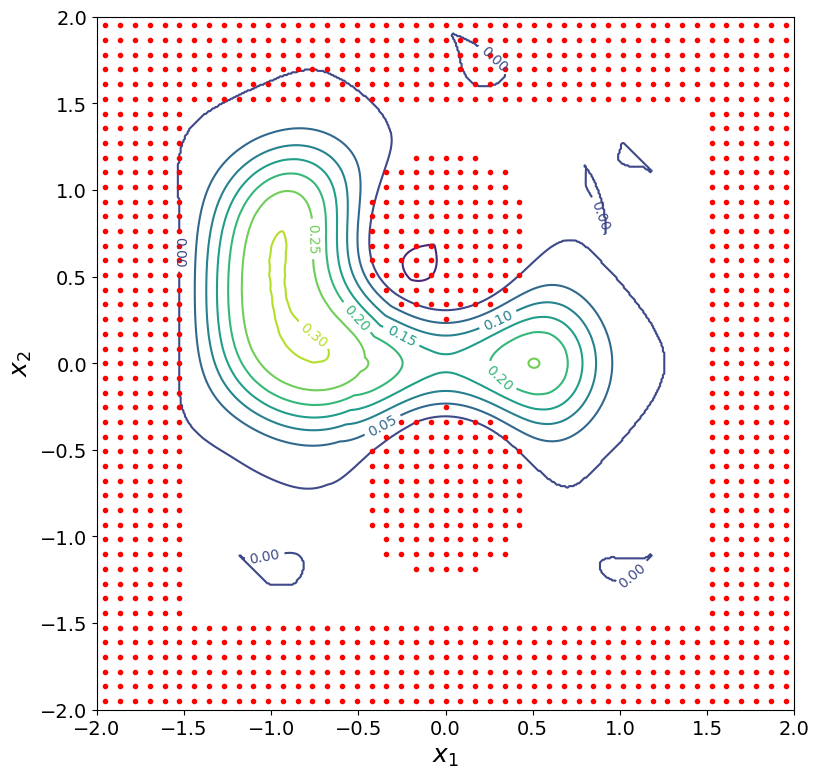

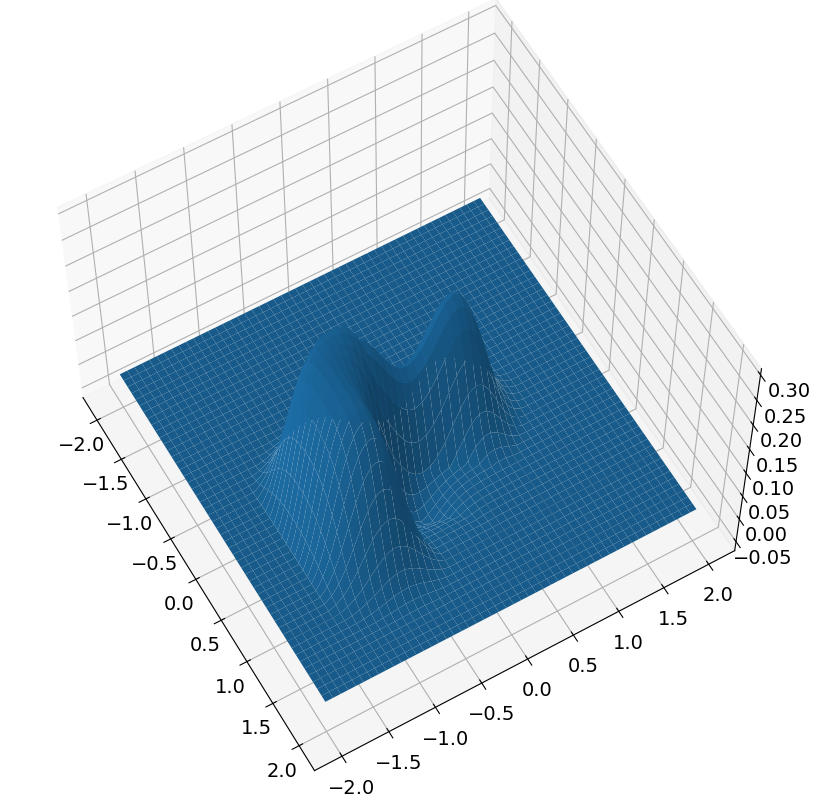

target: [0.92396033 1.58991301]
target in goto [0.92396033 1.58991301]
position is [-0.68740668  0.43921615]
h is 0.22928798245563747
start time is 50


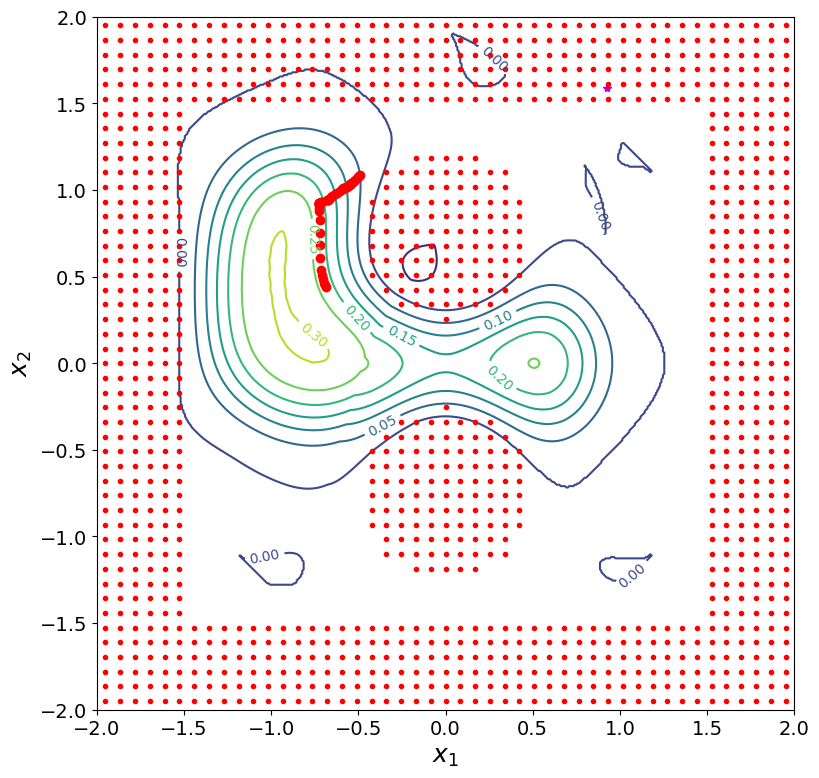

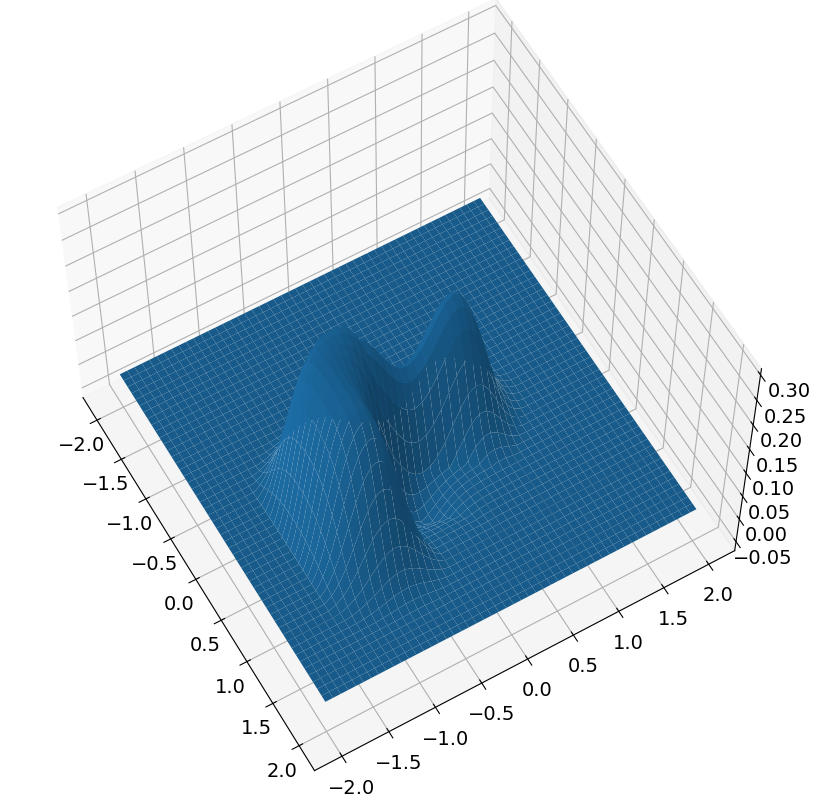

new position is [-0.49068702  1.08543344]
h is now 0.04999999999999996
new time is 100
dx: 0.6754964138092888


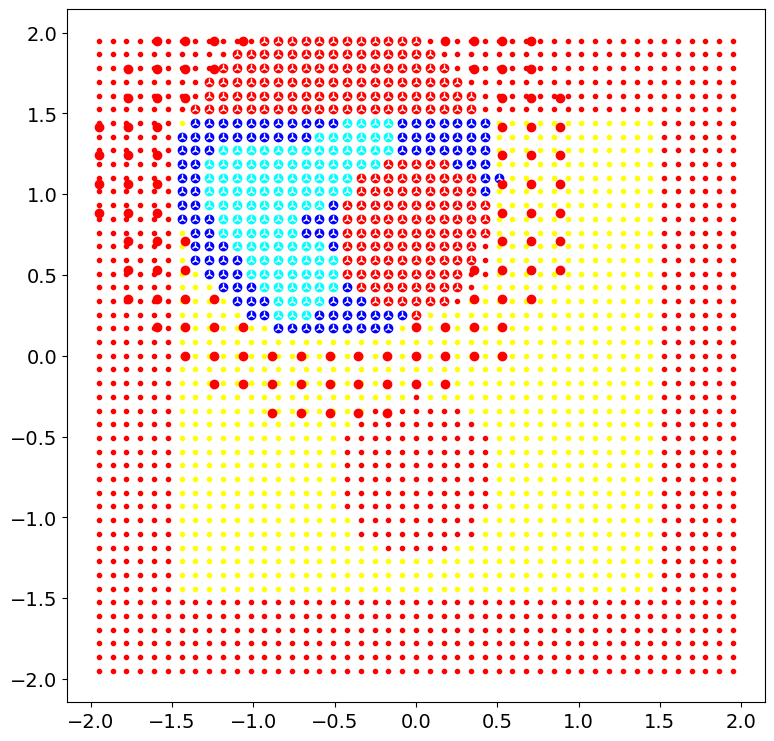

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          427     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.04265D+05    |proj g|=  1.05729D+02


 This problem is unconstrained.



At iterate   50    f=  6.76453D+02    |proj g|=  9.33520D-01

At iterate  100    f=  6.76334D+02    |proj g|=  1.23605D+00

At iterate  150    f=  6.76304D+02    |proj g|=  9.24043D-01

At iterate  200    f=  6.76280D+02    |proj g|=  8.77083D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  427    237    342      1     0     0   1.395D+00   6.763D+02
  F =   676.27376754504598     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(437, 2)
(437, 2)
(427, 2)
numc 427
cmax before 437
numc <= self.cmax
Cnew shape before (427, 2)
Cnew shape after (427, 2)
theta shape before (427,)
thet

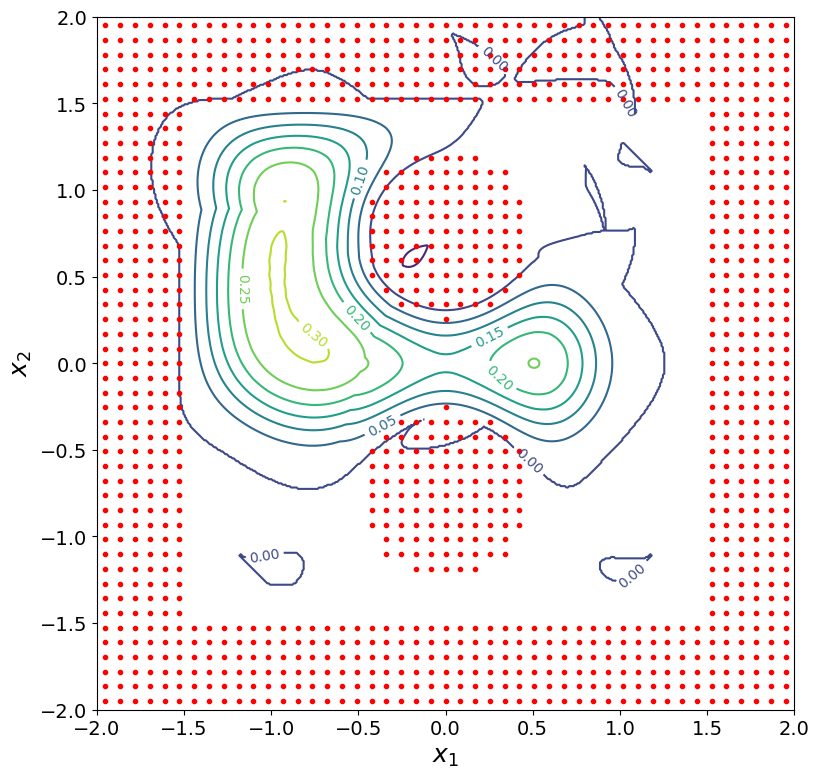

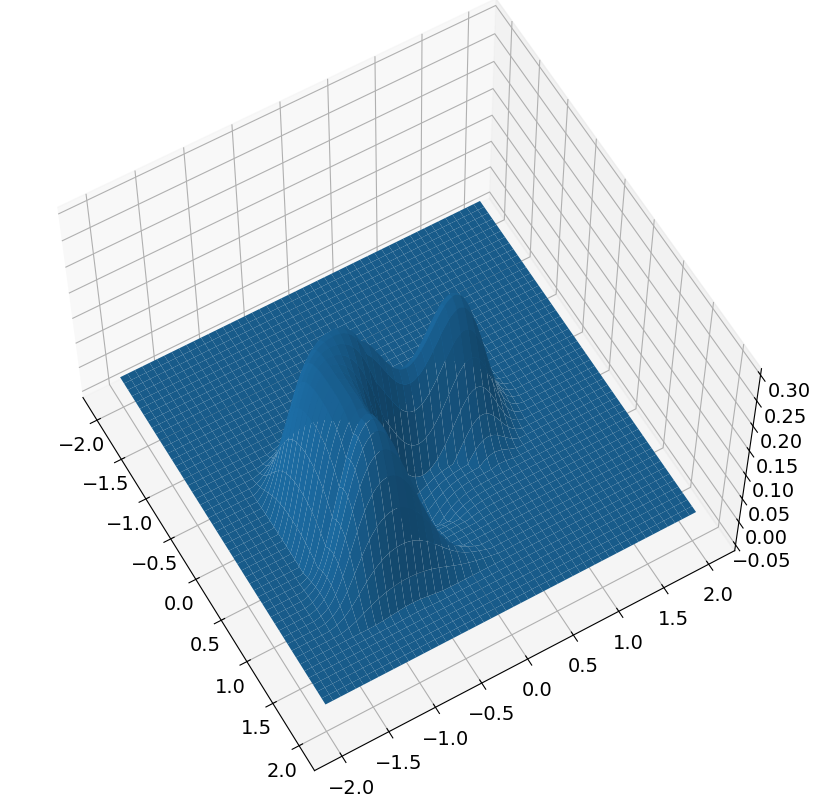

target: [ 0.68592783 -1.68830646]
target in goto [ 0.68592783 -1.68830646]
position is [-0.49068702  1.08543344]
h is 0.1079706598473109
start time is 100


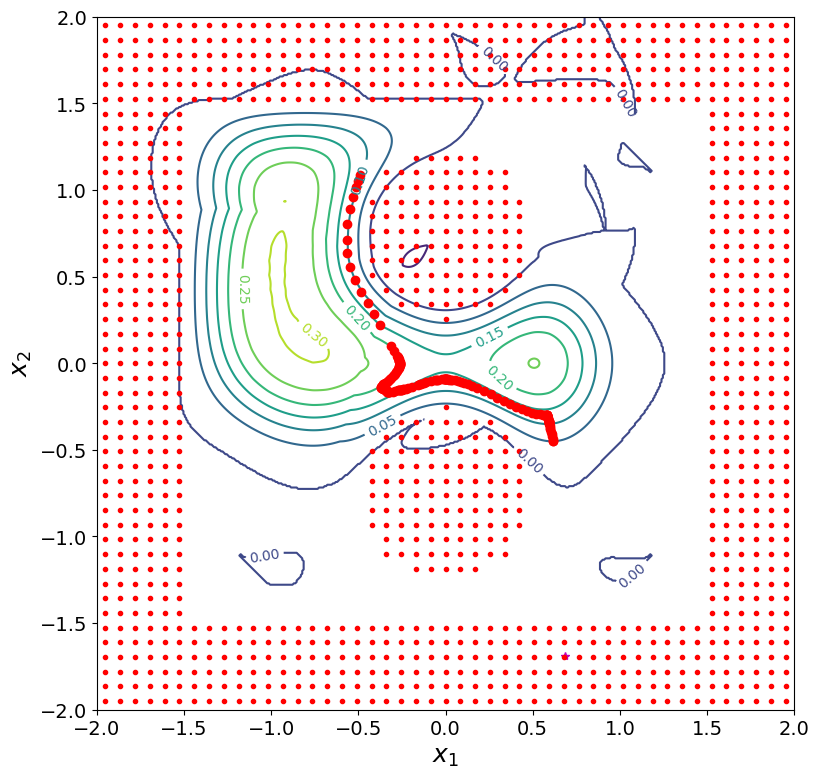

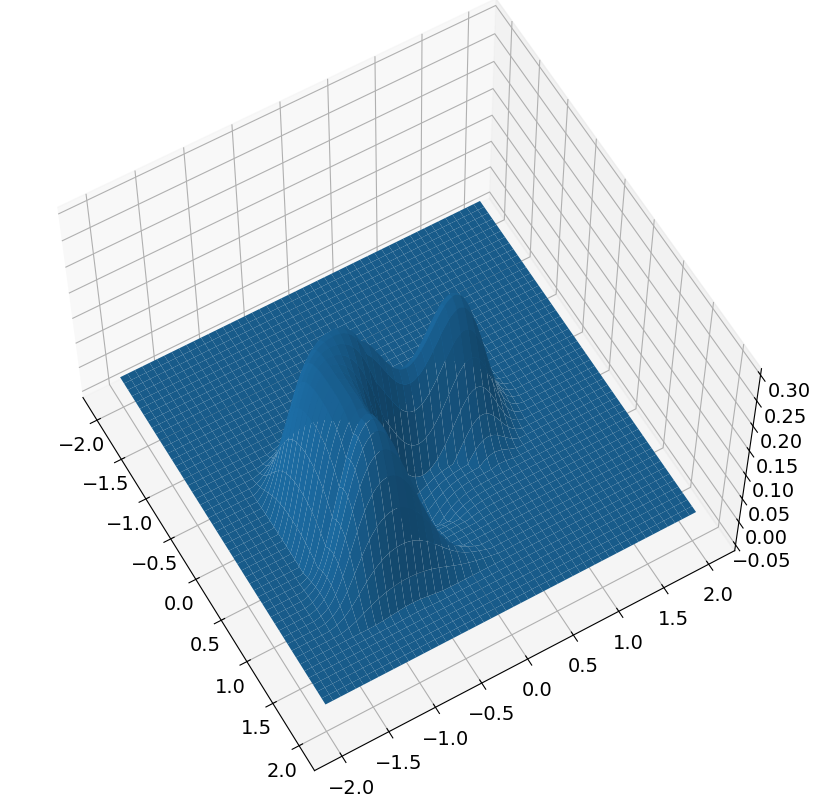

new position is [ 0.61878374 -0.45048845]
h is now 0.05000000000000002
new time is 150
dx: 1.8947246271997082


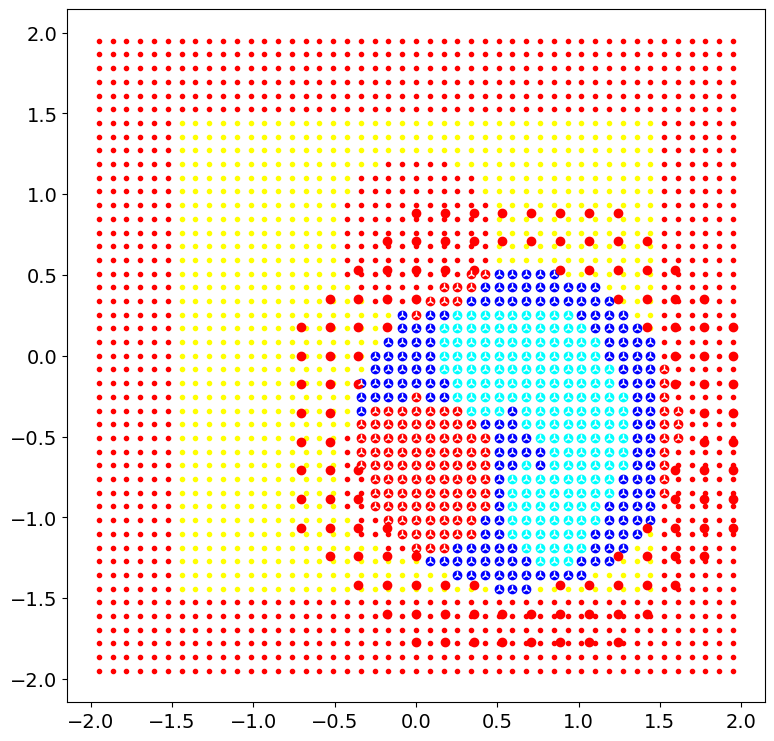

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          441     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.36598D+05    |proj g|=  1.05103D+02


 This problem is unconstrained.



At iterate   50    f=  8.56115D+02    |proj g|=  6.06401D-01

At iterate  100    f=  8.55999D+02    |proj g|=  1.12241D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  441    124    173      1     0     0   9.944D-01   8.560D+02
  F =   855.99795815239804     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(437, 2)
(437, 2)
(437, 2)
(441, 2)
numc 441
cmax before 437
numc > self.cmax
C[i] shape before (437, 2)
C[i] shape after (441, 2)
theta[i] shape before (437,)
theta[i] shape after (441,)
C[i] shape before (437, 2)
C[i] shape after (441, 2)
theta[i] shape before (437,)
theta[i

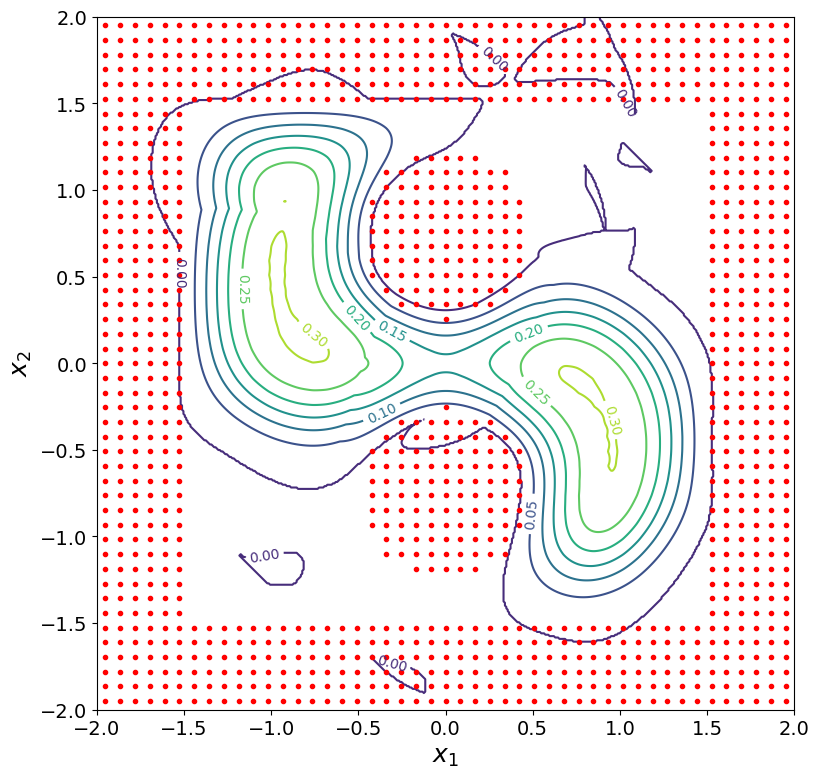

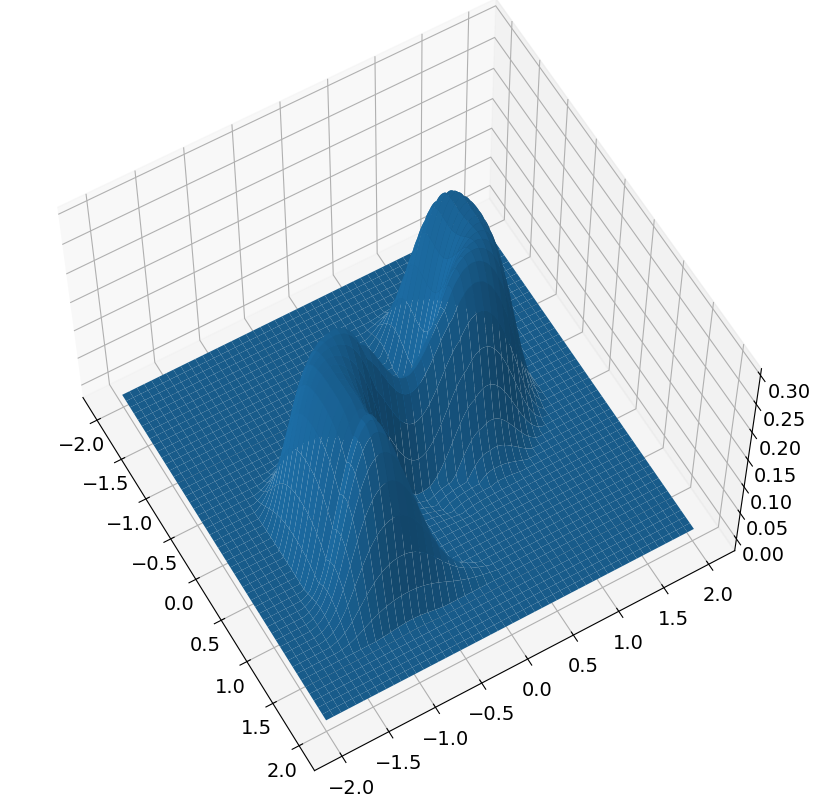

target: [0.27414337 1.89953713]
target in goto [0.27414337 1.89953713]
position is [ 0.61878374 -0.45048845]
h is 0.1785582052919089
start time is 150


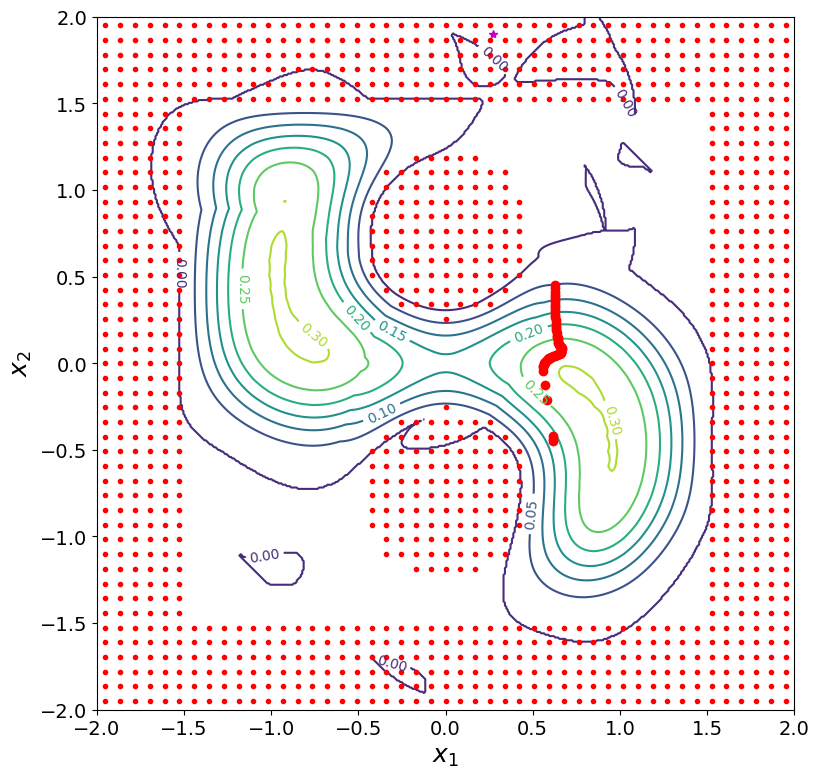

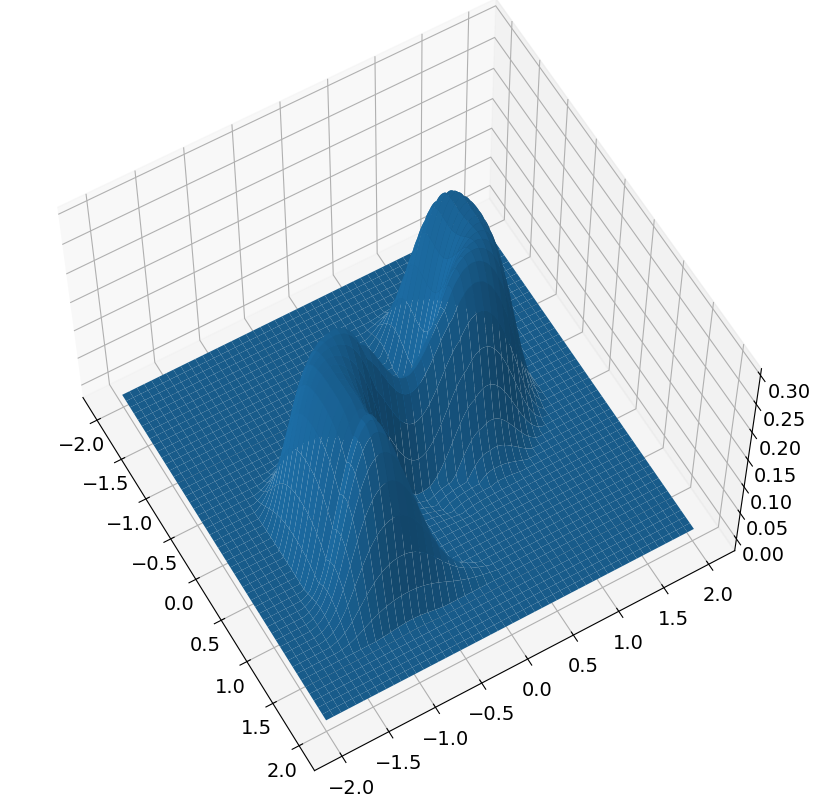

new position is [0.62529039 0.4528438 ]
h is now 0.04999999999999998
new time is 200
dx: 0.9033556827561554


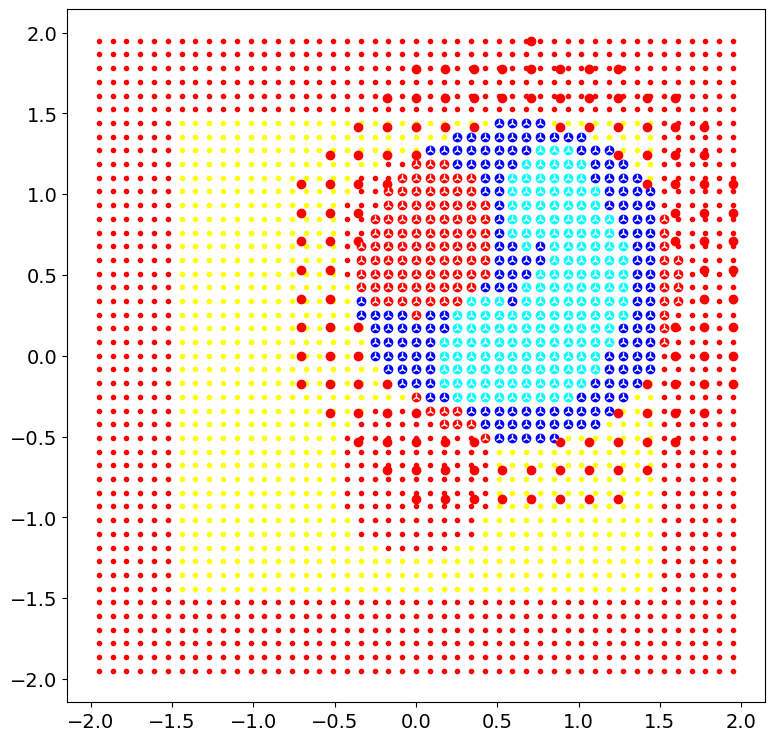

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          439     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.49802D+05    |proj g|=  1.06160D+02


 This problem is unconstrained.



At iterate   50    f=  8.55961D+02    |proj g|=  8.04056D-01

At iterate  100    f=  8.55924D+02    |proj g|=  1.24592D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  439    149    244      1     0     0   1.249D+00   8.559D+02
  F =   855.90146545450057     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(439, 2)
numc 439
cmax before 441
numc <= self.cmax
Cnew shape before (439, 2)
Cnew shape after (439, 2)
theta shape before (439,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)


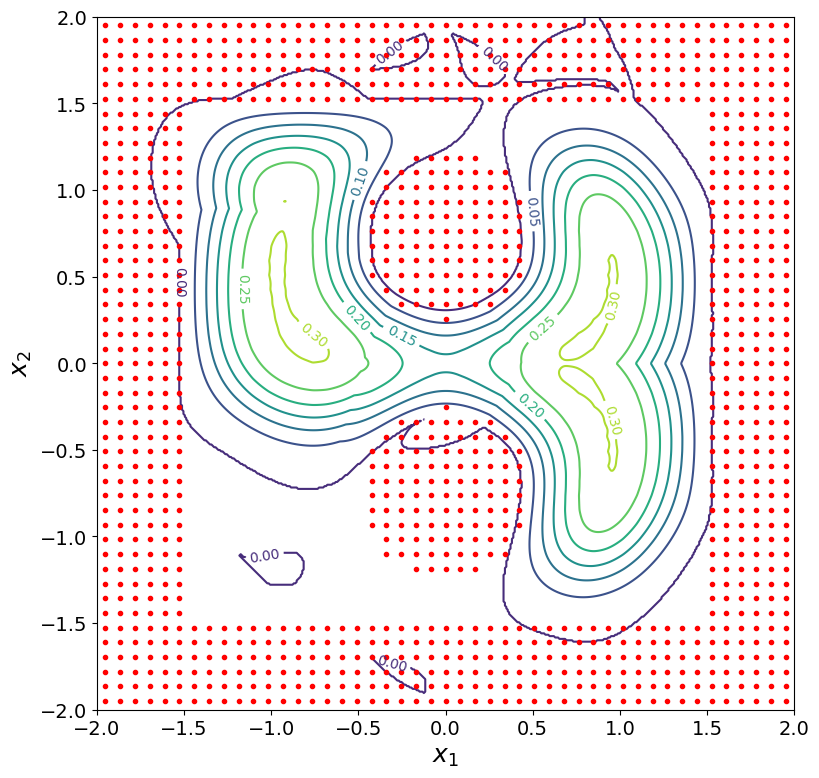

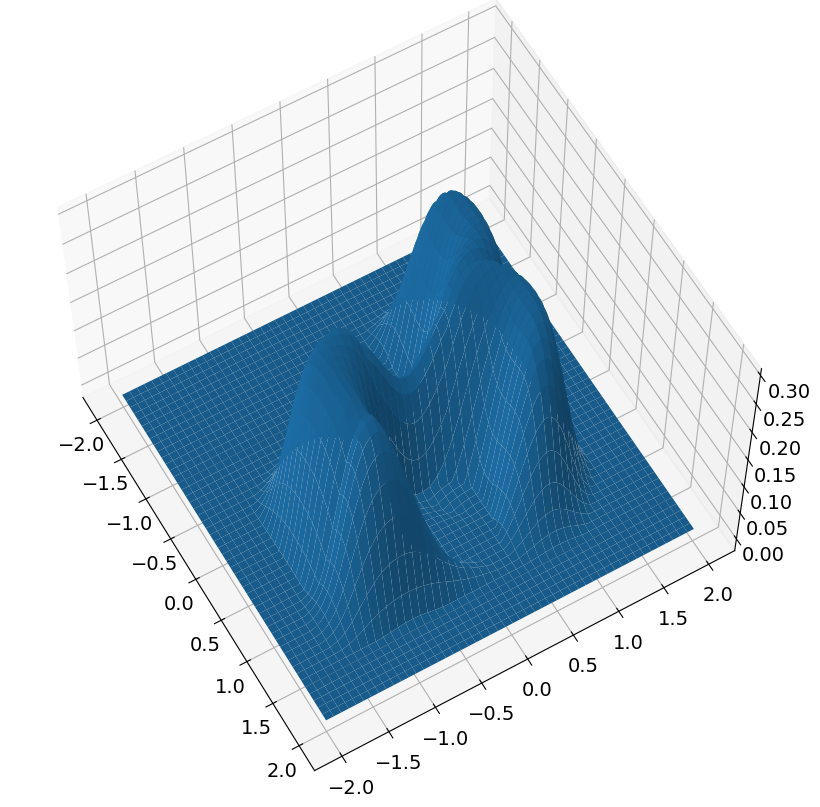

target: [ 1.16536259 -1.87749648]
target in goto [ 1.16536259 -1.87749648]
position is [0.62529039 0.4528438 ]
h is 0.1814976969086181
start time is 200


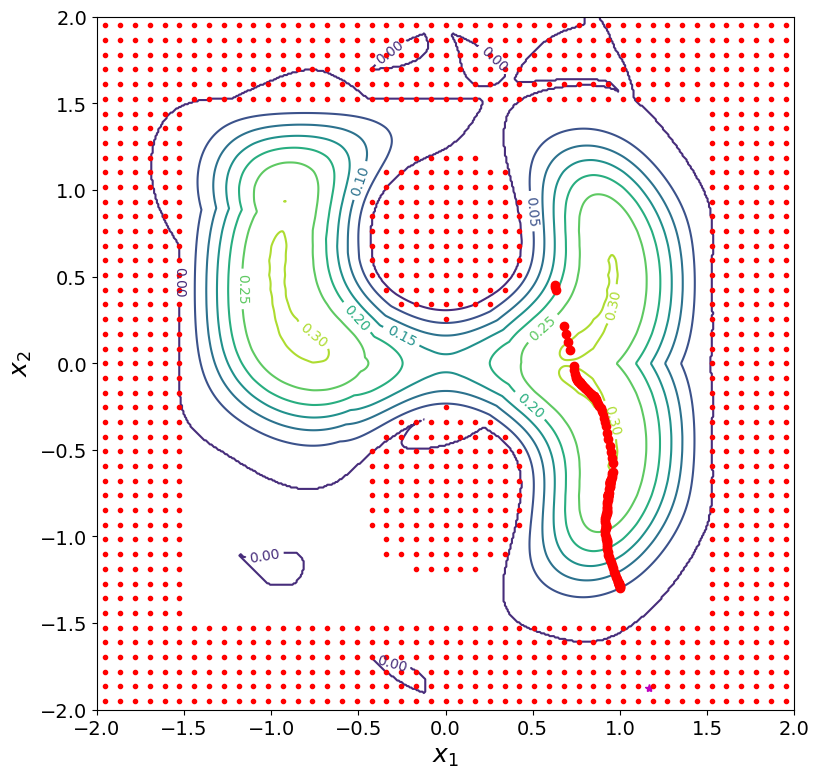

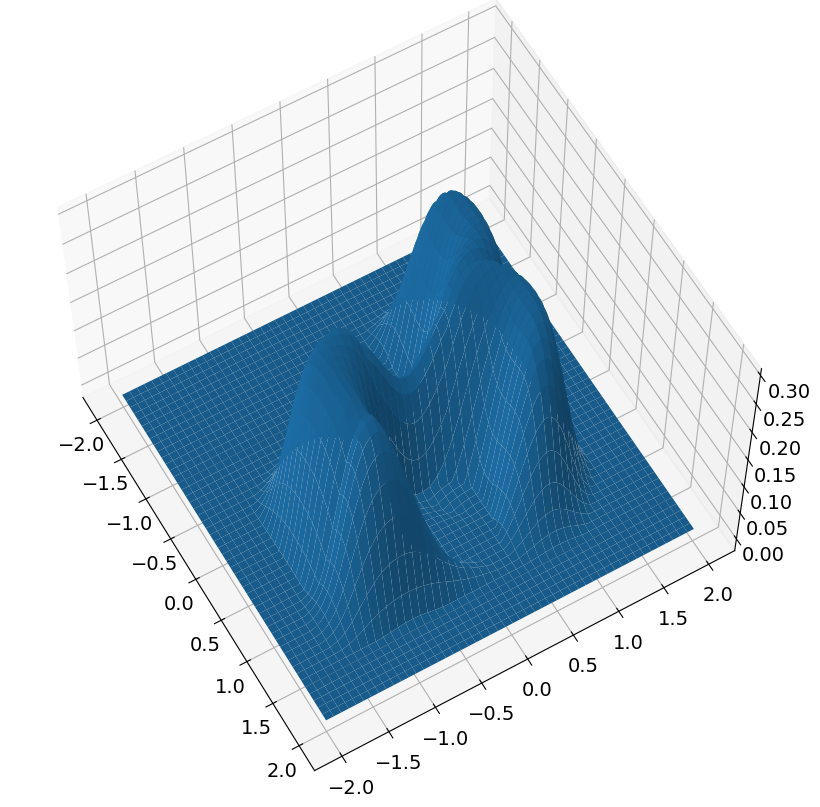

new position is [ 1.0027628  -1.29700237]
h is now 0.04999999999999996
new time is 250
dx: 1.7900969276662444


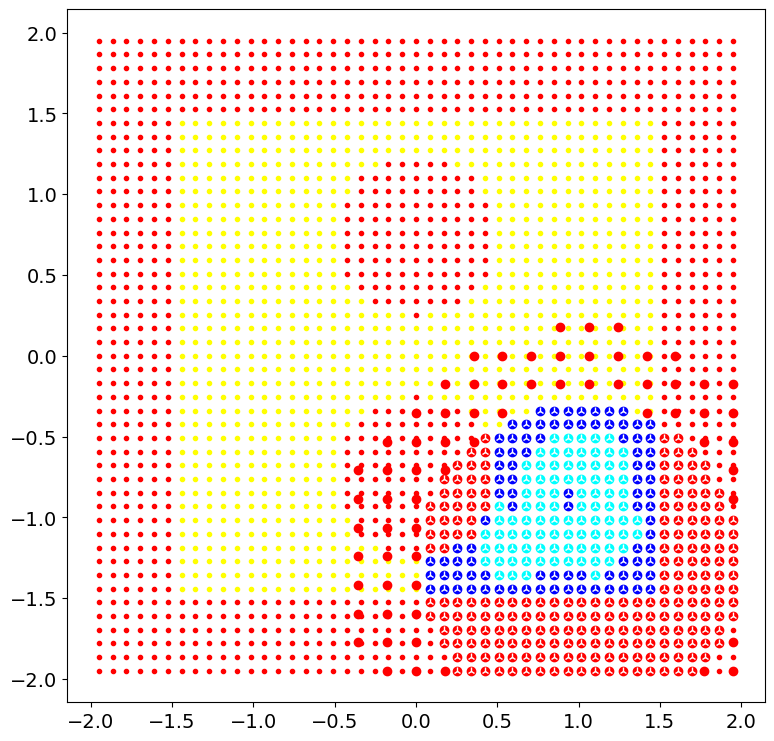

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          395     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.35064D+05    |proj g|=  1.10424D+02

At iterate   50    f=  5.20122D+02    |proj g|=  1.16355D+00

At iterate  100    f=  5.19874D+02    |proj g|=  1.35139D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  395    122    179      1     0     0   9.024D-01   5.199D+02
  F =   519.86982195687904     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(39

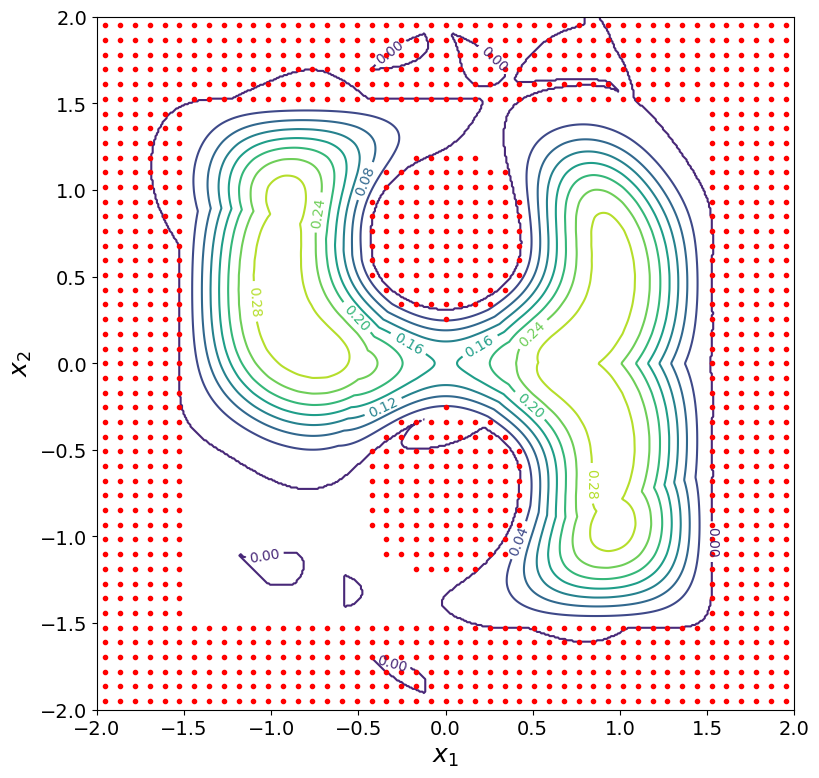

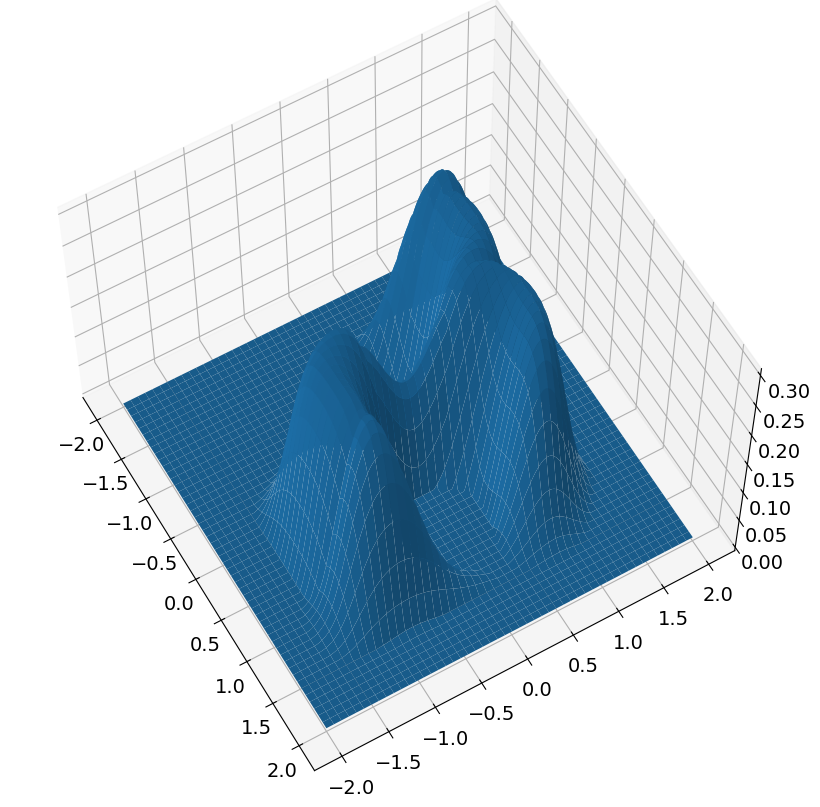

target: [ 1.55647612 -1.36404156]
target in goto [ 1.55647612 -1.36404156]
position is [ 1.0027628  -1.29700237]
h is 0.15678644509397527
start time is 250


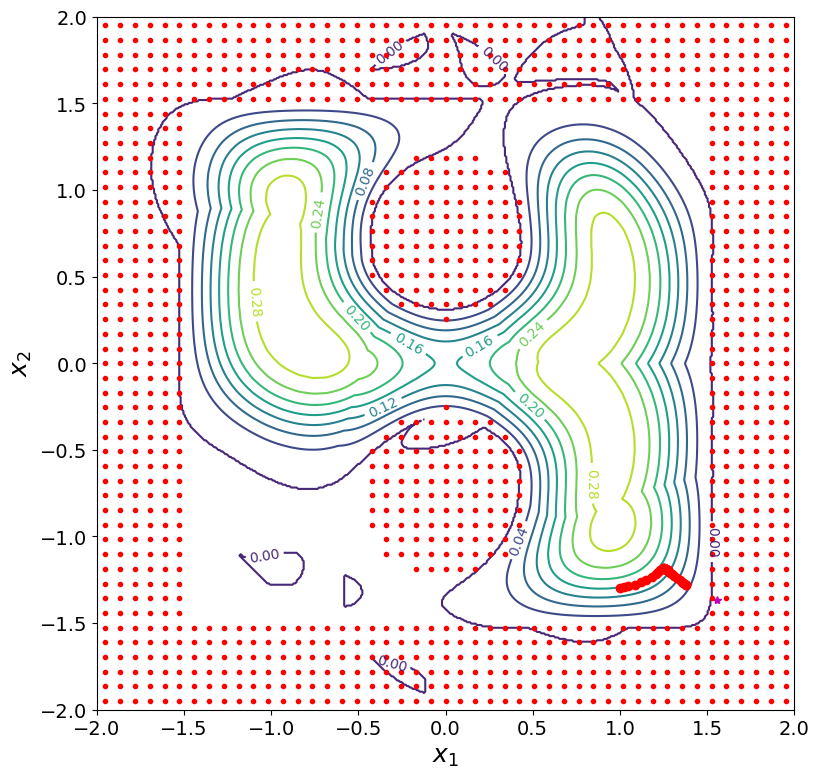

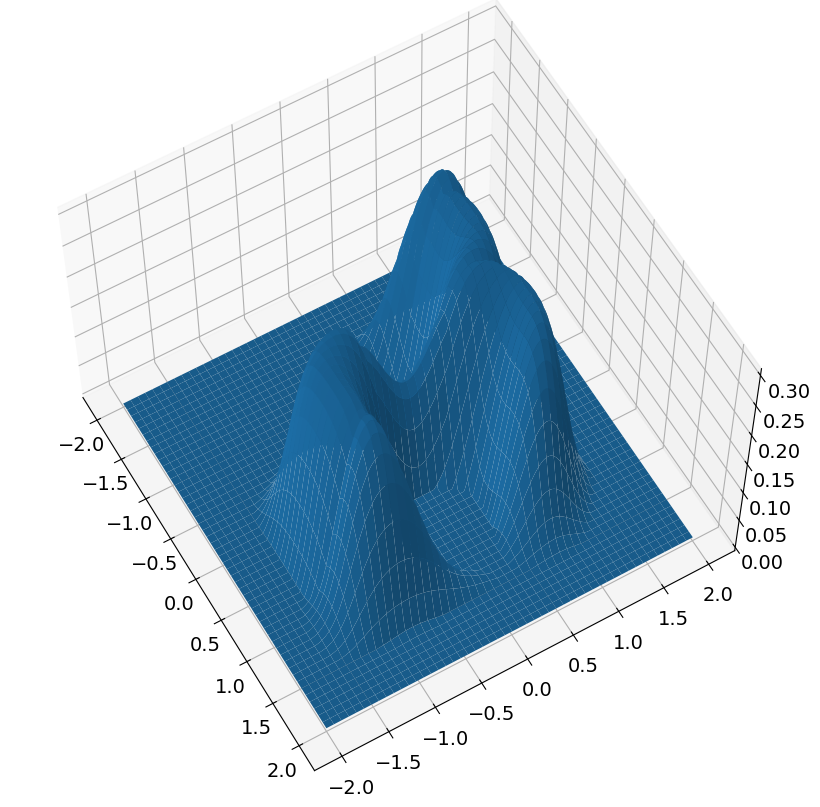

new position is [ 1.3800892  -1.28047661]
h is now 0.050000000000000024
new time is 300
dx: 0.37768811285382503


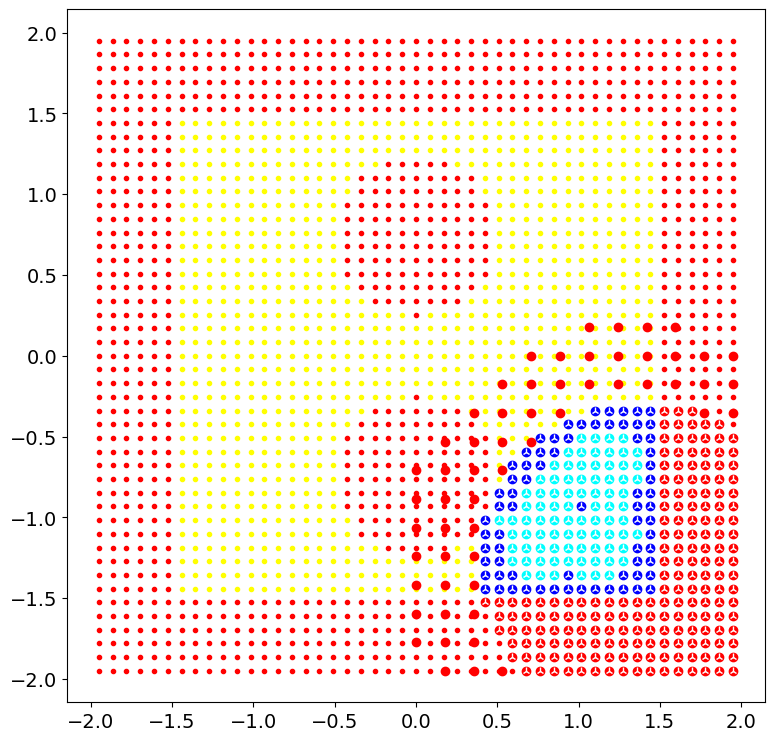

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          340     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.19002D+05    |proj g|=  1.09943D+02


 This problem is unconstrained.



At iterate   50    f=  4.89393D+02    |proj g|=  1.16391D+00

At iterate  100    f=  4.89294D+02    |proj g|=  5.71490D-01

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(340, 2)
numc 340
cmax before 441
numc <= self.cmax
Cnew shape before (340, 2)
Cnew shape after (340, 2)
theta shape before (340,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  340    126    209      1     0     0   7.286D-01   4.893D+02
  F =   489.28953289427307     

CONVERGENCE: REL_REDUCTION_OF_

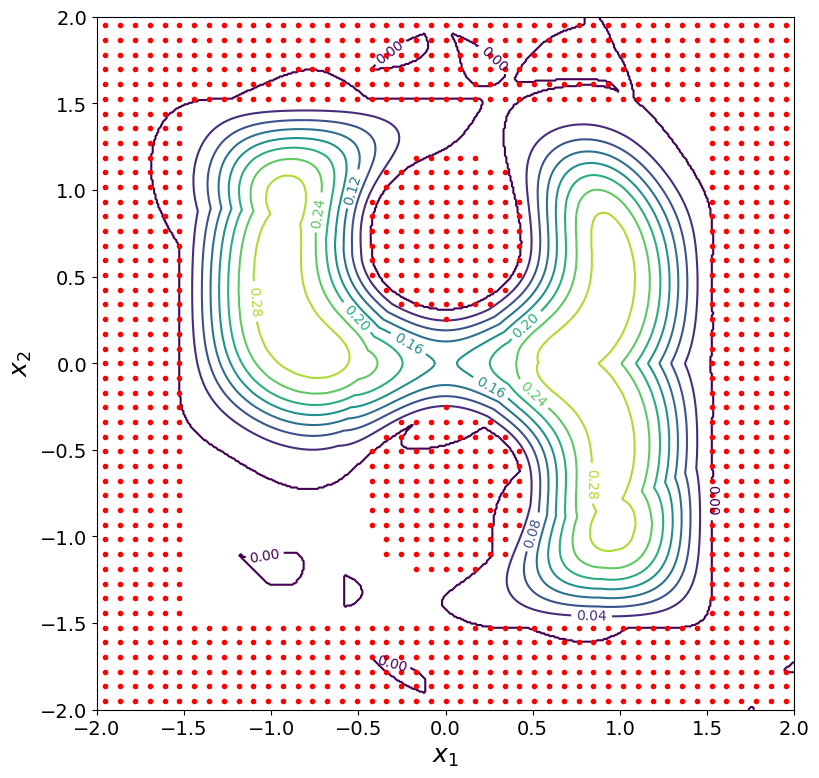

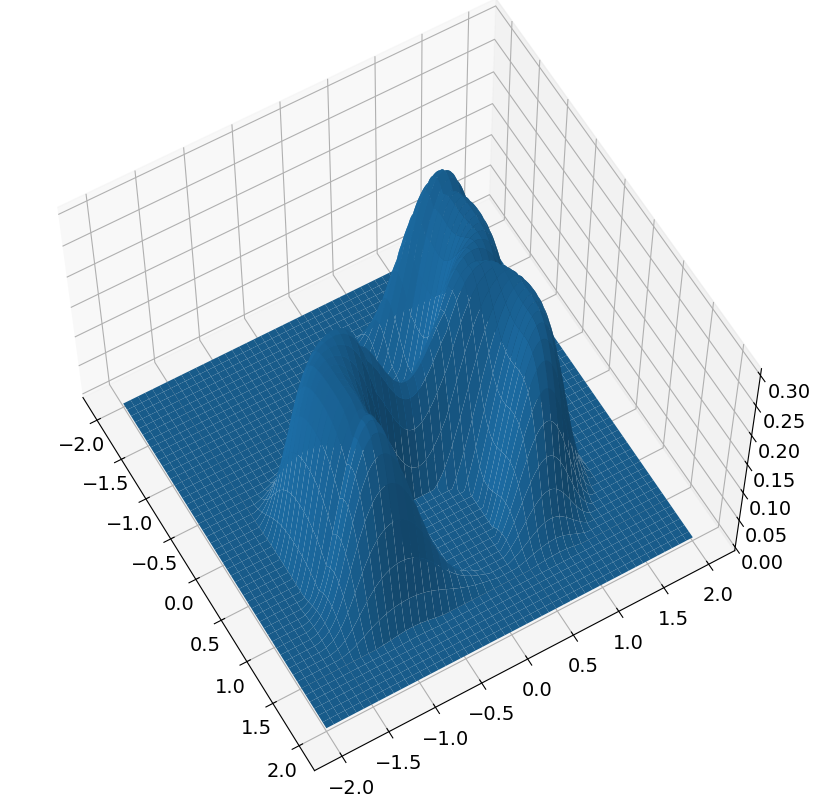

target: [-1.71973692  0.8464576 ]
target in goto [-1.71973692  0.8464576 ]
position is [ 1.3800892  -1.28047661]
h is 0.05415838464055121
start time is 300


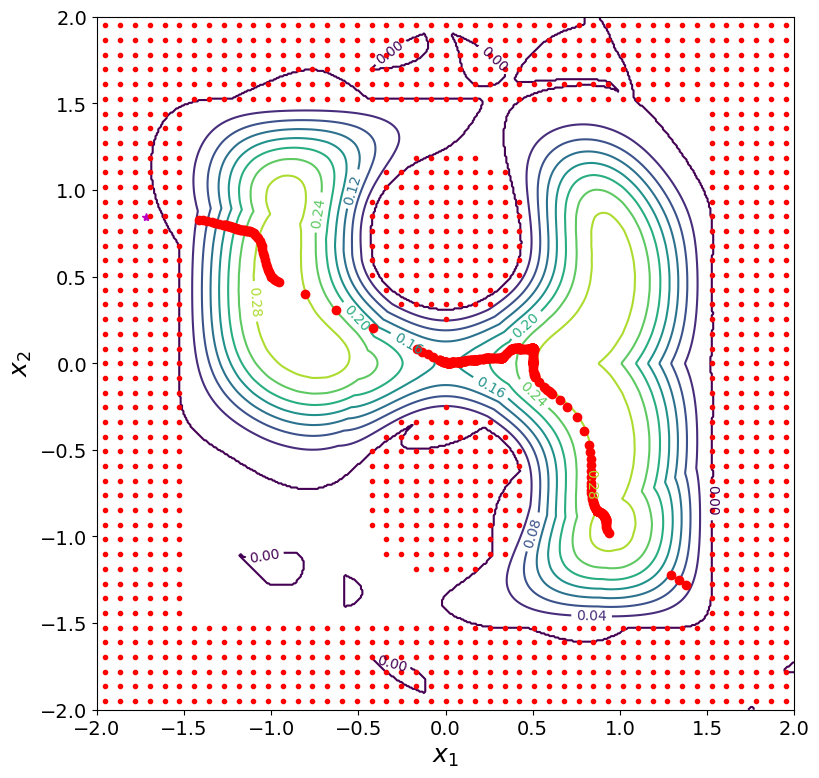

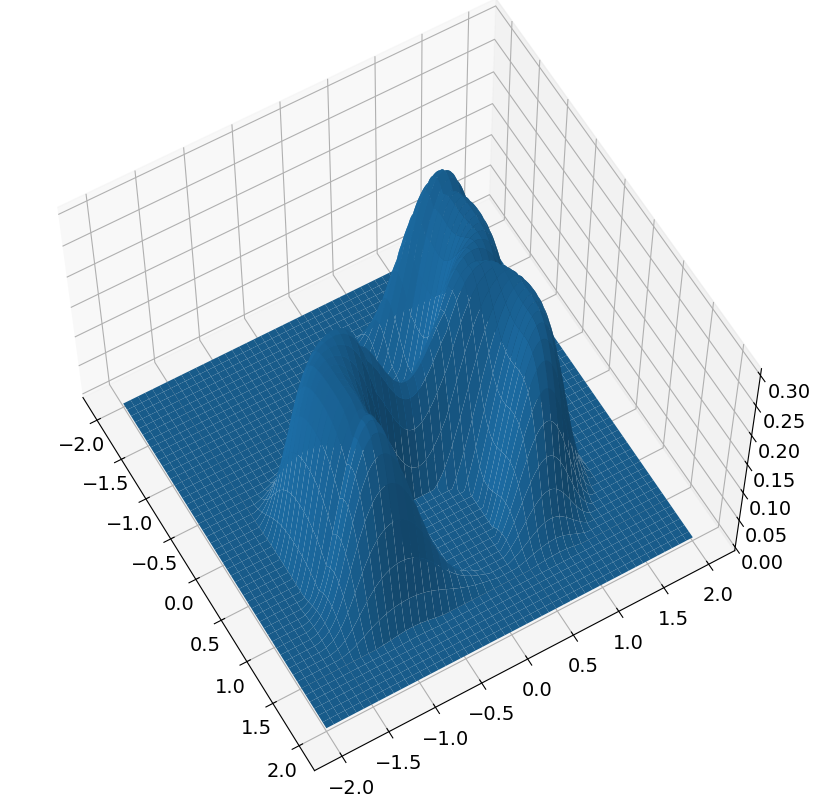

new position is [-1.41103431  0.82895744]
h is now 0.05000000000000003
new time is 350
dx: 3.4985829205769927


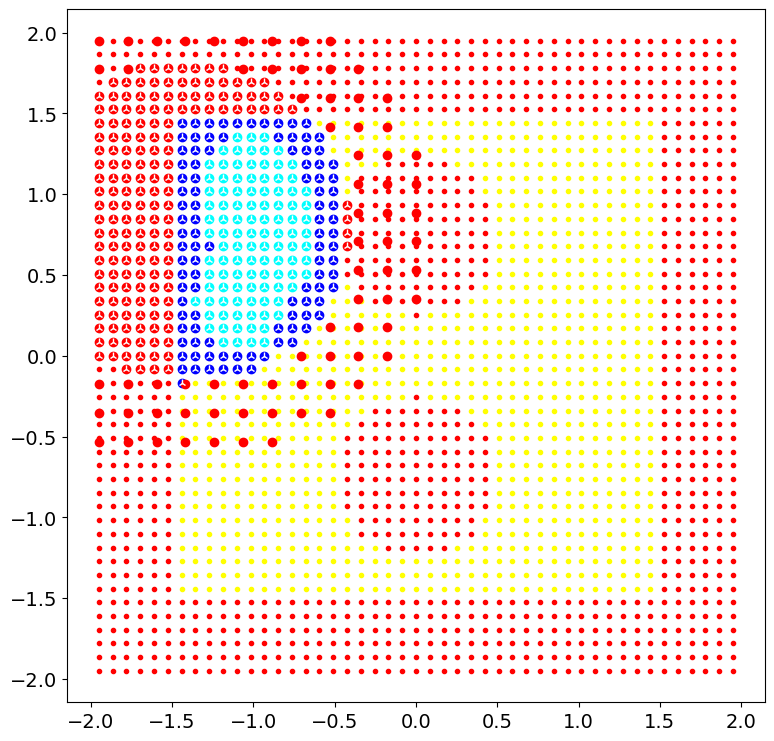

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          371     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.90731D+05    |proj g|=  1.07835D+02


 This problem is unconstrained.



At iterate   50    f=  5.65101D+02    |proj g|=  1.16801D+00

At iterate  100    f=  5.64995D+02    |proj g|=  1.16481D+00

At iterate  150    f=  5.64991D+02    |proj g|=  1.76814D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  371    156    297      1     0     0   7.187D-01   5.650D+02
  F =   564.99039464956491     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(371, 2)
numc 371
cmax before 441
numc <= self.cmax
Cnew shape before (371, 2)
Cnew shape after (371, 2)
theta shape before (371,)
theta_shape after (44

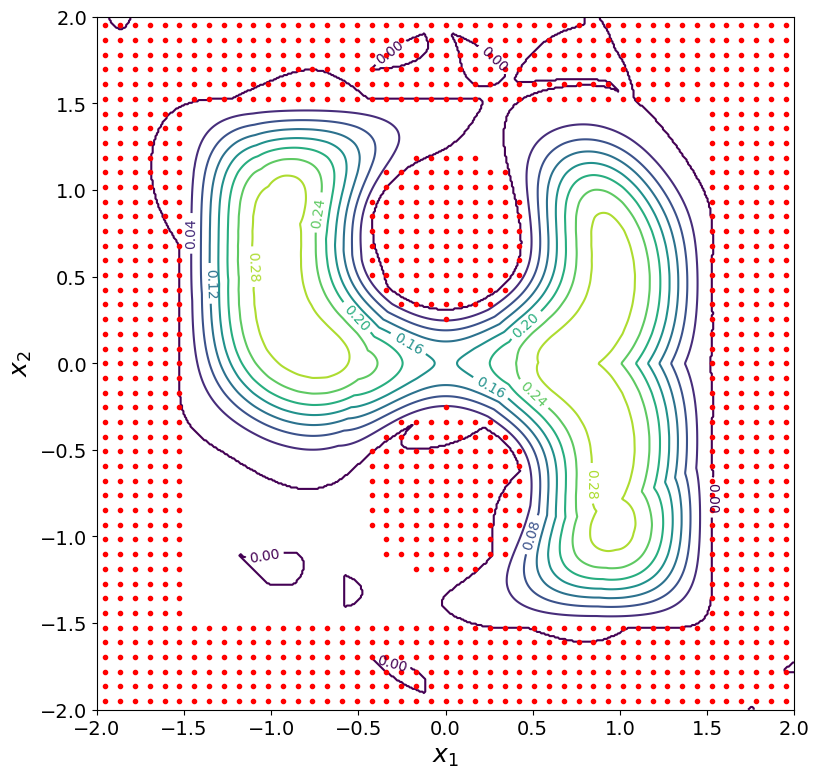

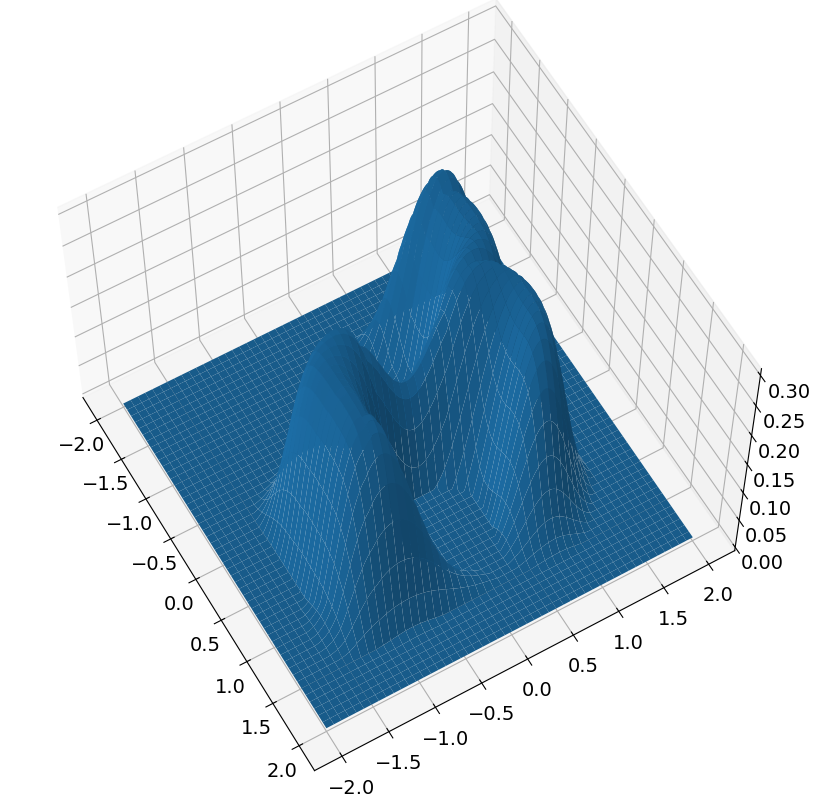

target: [-1.88472673  0.16514402]
target in goto [-1.88472673  0.16514402]
position is [-1.41103431  0.82895744]
h is 0.0724886962227542
start time is 350


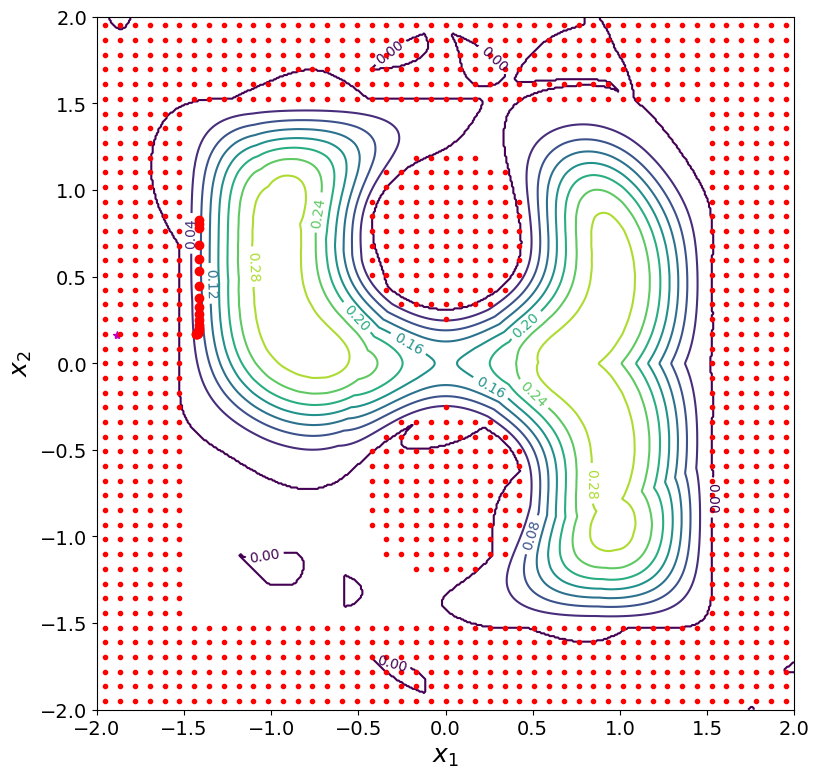

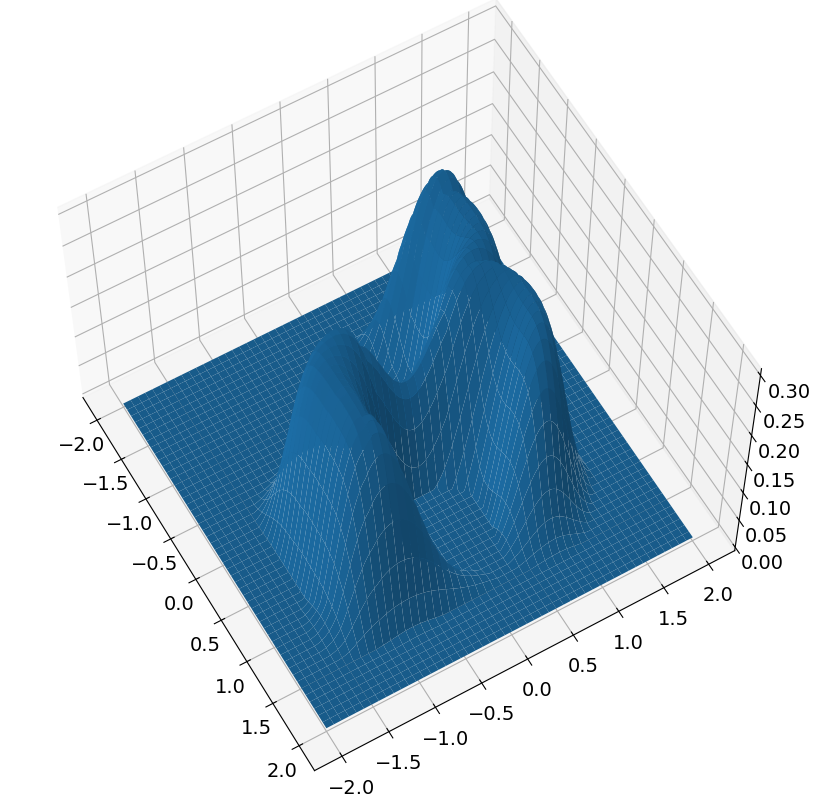

new position is [-1.42938487  0.17004569]
h is now 0.04999999999999995
new time is 400
dx: 0.6591672252946482


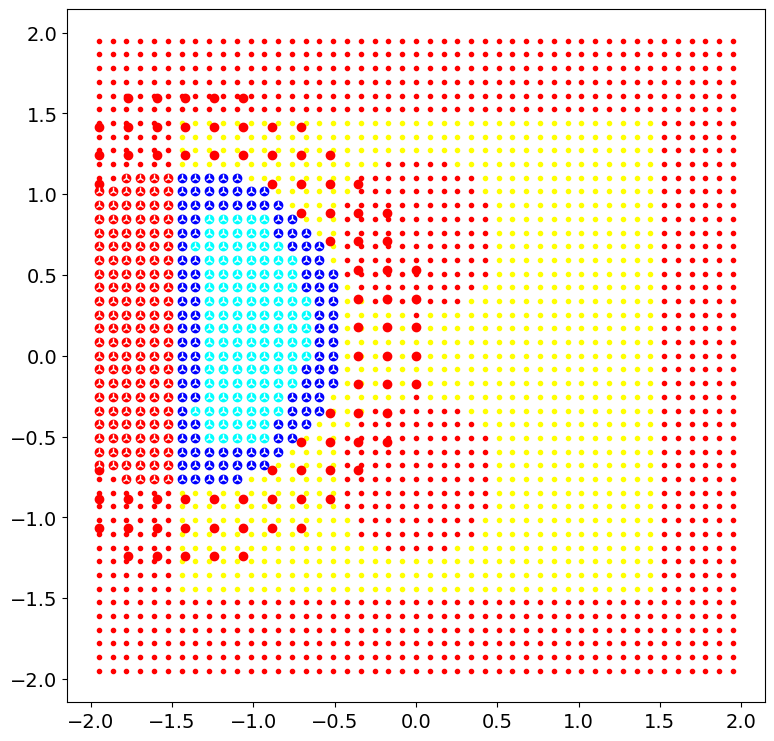

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          364     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.76662D+05    |proj g|=  1.07583D+02


 This problem is unconstrained.



At iterate   50    f=  6.10334D+02    |proj g|=  1.39954D+00

At iterate  100    f=  6.10214D+02    |proj g|=  1.71478D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  364    120    161      1     0     0   1.030D+00   6.102D+02
  F =   610.20500135736688     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(364, 2)
numc 364
cmax before 441
numc <= self.cmax
Cnew shape before (364, 2)
Cnew shape after (364, 2)
theta shape before (364,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441,

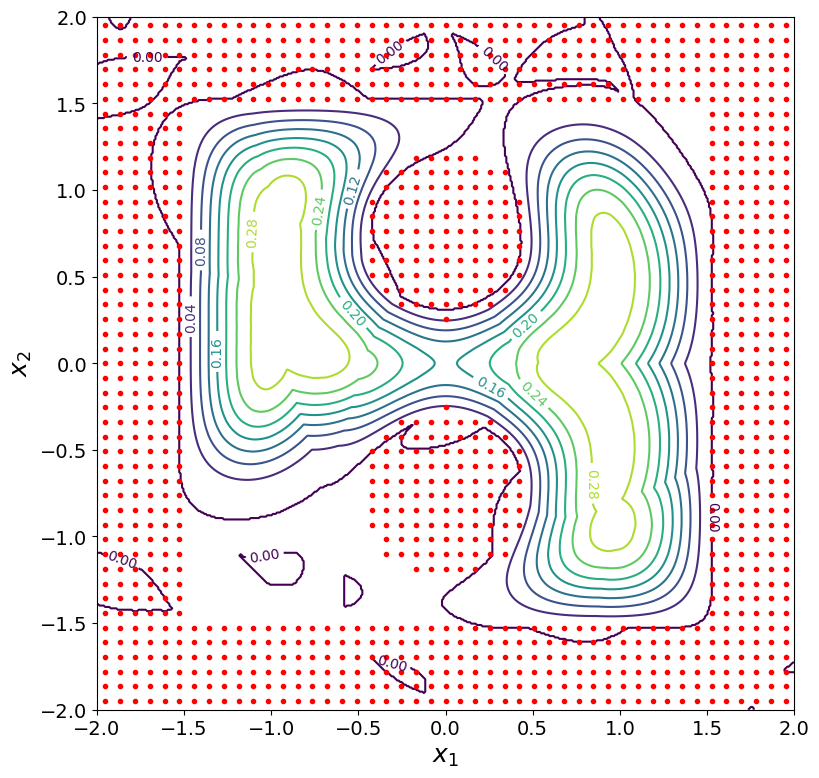

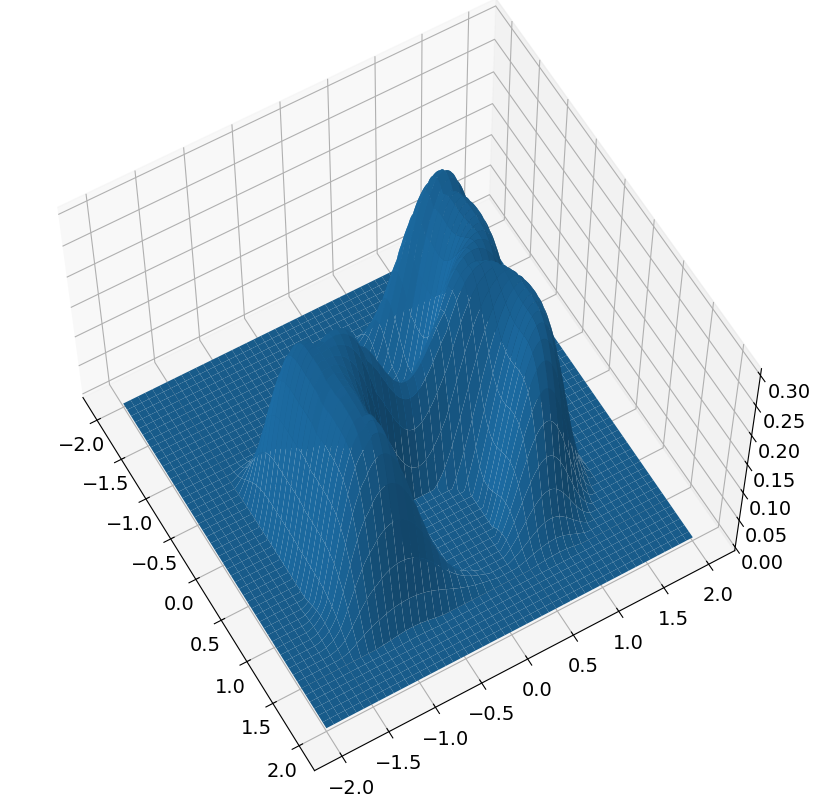

target: [1.88516932 0.28620667]
target in goto [1.88516932 0.28620667]
position is [-1.42938487  0.17004569]
h is 0.06326147254726183
start time is 400


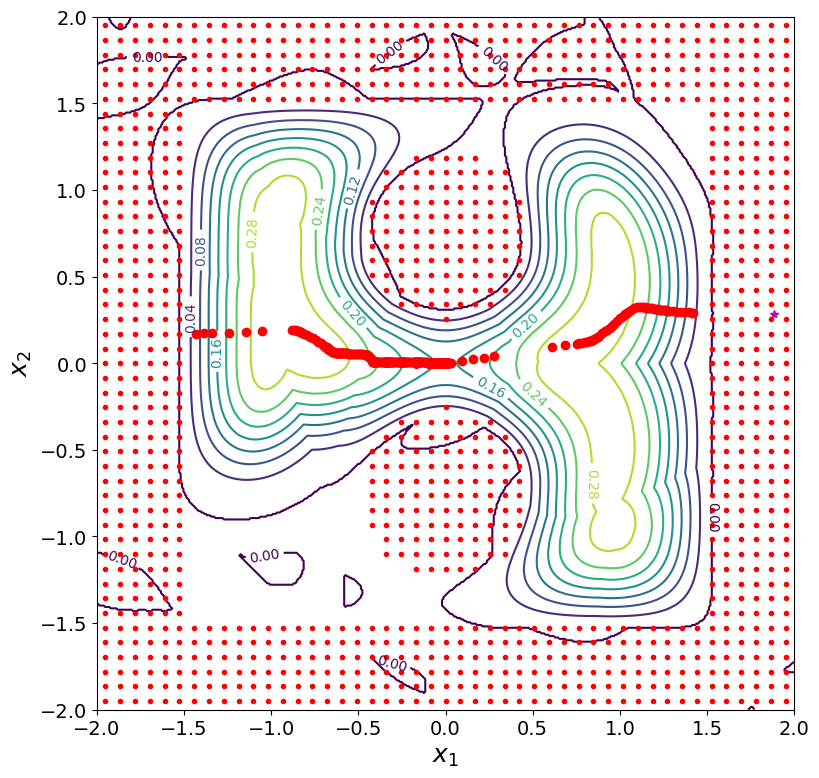

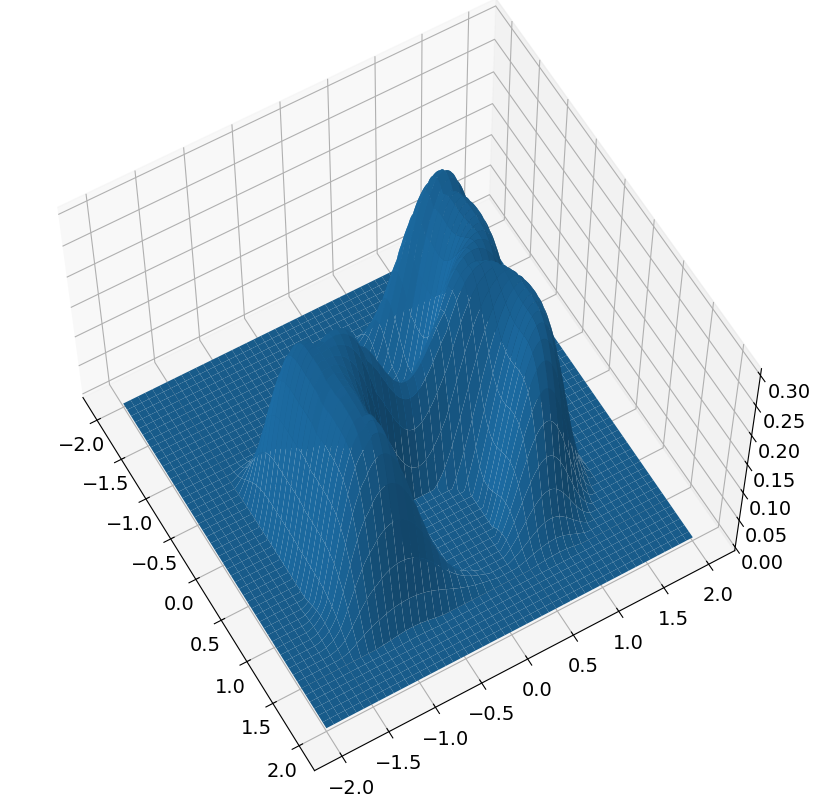

new position is [1.42182739 0.29198513]
h is now 0.04999999999999995
new time is 450
dx: 2.853818593852747


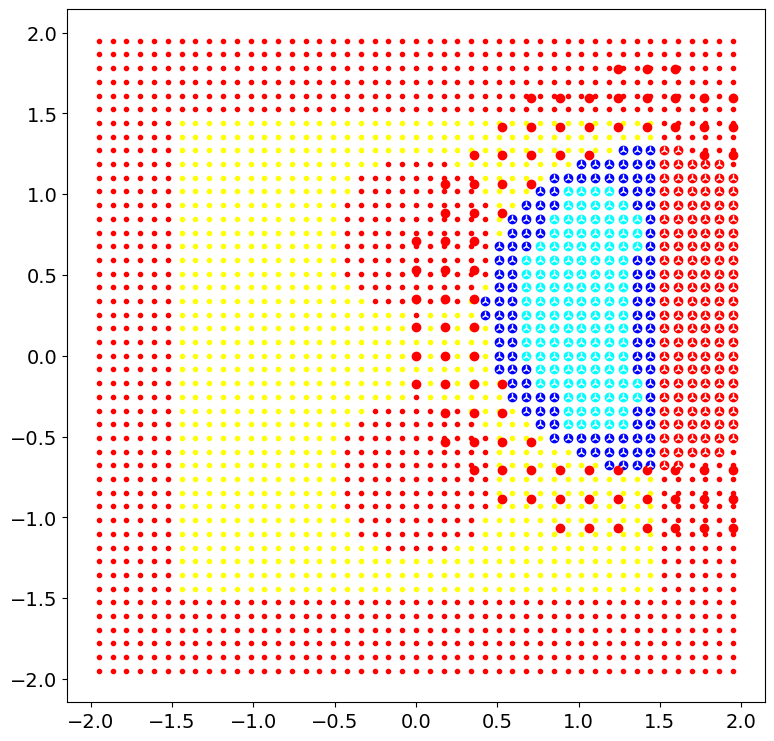

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          373     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.96752D+05    |proj g|=  1.10056D+02


 This problem is unconstrained.



At iterate   50    f=  6.58801D+02    |proj g|=  2.79642D+00

At iterate  100    f=  6.58628D+02    |proj g|=  7.22195D-01

At iterate  150    f=  6.58584D+02    |proj g|=  5.13979D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  373    175    256      1     0     0   1.191D+00   6.586D+02
  F =   658.58172149015650     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(373, 2)
numc 373
cmax before 441
numc <= self.cmax
Cnew shape before (373, 2)
Cnew shape after (373, 2)
theta shape before (373,)
the

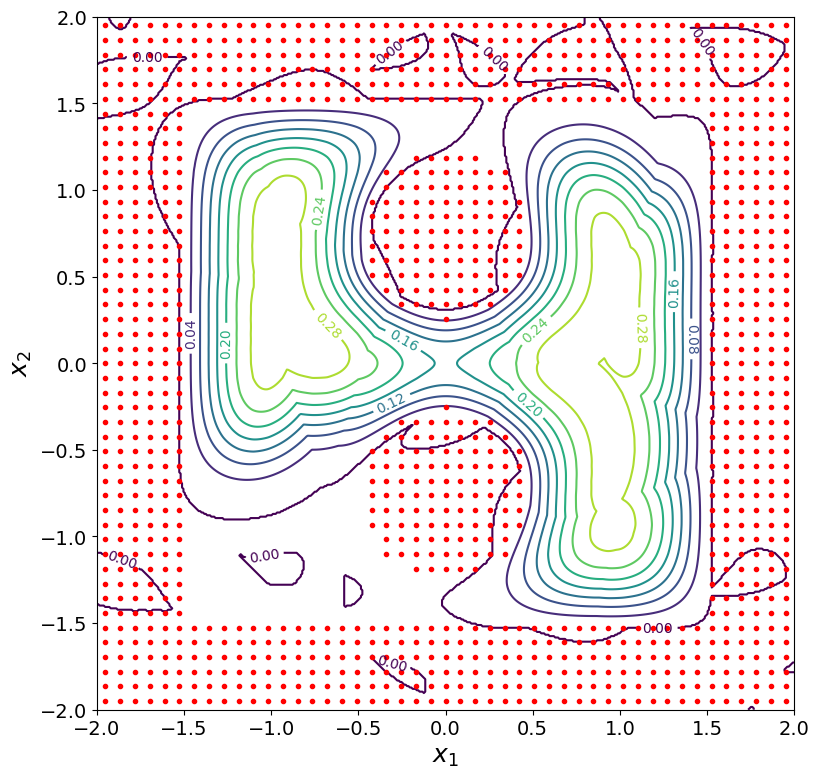

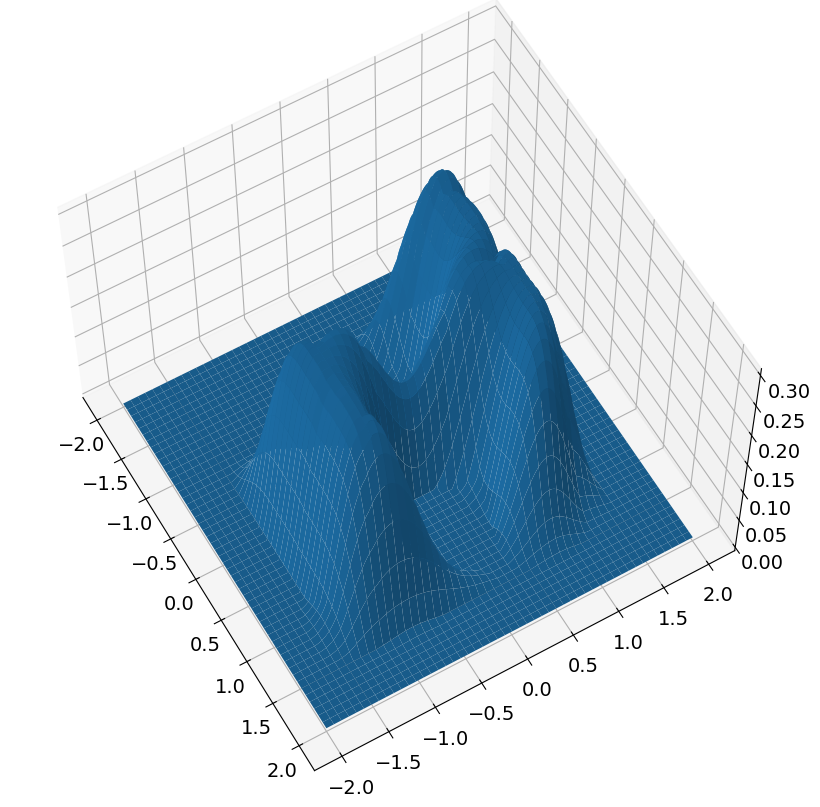

target: [-1.10431235 -1.49141548]
target in goto [-1.10431235 -1.49141548]
position is [1.42182739 0.29198513]
h is 0.070034301911093
start time is 450


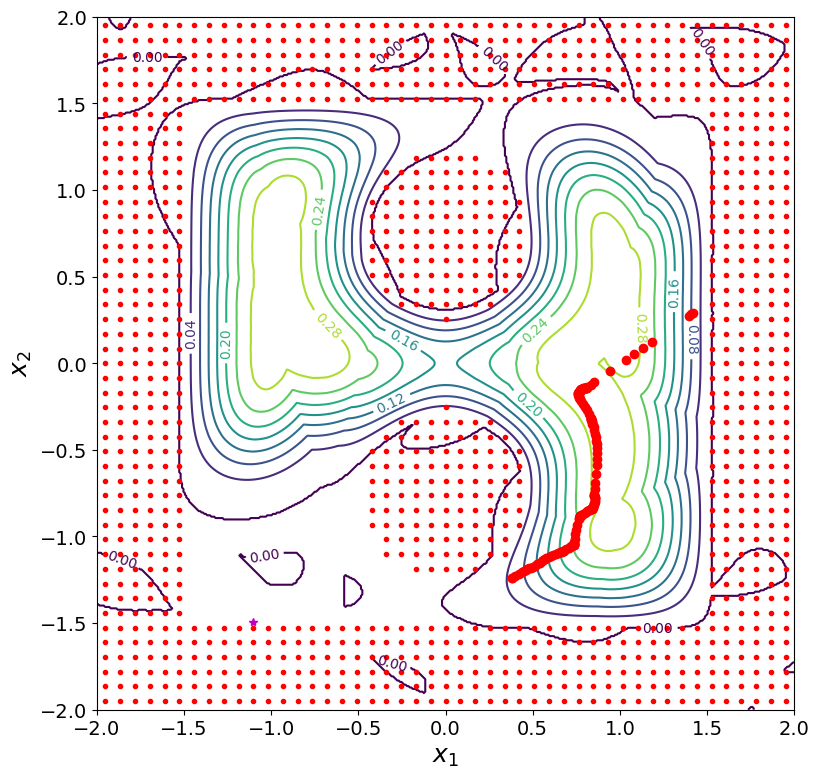

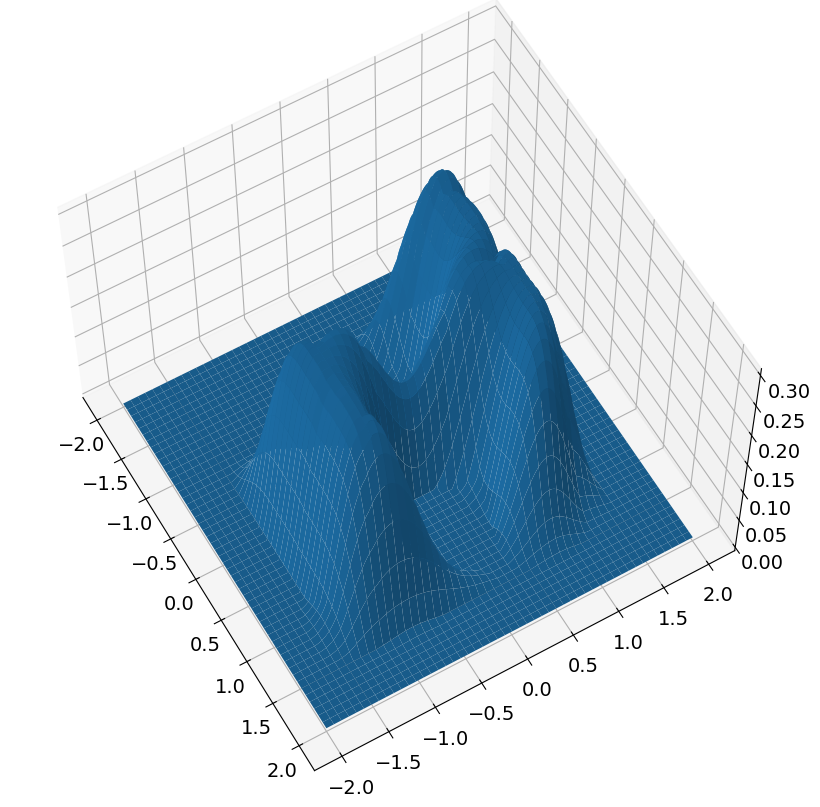

new position is [ 0.38034114 -1.24195766]
h is now 0.05
new time is 500
dx: 1.8540965704134473


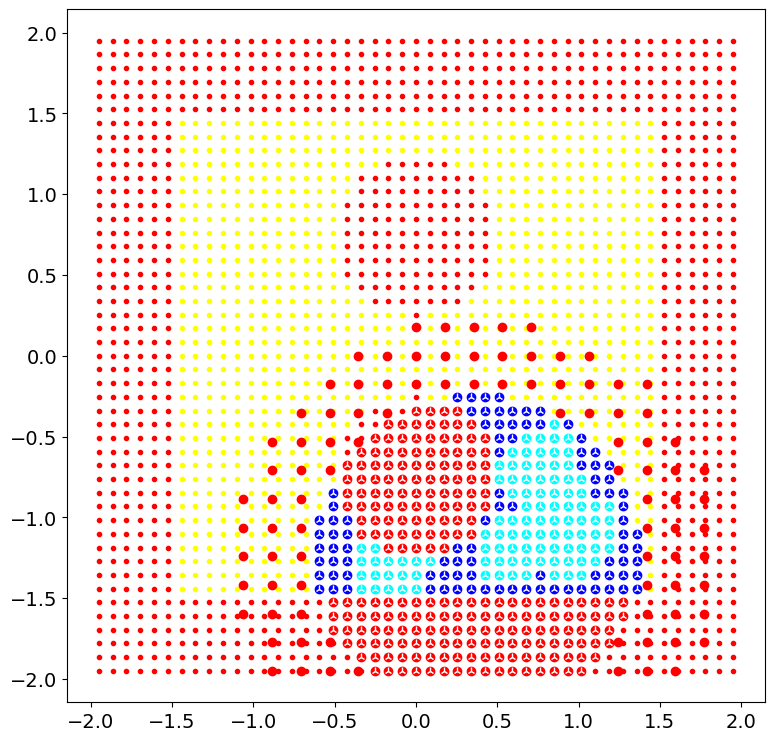

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          408     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.62569D+05    |proj g|=  1.05000D+02


 This problem is unconstrained.



At iterate   50    f=  6.37245D+02    |proj g|=  2.05829D+00

At iterate  100    f=  6.36923D+02    |proj g|=  1.35773D+00

At iterate  150    f=  6.36904D+02    |proj g|=  8.09052D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  408    192    269      1     0     0   8.622D-01   6.369D+02
  F =   636.88847463058210     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(408, 2)
numc 408
cmax before 441
numc <= self.cmax
Cnew shape before (408, 2)
Cnew shape after (408, 2)
theta shape before (

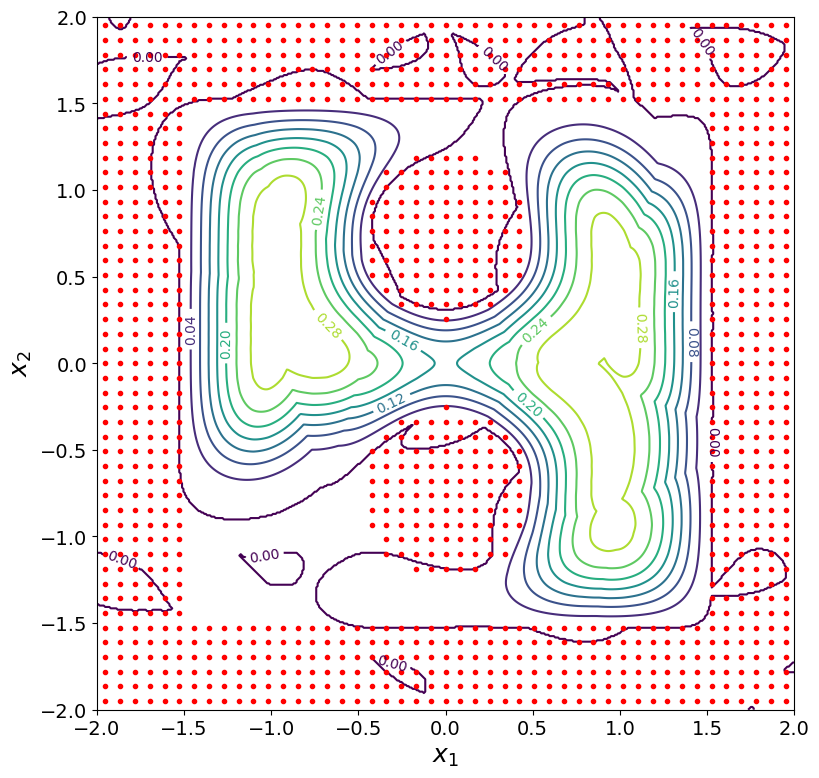

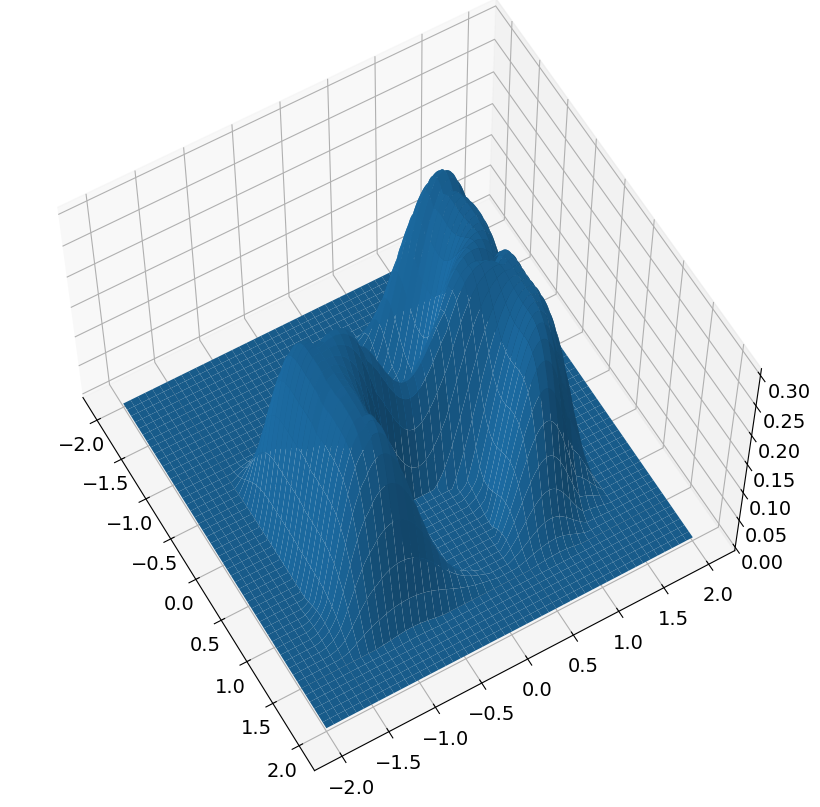

target: [-0.41479796 -1.54283254]
target in goto [-0.41479796 -1.54283254]
position is [ 0.38034114 -1.24195766]
h is 0.05064291822020017
start time is 500


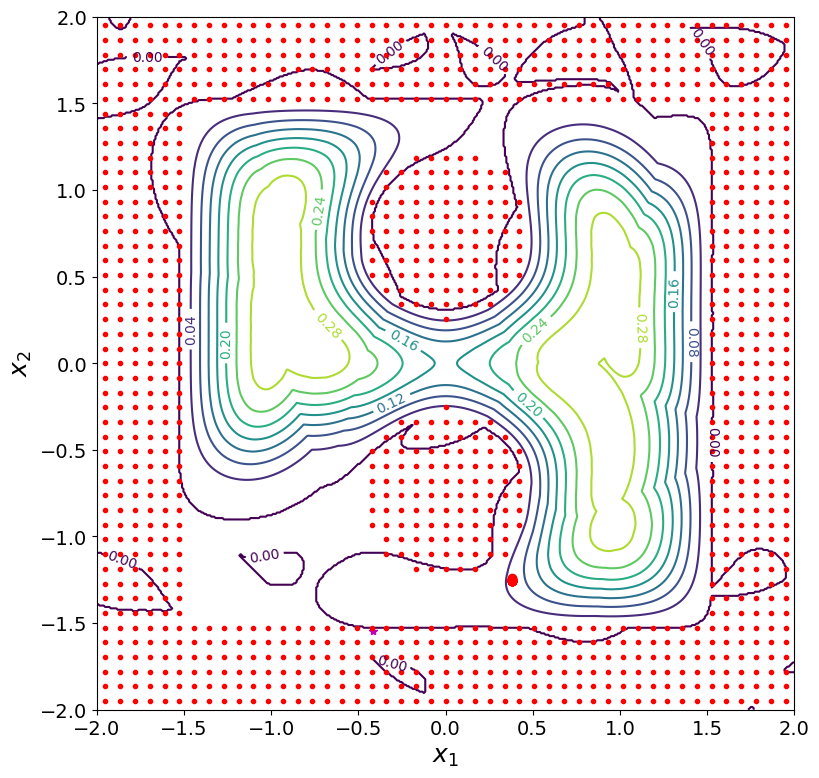

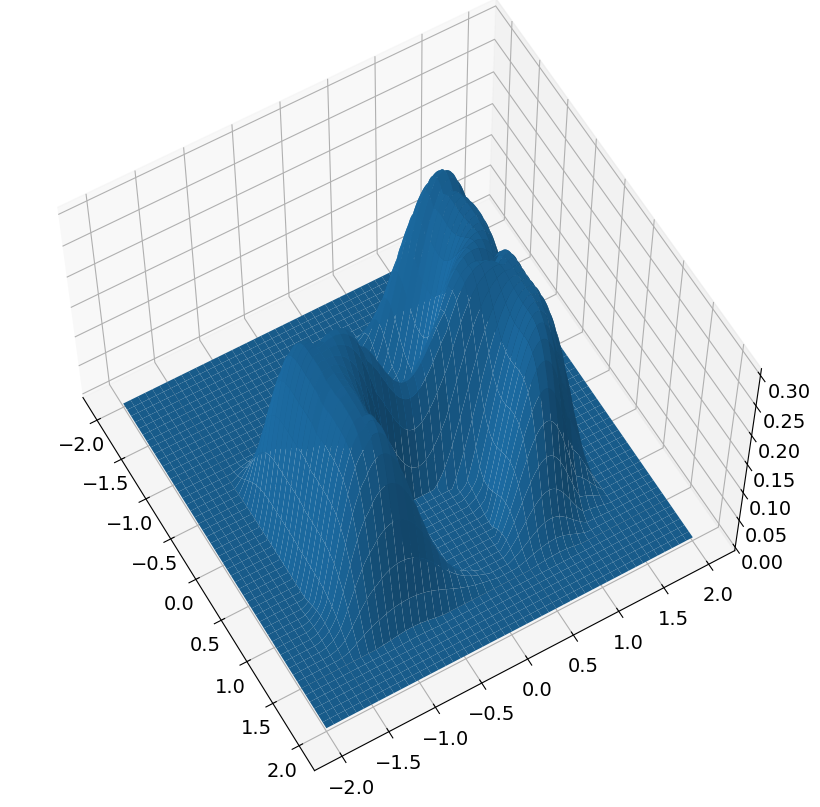

new position is [ 0.37884373 -1.25832192]
h is now 0.049999999999999996
new time is 550
dx: 0.01643262796130451
target: [ 1.76423902 -1.86960909]
target in goto [ 1.76423902 -1.86960909]
position is [ 0.37884373 -1.25832192]
h is 0.049999999999999996
start time is 550


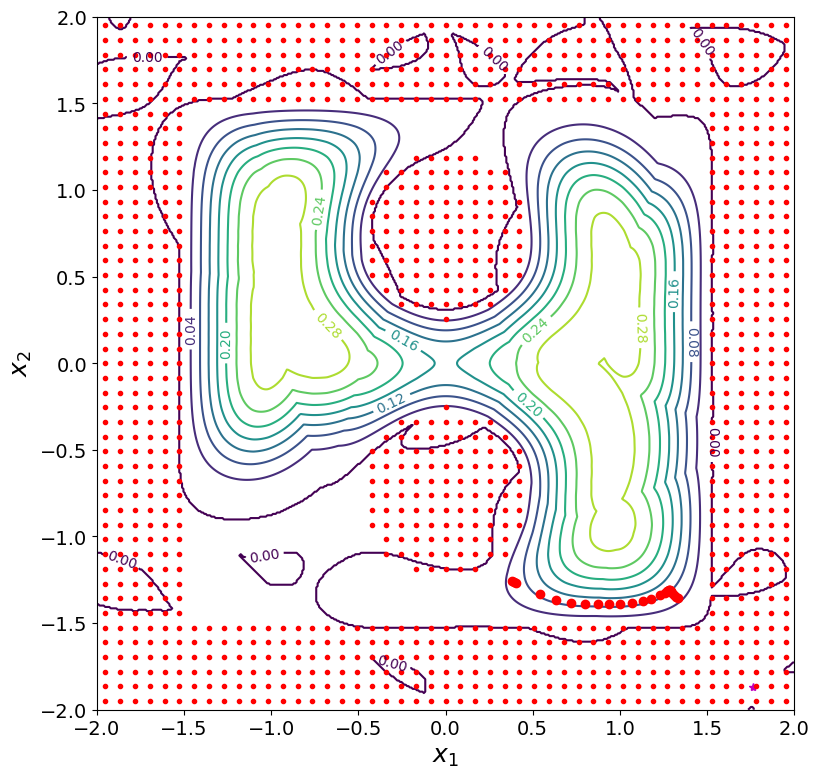

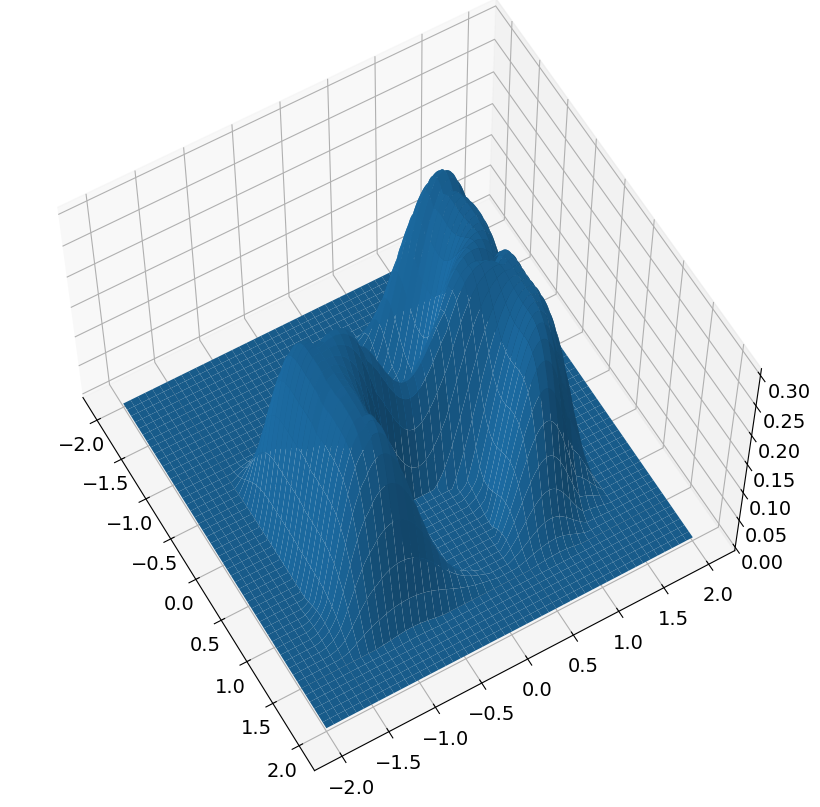

new position is [ 1.33166116 -1.35728923]
h is now 0.05000000000000002
new time is 600
dx: 0.9582855235797954


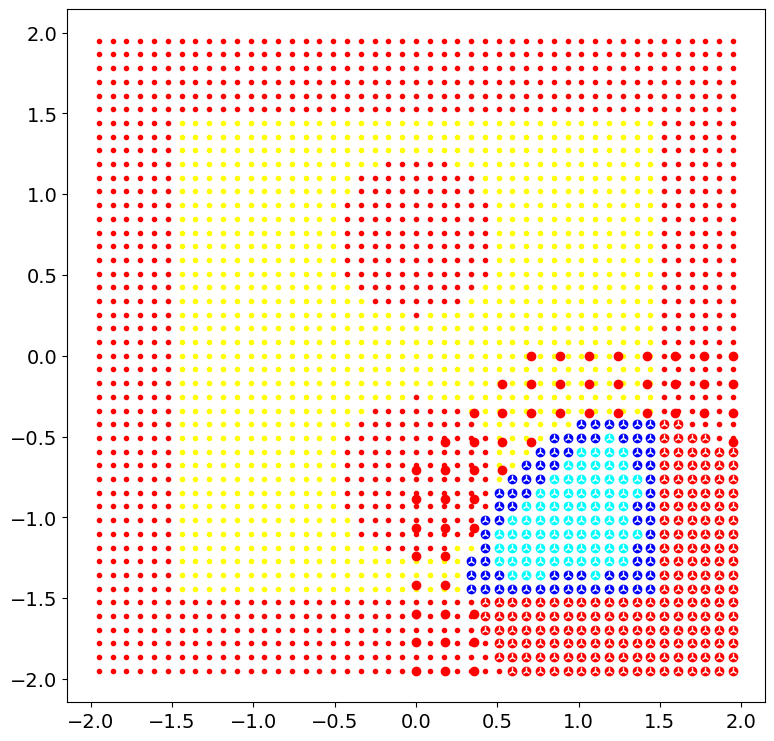

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          331     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.94102D+05    |proj g|=  1.07150D+02


 This problem is unconstrained.



At iterate   50    f=  4.54406D+02    |proj g|=  9.19860D-01

At iterate  100    f=  4.54326D+02    |proj g|=  1.53050D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  331    132    210      1     0     0   1.263D+00   4.543D+02
  F =   454.30684101970940     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(331, 2)
numc 331
cmax before 441
numc <= self.cmax
Cnew shape before (331, 2)
Cnew shape after (331, 2)
theta shape before (331,)
theta_shape after (441,)
cmax after 441
centers

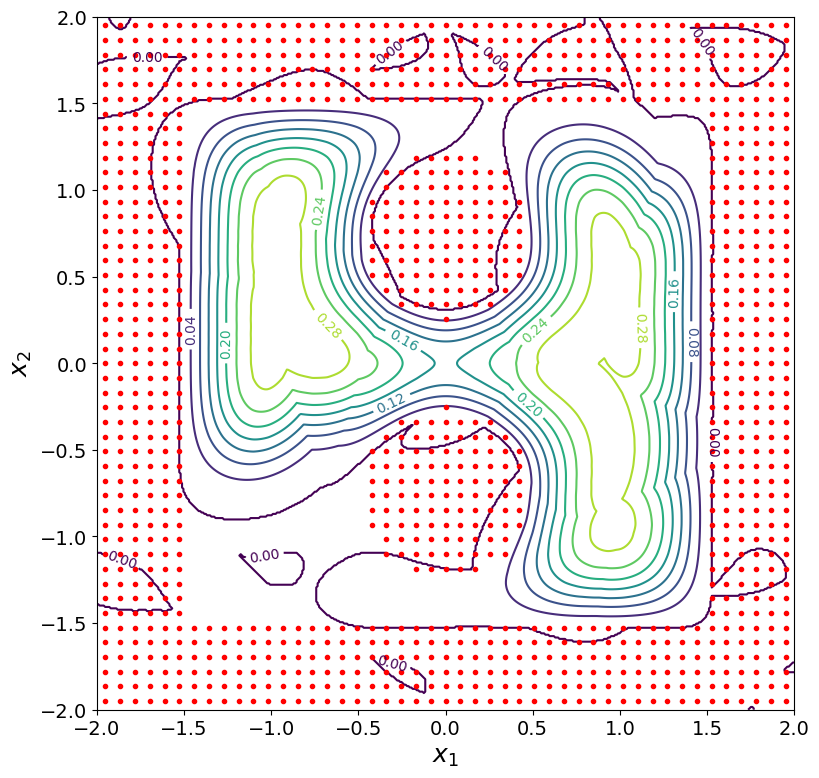

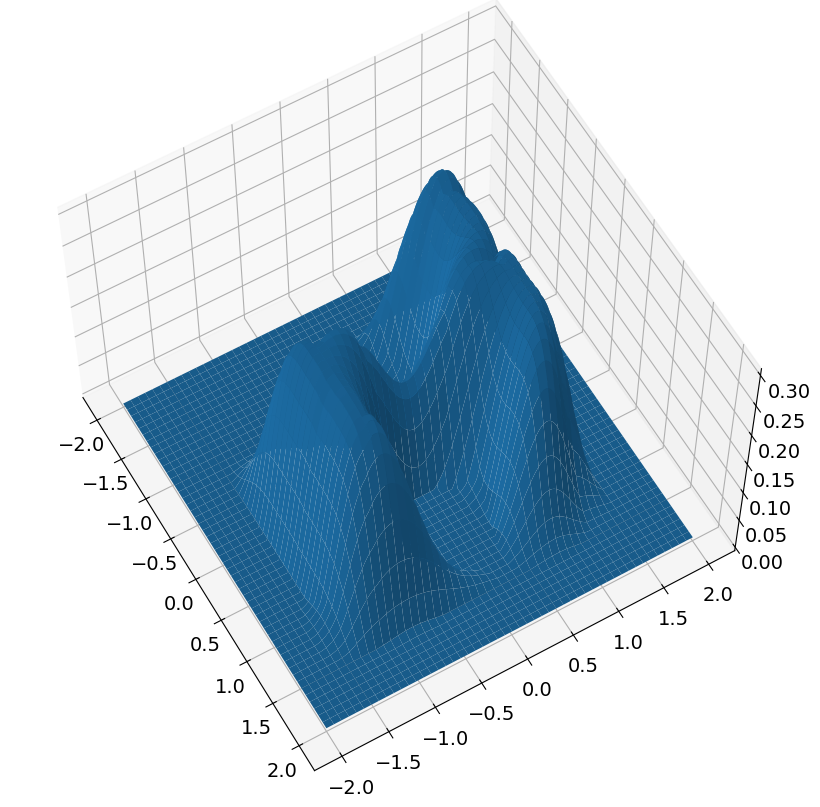

target: [ 1.84335108 -1.72256204]
target in goto [ 1.84335108 -1.72256204]
position is [ 1.33166116 -1.35728923]
h is 0.05000000000000002
start time is 600


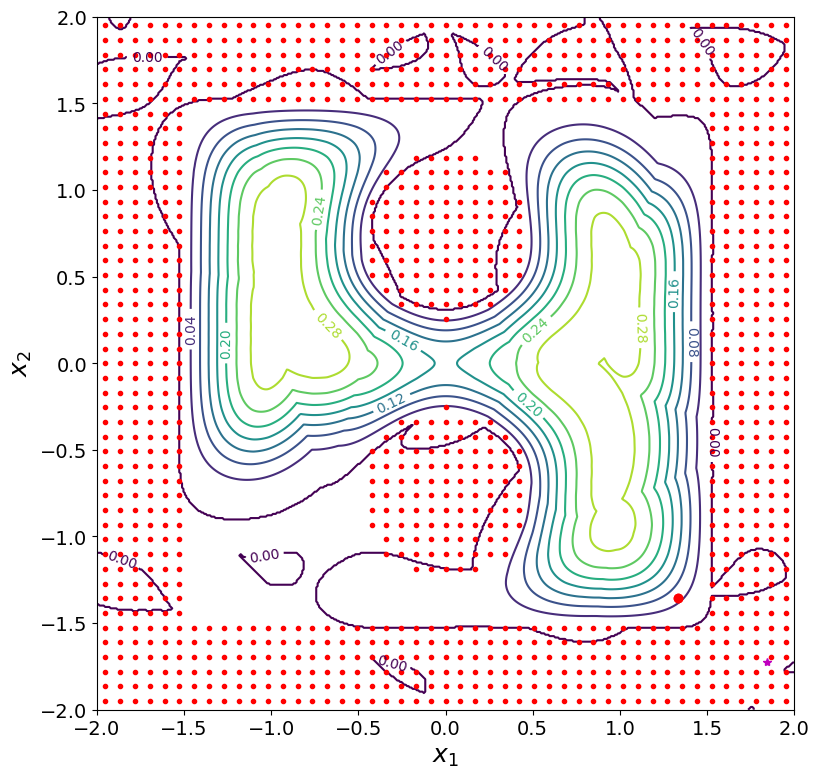

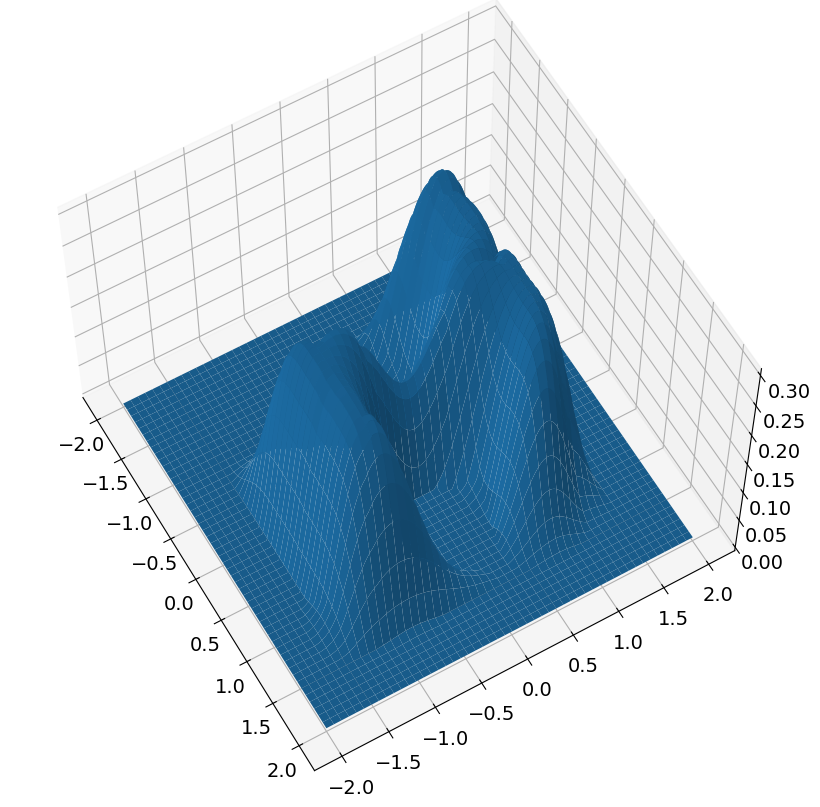

new position is [ 1.33166116 -1.35728923]
h is now 0.05
new time is 650
dx: 2.4230347267646374e-14
target: [-1.79256469 -1.94975214]
target in goto [-1.79256469 -1.94975214]
position is [ 1.33166116 -1.35728923]
h is 0.05
start time is 650


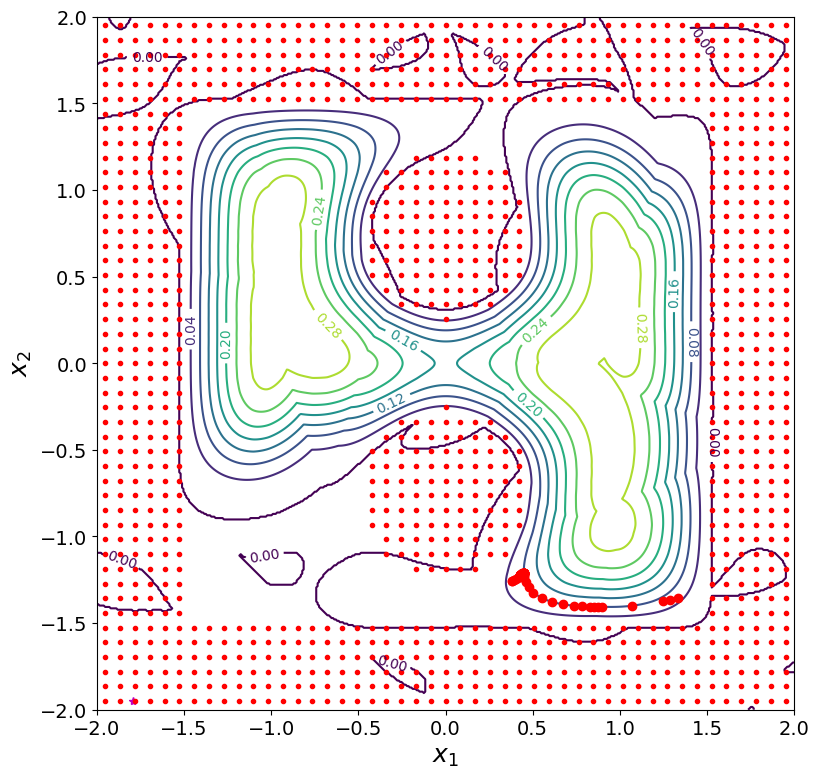

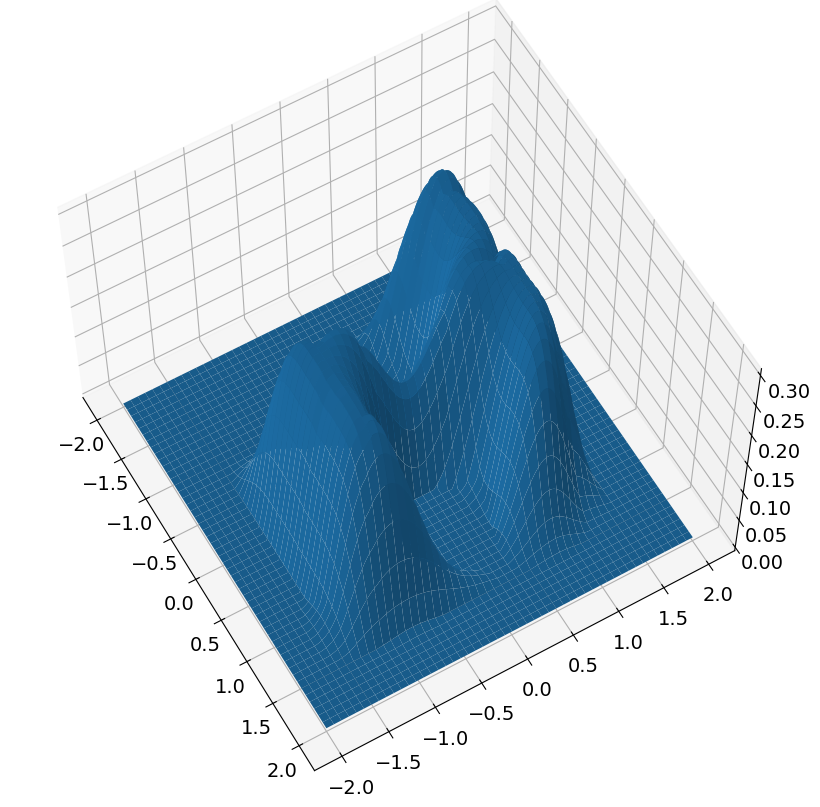

new position is [ 0.3787677  -1.25717193]
h is now 0.04999999999999999
new time is 700
dx: 0.958138520139405


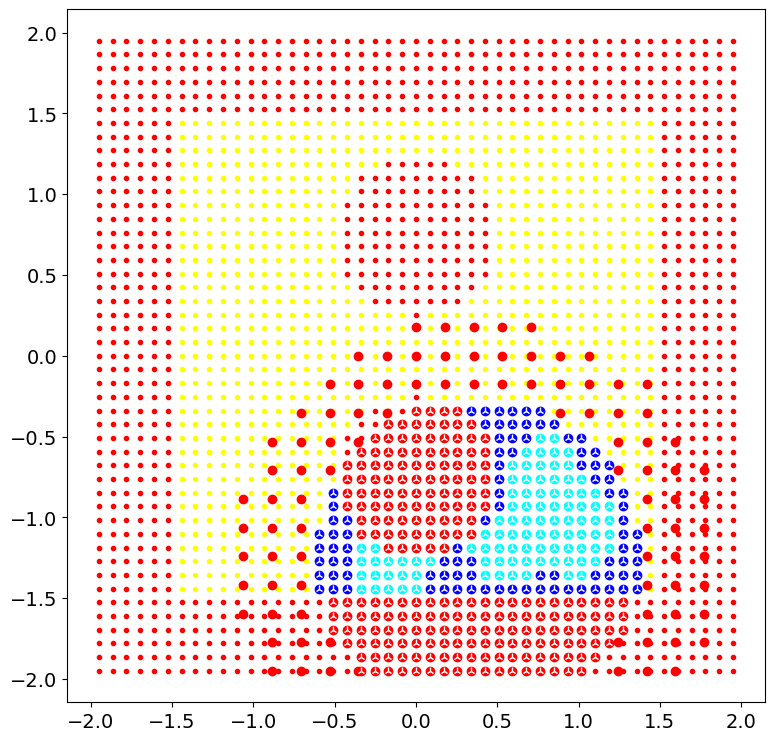

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          404     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.43812D+05    |proj g|=  1.05800D+02


 This problem is unconstrained.



At iterate   50    f=  6.09261D+02    |proj g|=  1.52930D+00

At iterate  100    f=  6.09152D+02    |proj g|=  9.57797D-01

At iterate  150    f=  6.09125D+02    |proj g|=  1.30844D+00

At iterate  200    f=  6.09114D+02    |proj g|=  5.79840D-01

At iterate  250    f=  6.09111D+02    |proj g|=  1.21740D+00

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(404, 2)
numc 404
cmax before 441
numc <= self.cmax
Cnew shape before (404, 2)
Cnew shape after (404, 2)
theta shape before (404,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generali

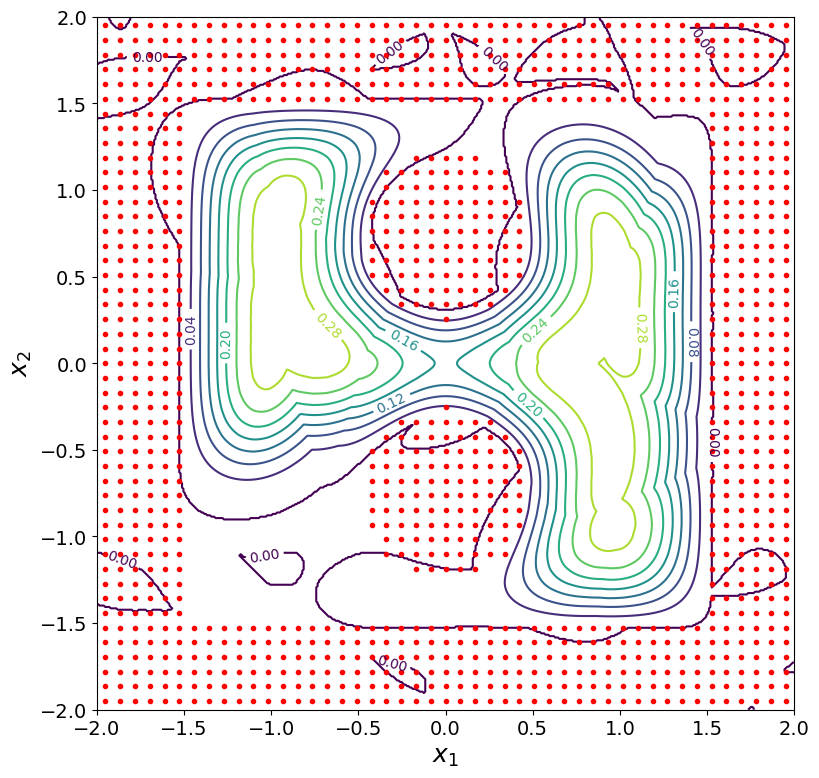

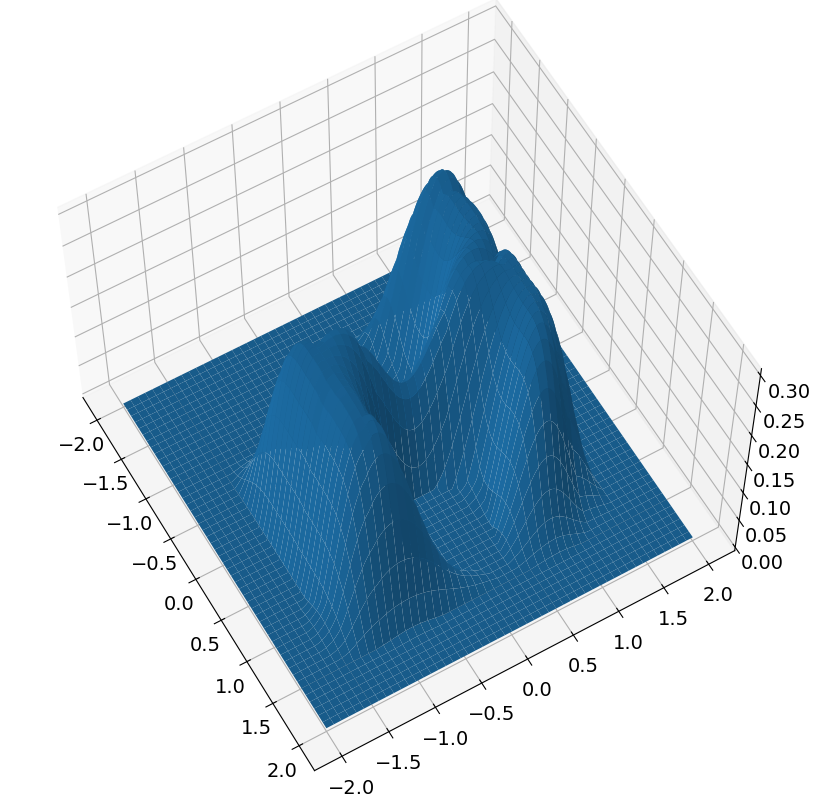

target: [-1.83971249 -0.60168465]
target in goto [-1.83971249 -0.60168465]
position is [ 0.3787677  -1.25717193]
h is 0.05220901153591184
start time is 700


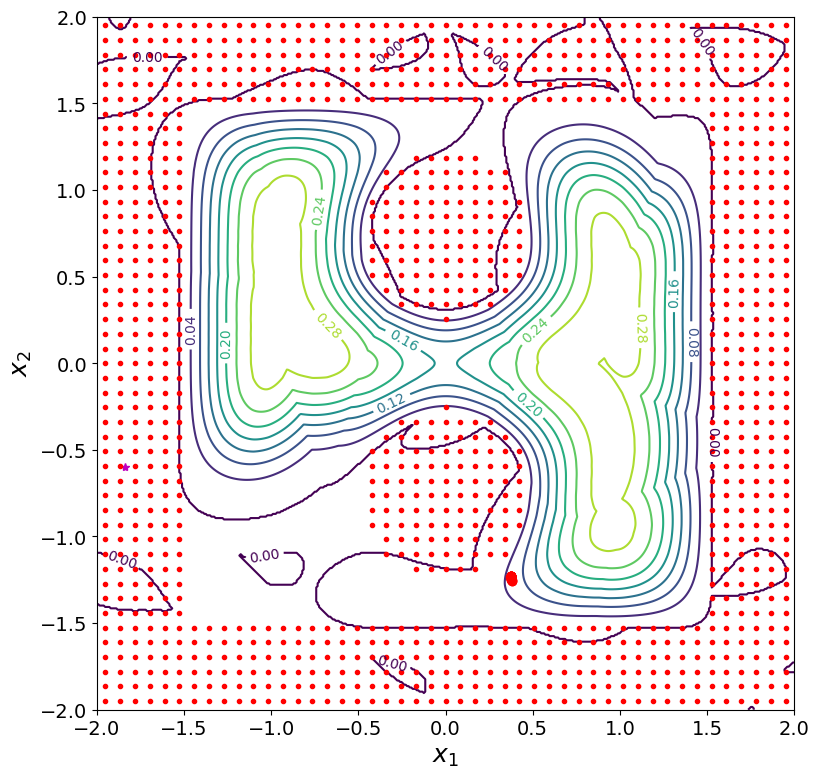

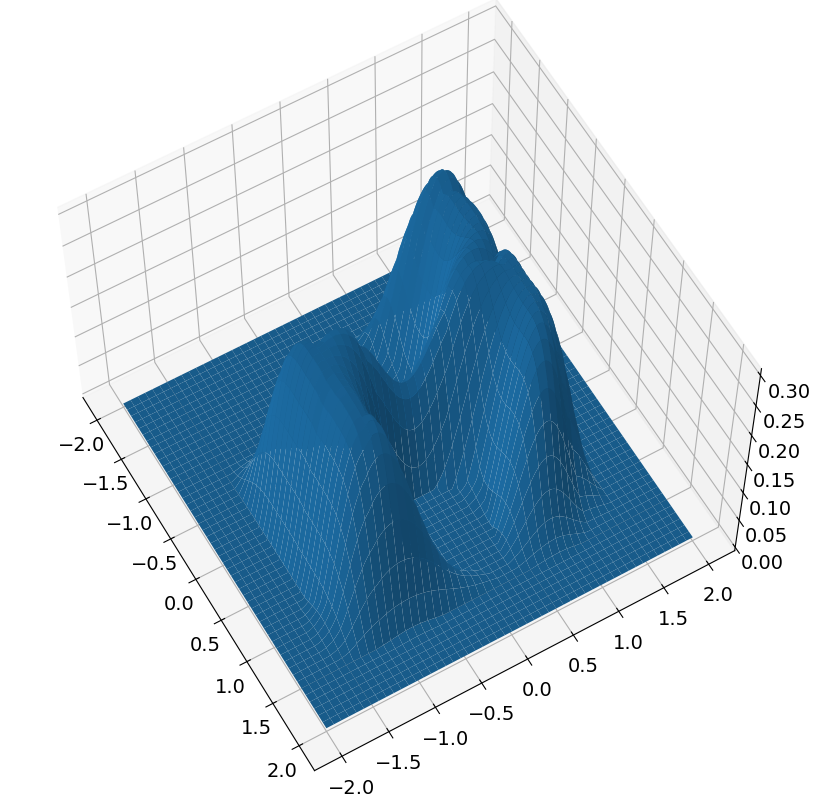

new position is [ 0.37214728 -1.2344371 ]
h is now 0.05000000000000002
new time is 750
dx: 0.02367915229823947
target: [-1.55139424  0.56902371]
target in goto [-1.55139424  0.56902371]
position is [ 0.37214728 -1.2344371 ]
h is 0.05000000000000002
start time is 750


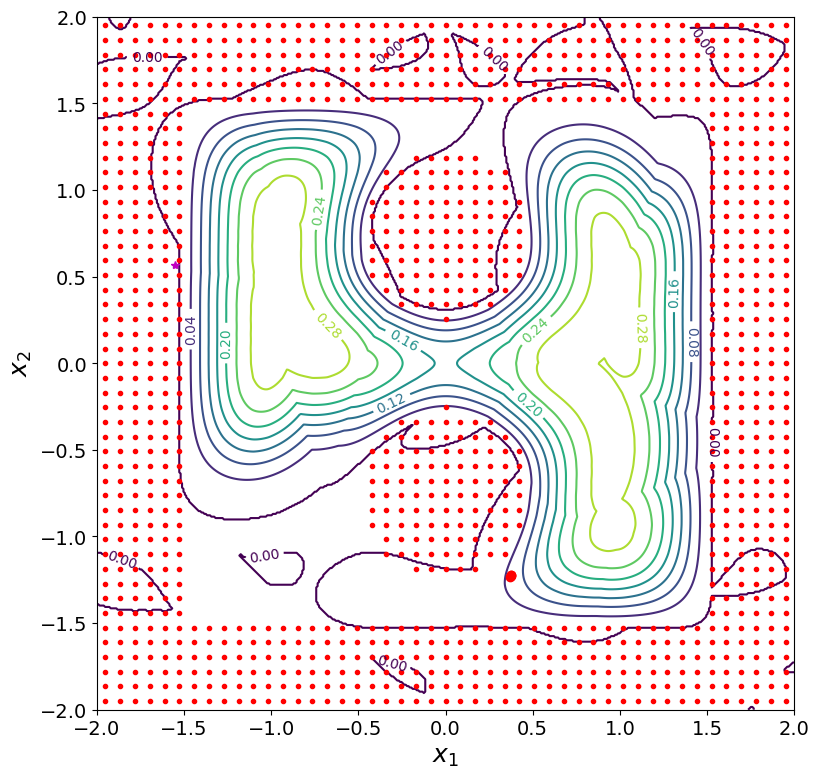

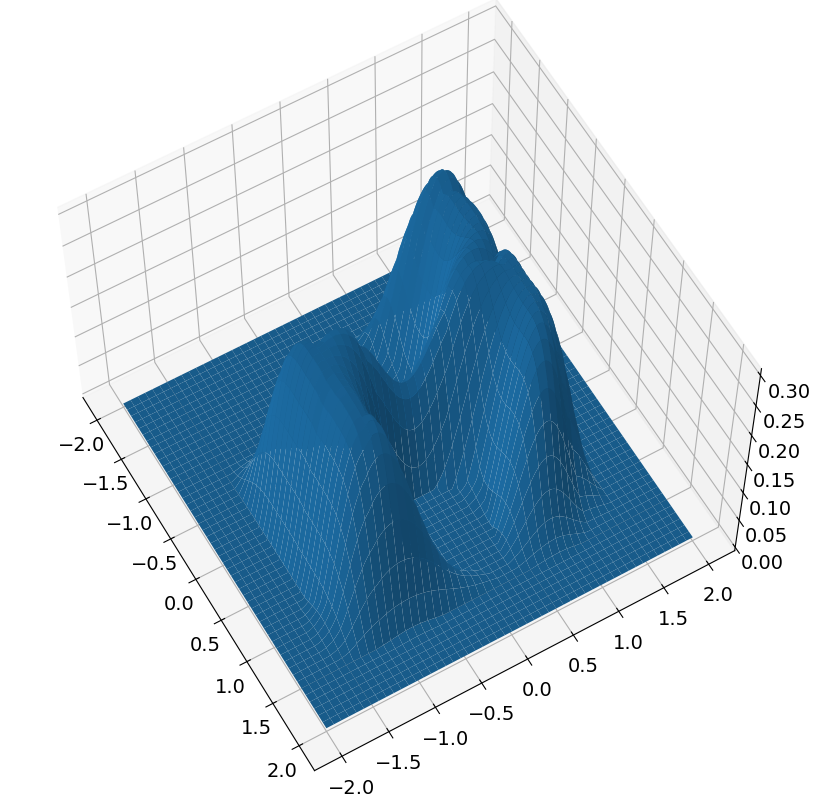

new position is [ 0.37327368 -1.22166869]
h is now 0.04999999999999998
new time is 800
dx: 0.03592581865204687
target: [1.31719107 1.91605096]
target in goto [1.31719107 1.91605096]
position is [ 0.37327368 -1.22166869]
h is 0.04999999999999998
start time is 800


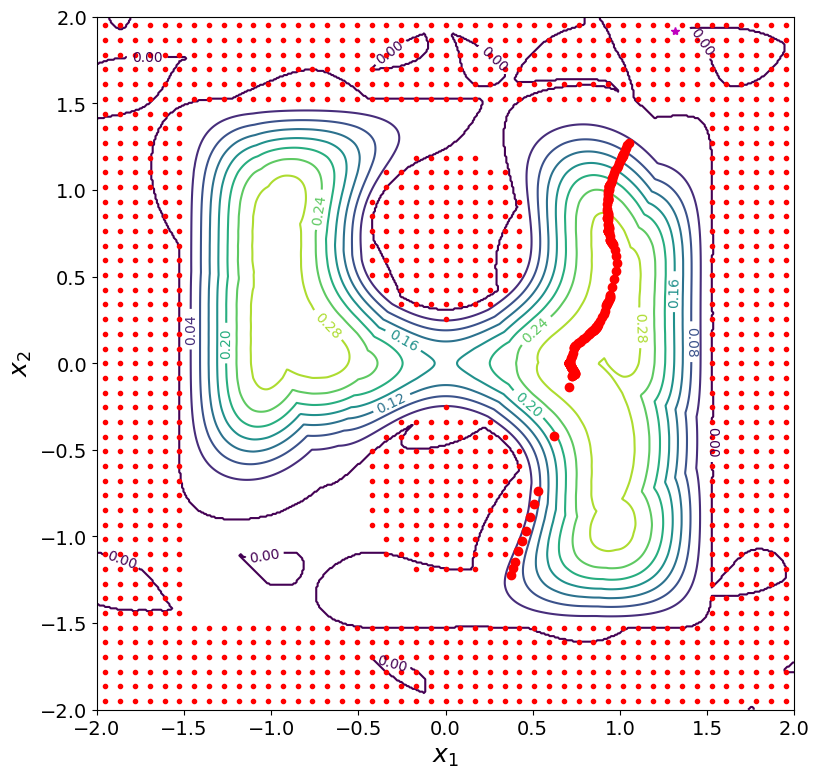

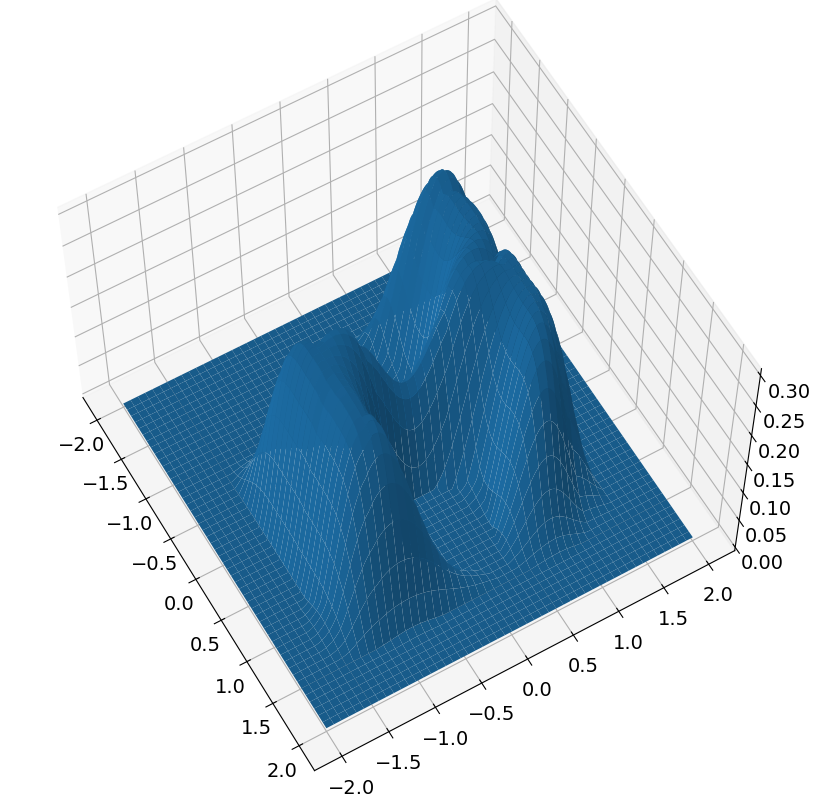

new position is [1.05049183 1.27387763]
h is now 0.05
new time is 850
dx: 2.6186685876136093


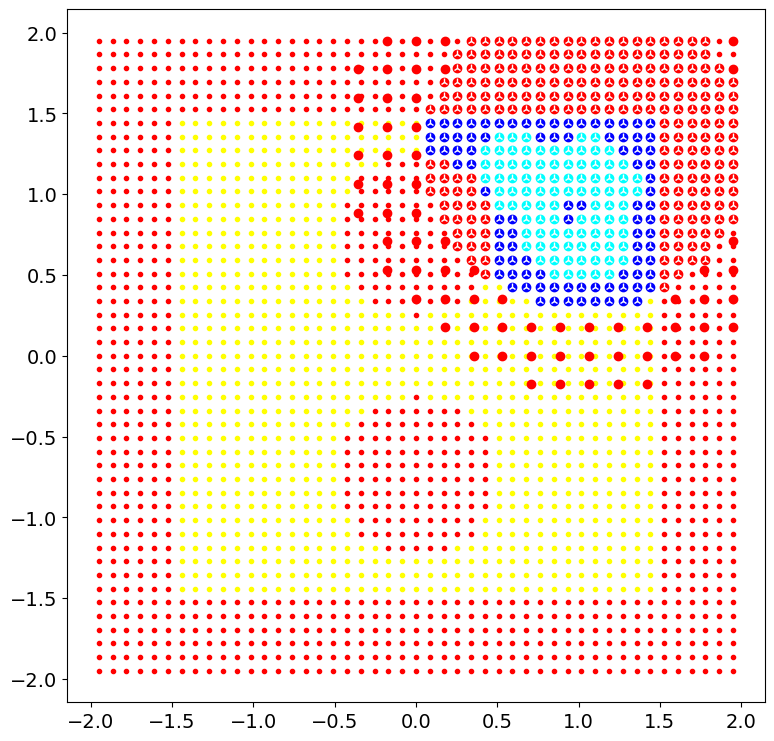

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          398     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.43942D+05    |proj g|=  1.11457D+02


 This problem is unconstrained.



At iterate   50    f=  5.28204D+02    |proj g|=  1.22677D+00

At iterate  100    f=  5.28029D+02    |proj g|=  6.57098D-01

At iterate  150    f=  5.28009D+02    |proj g|=  1.34944D+00

At iterate  200    f=  5.27991D+02    |proj g|=  1.31473D+00

At iterate  250    f=  5.27970D+02    |proj g|=  6.81542D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  398    285    460      1     0     0   8.170D-01   5.280D+02
  F =   527.96546746143929     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(

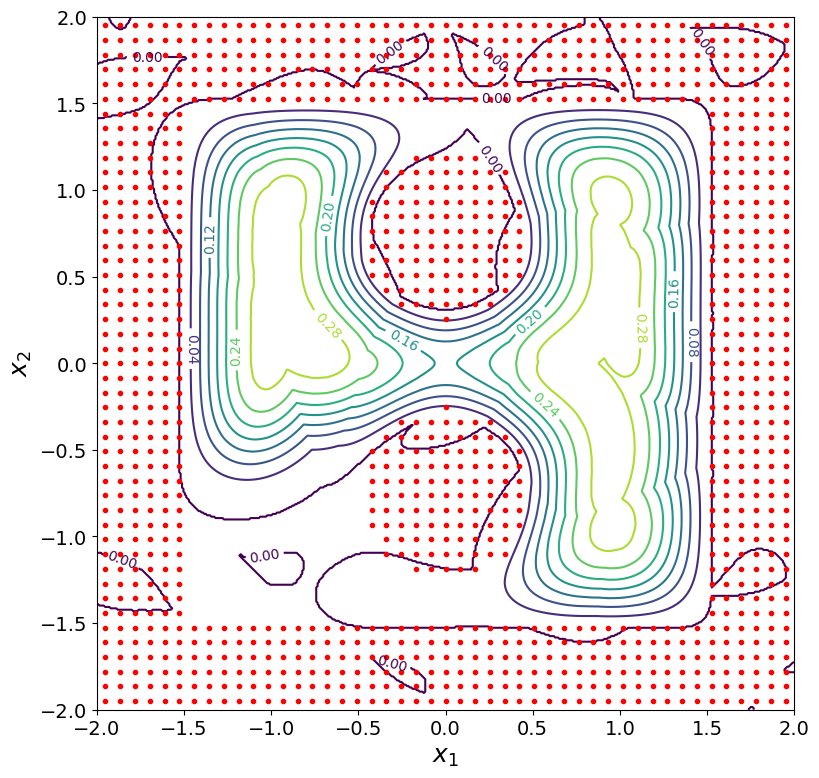

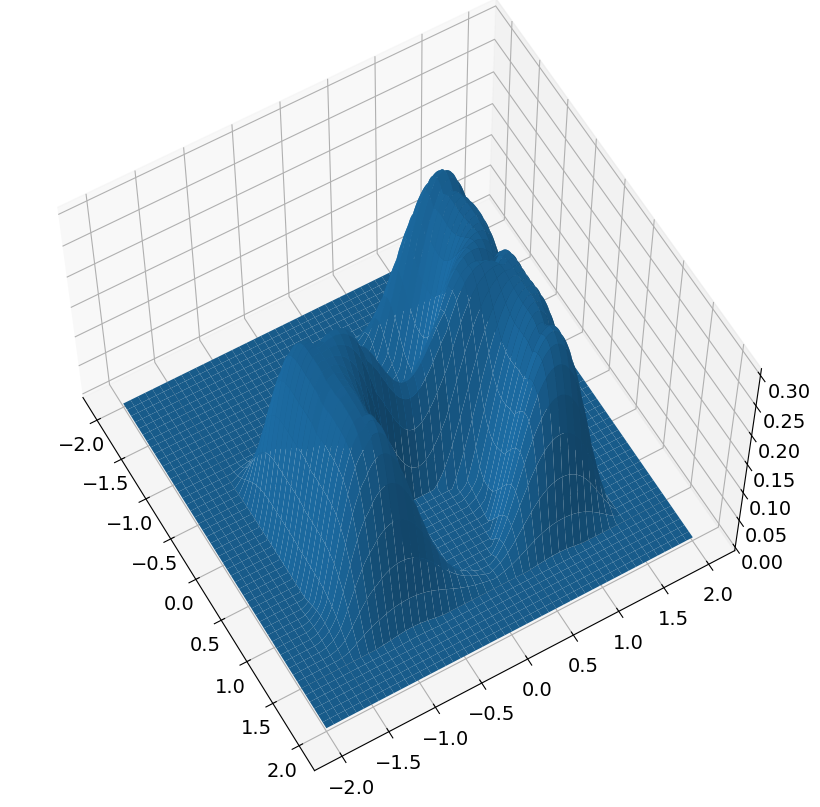

target: [-0.08464305 -1.94160441]
target in goto [-0.08464305 -1.94160441]
position is [1.05049183 1.27387763]
h is 0.16860767029758023
start time is 850


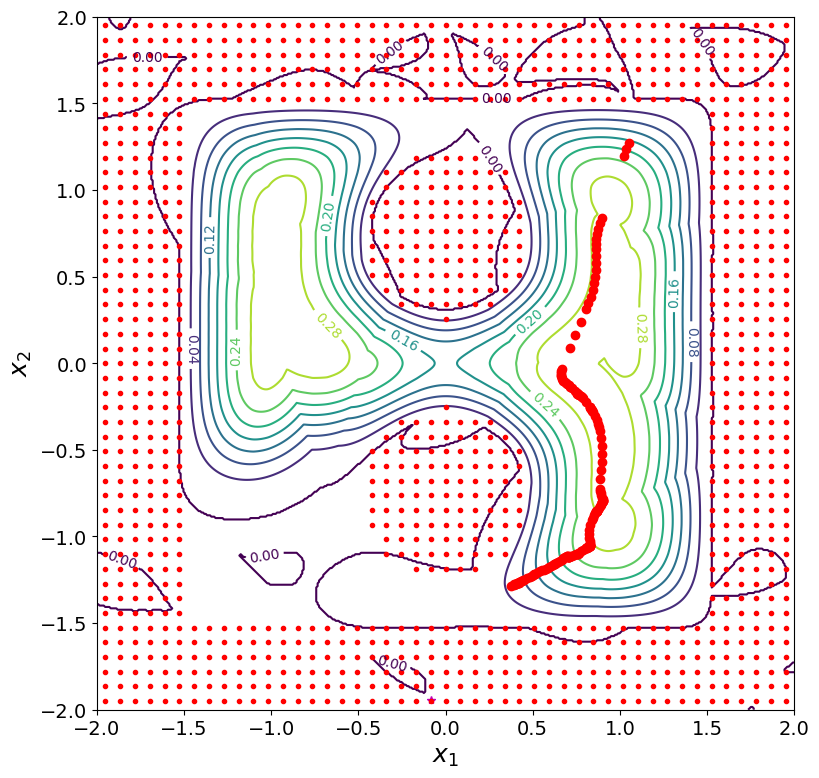

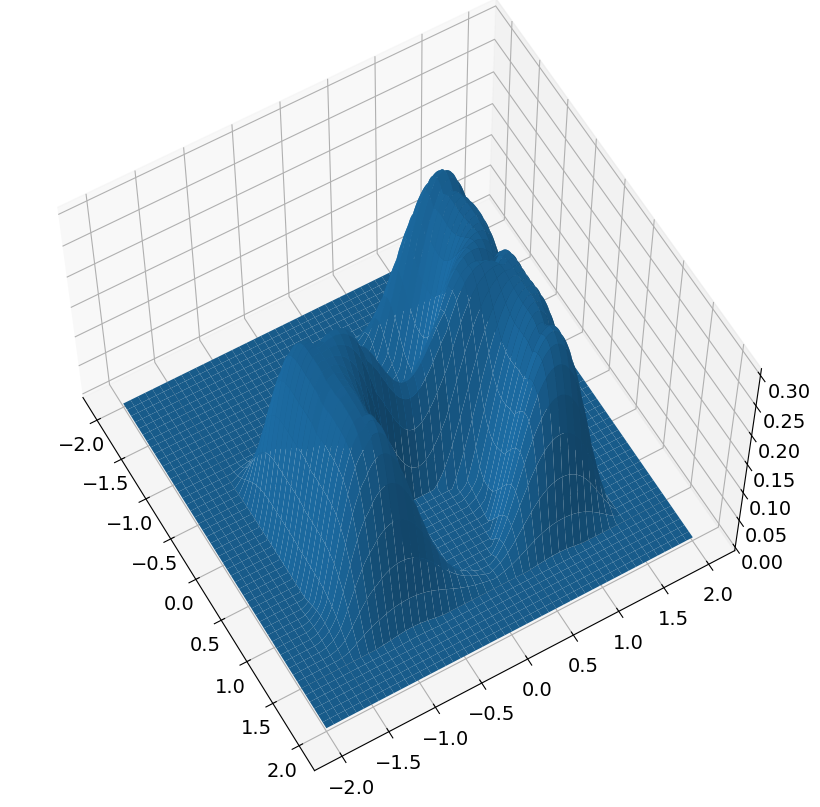

new position is [ 0.37657003 -1.28404431]
h is now 0.05000000000000002
new time is 900
dx: 2.645209869073411


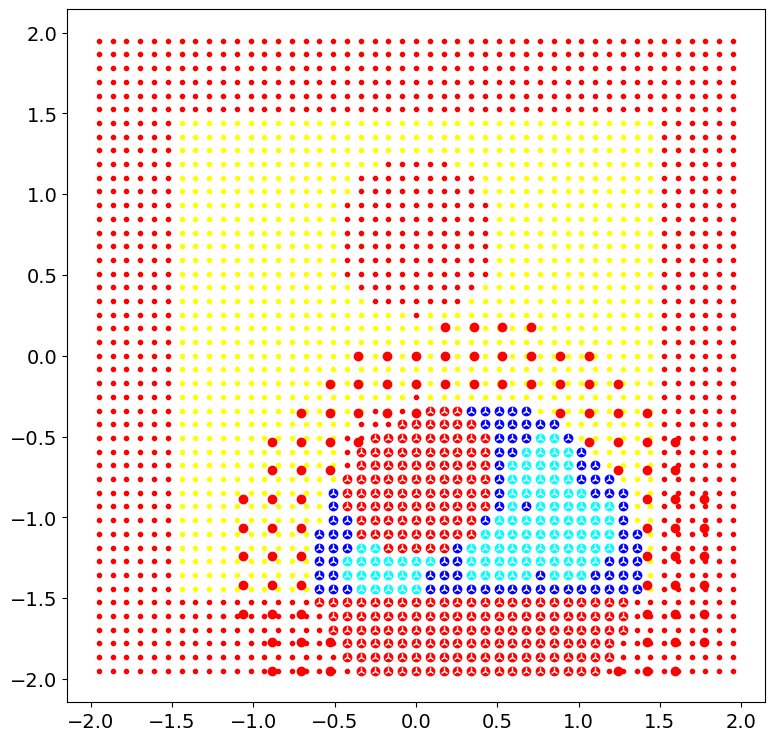

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          401     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.50504D+05    |proj g|=  1.05323D+02


 This problem is unconstrained.



At iterate   50    f=  6.33446D+02    |proj g|=  1.05692D+00

At iterate  100    f=  6.33390D+02    |proj g|=  5.85881D-01

At iterate  150    f=  6.33339D+02    |proj g|=  8.32702D-01

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(401, 2)
numc 401
cmax before 441
numc <= self.cmax
Cnew shape before (401, 2)
Cnew shape after (401, 2)
theta shape before (401,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function val

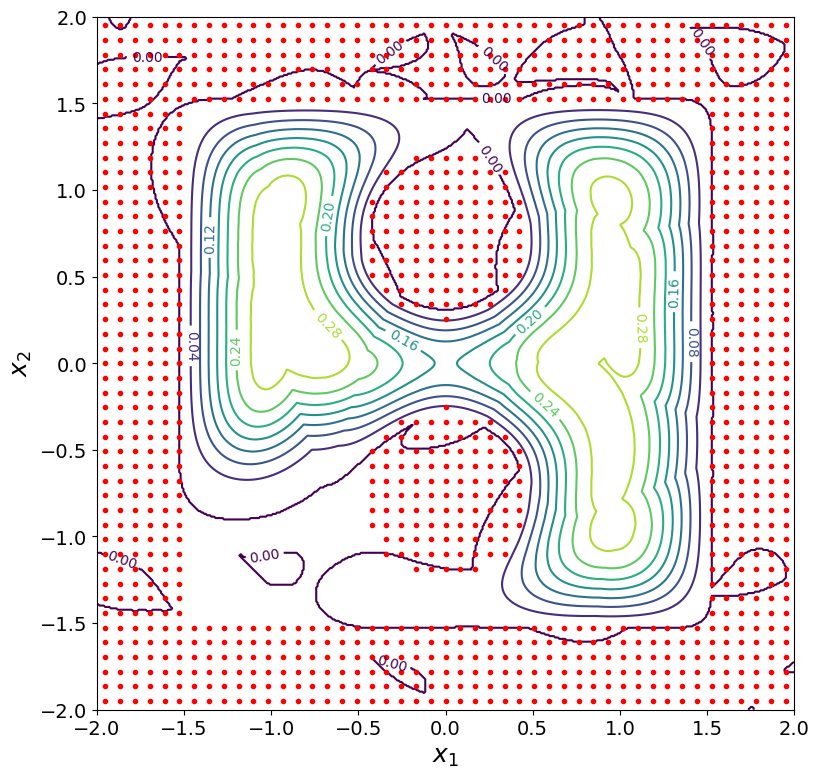

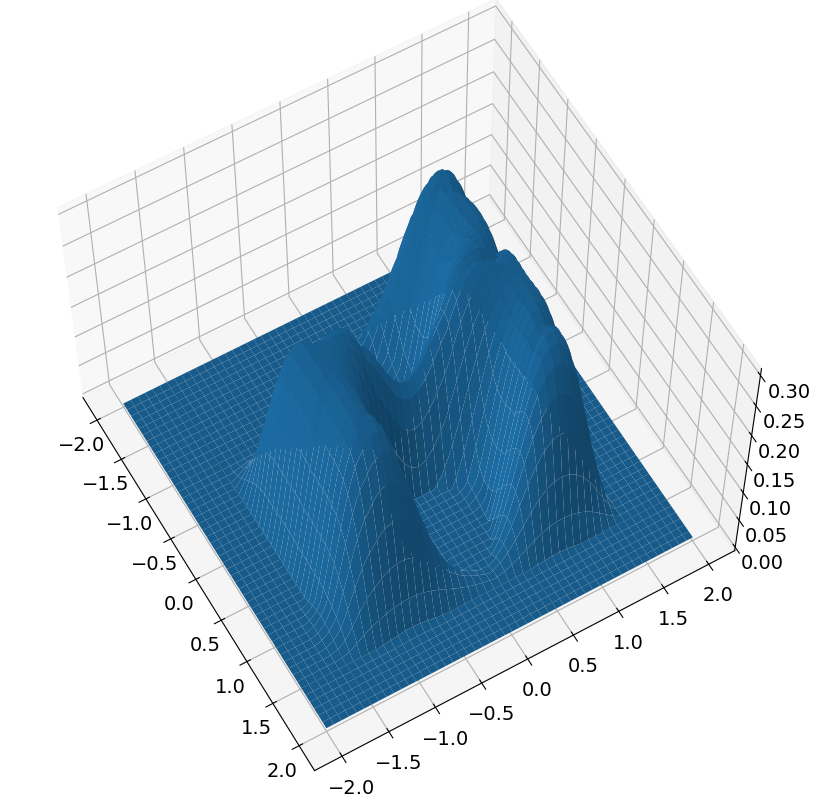

target: [-1.65809576  0.73904868]
target in goto [-1.65809576  0.73904868]
position is [ 0.37657003 -1.28404431]
h is 0.054556095436912394
start time is 900


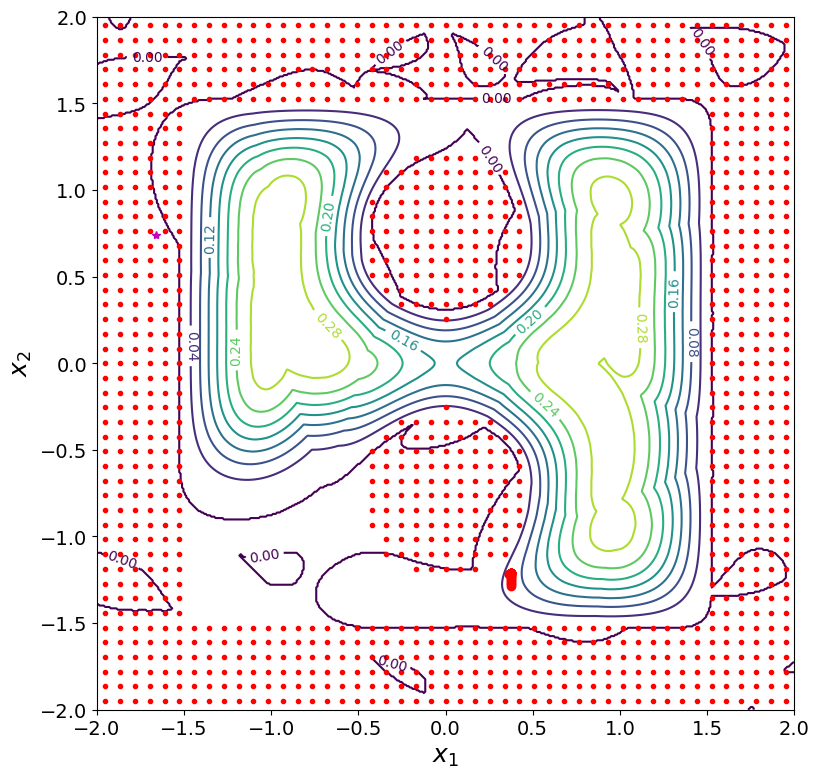

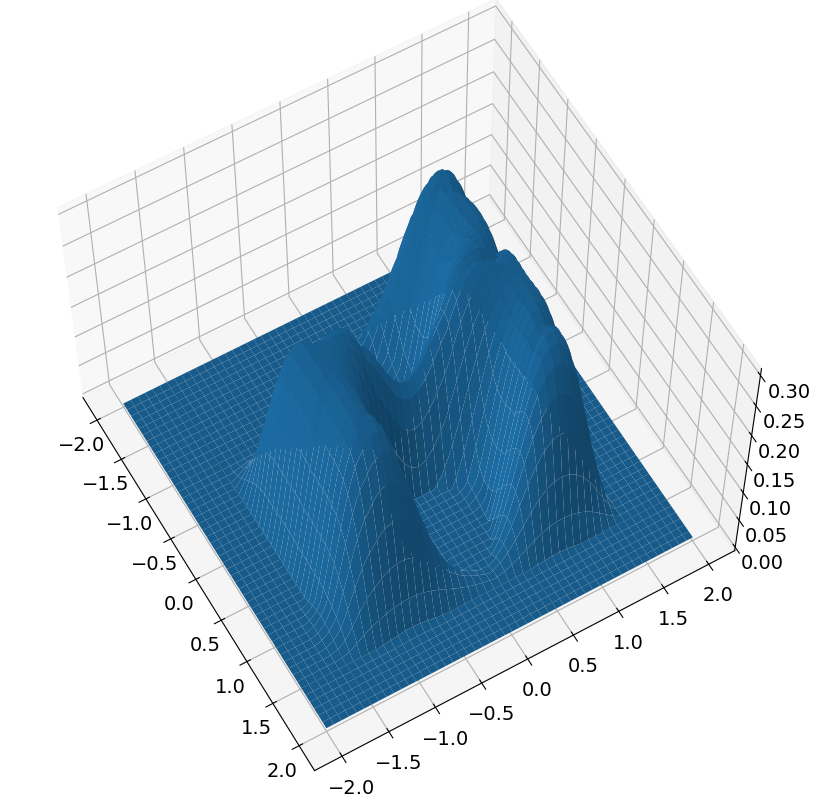

new position is [ 0.36316714 -1.21899269]
h is now 0.04999999999999999
new time is 950
dx: 0.066417999127046


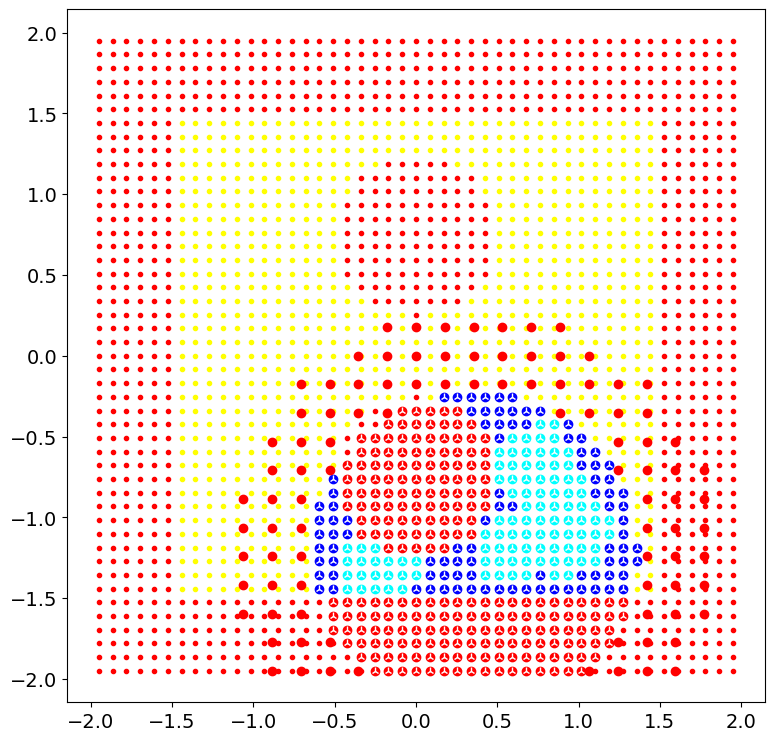

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          411     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.72029D+05    |proj g|=  1.06977D+02


 This problem is unconstrained.



At iterate   50    f=  6.48845D+02    |proj g|=  1.65570D+00

At iterate  100    f=  6.48617D+02    |proj g|=  9.99242D-01

At iterate  150    f=  6.48554D+02    |proj g|=  1.37376D+00

At iterate  200    f=  6.48546D+02    |proj g|=  6.76346D-01

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(411, 2)
numc 411
cmax before 441
numc <= self.cmax
Cnew shape before (411, 2)
Cnew shape after (411, 2)
theta shape before (411,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauc

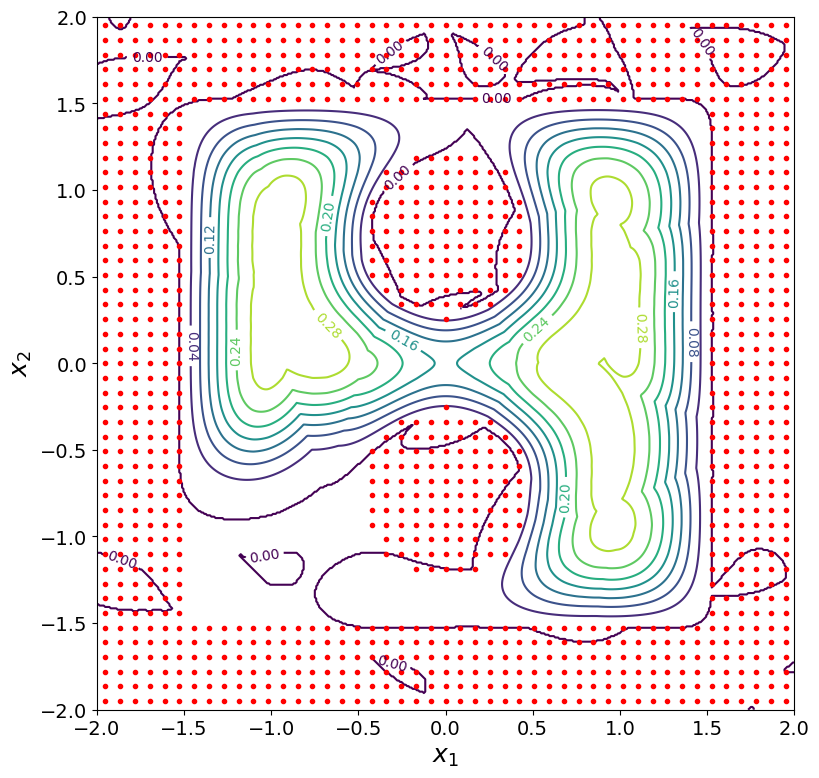

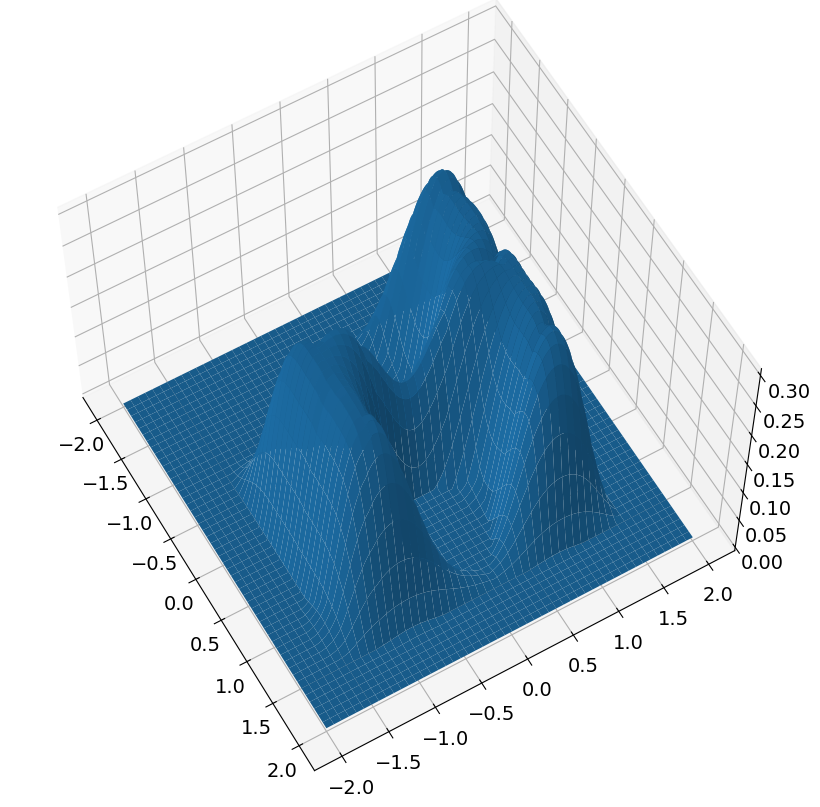

target: [ 0.4516306  -1.55864394]
target in goto [ 0.4516306  -1.55864394]
position is [ 0.36316714 -1.21899269]
h is 0.04999999999999999
start time is 950


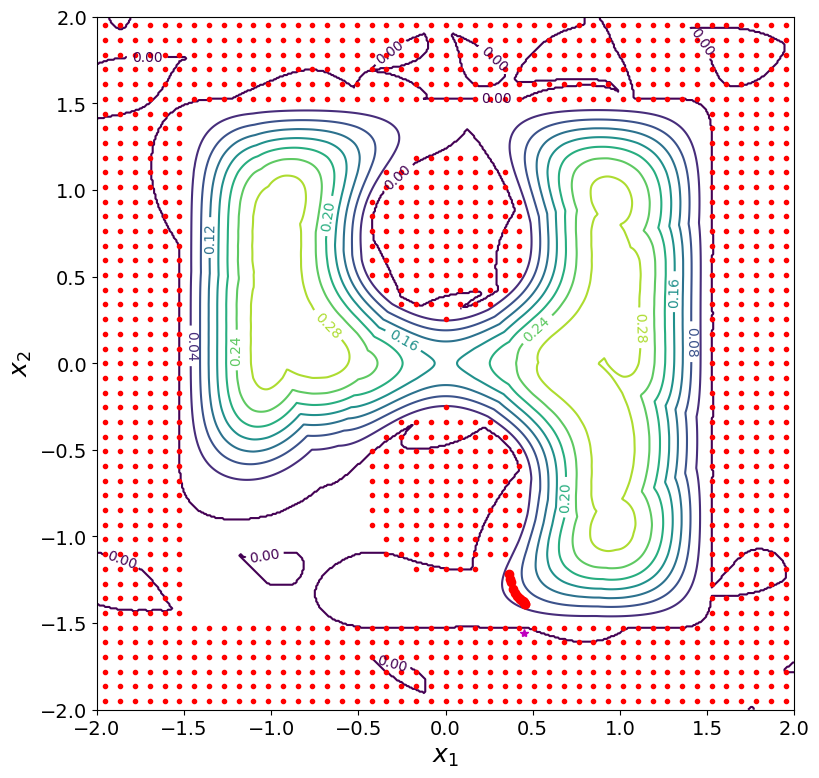

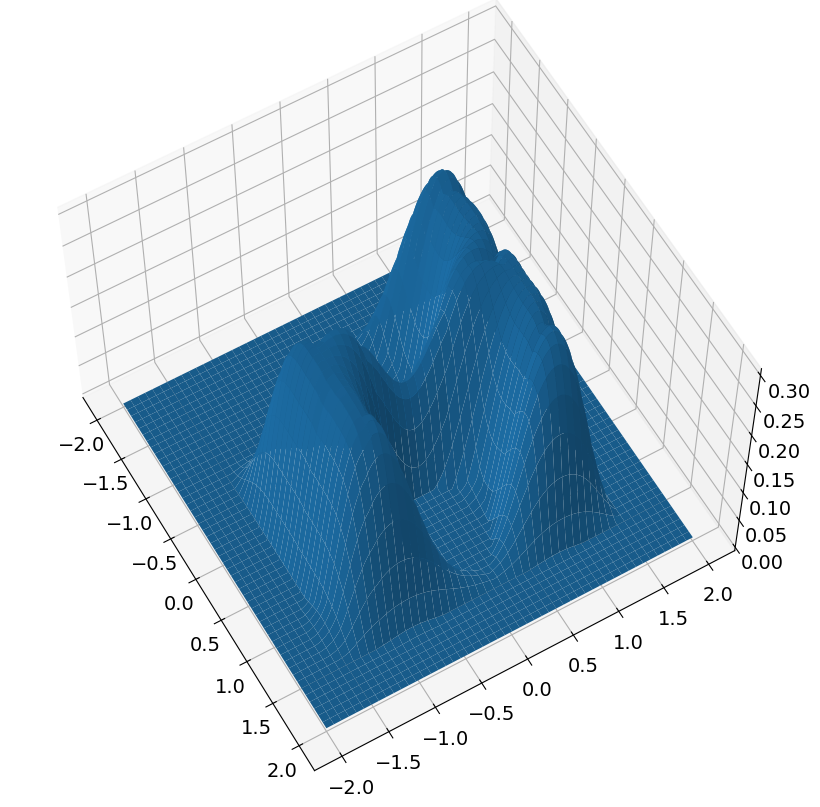

new position is [ 0.45686432 -1.3901841 ]
h is now 0.05000000000000007
new time is 1000
dx: 0.1951554757364915


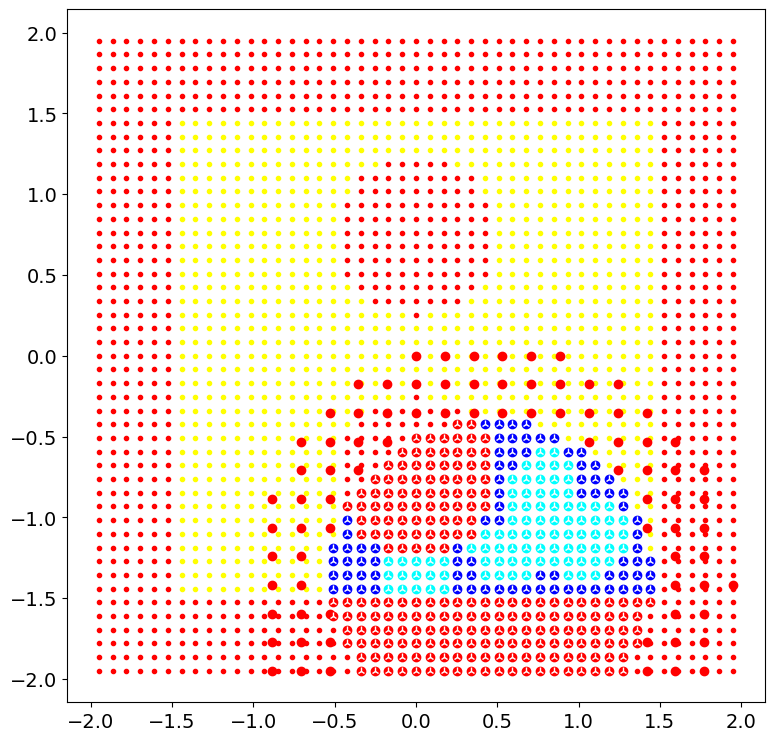

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          376     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.88048D+05    |proj g|=  1.06281D+02


 This problem is unconstrained.



At iterate   50    f=  5.69071D+02    |proj g|=  5.54608D-01

At iterate  100    f=  5.68806D+02    |proj g|=  6.39139D-01

At iterate  150    f=  5.68769D+02    |proj g|=  9.76162D-01

At iterate  200    f=  5.68739D+02    |proj g|=  1.05017D+00

At iterate  250    f=  5.68728D+02    |proj g|=  8.06472D-01



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.


centers shape before:
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  376    260    410      2     0     0   7.341D-01   5.687D+02
  F =   568.72775219080609     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(376, 2)
numc 376
cmax before 441
numc <= self.cmax
Cnew shape before (376, 2)
Cnew shape after (376, 2)
theta shape before (376,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(44

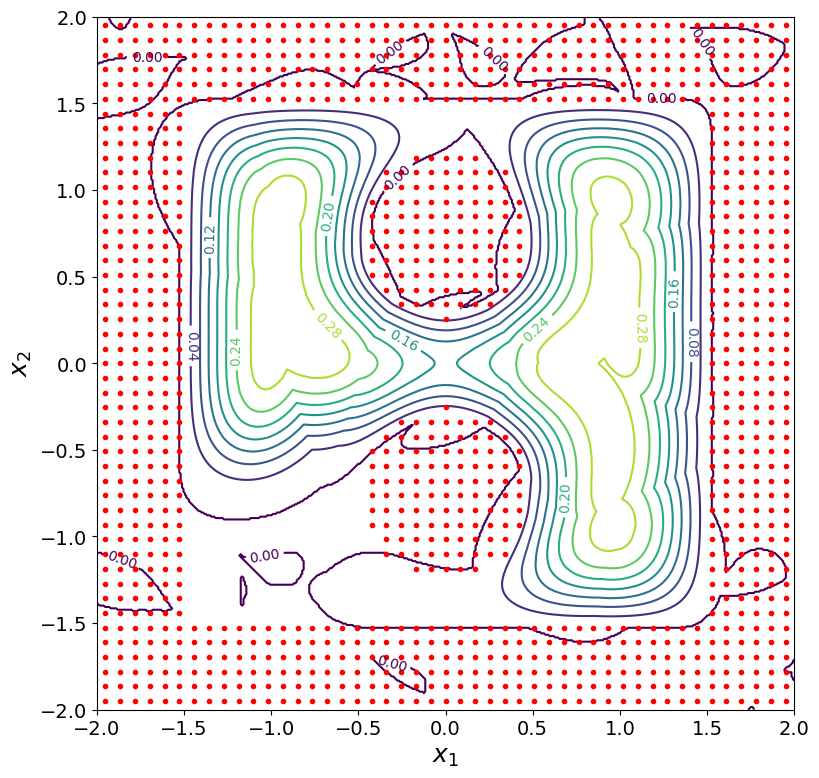

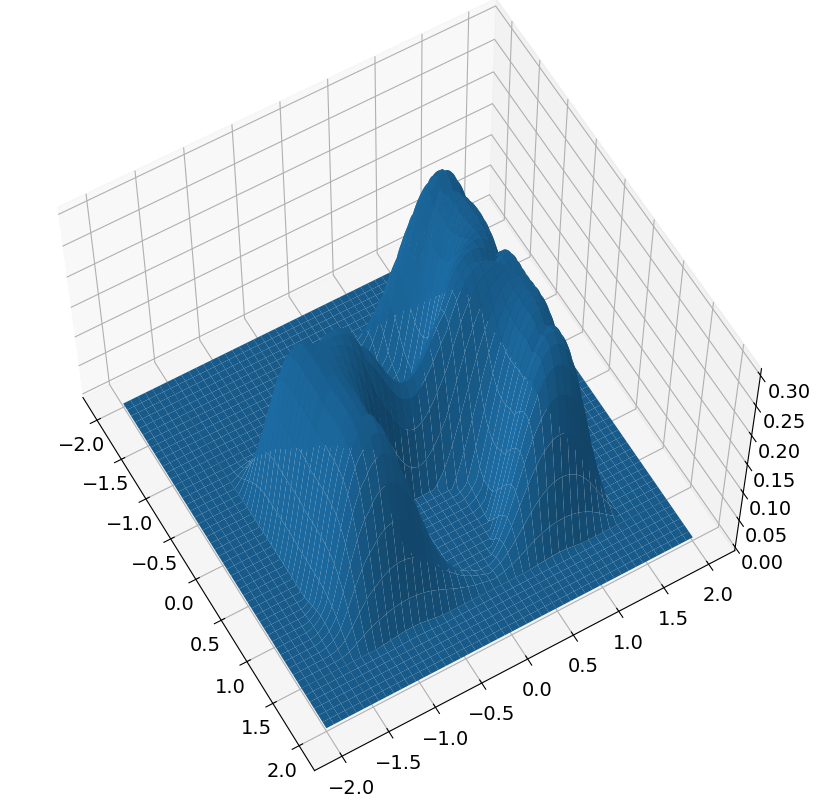

target: [-1.47535934  1.75831433]
target in goto [-1.47535934  1.75831433]
position is [ 0.45686432 -1.3901841 ]
h is 0.05000000000000007
start time is 1000


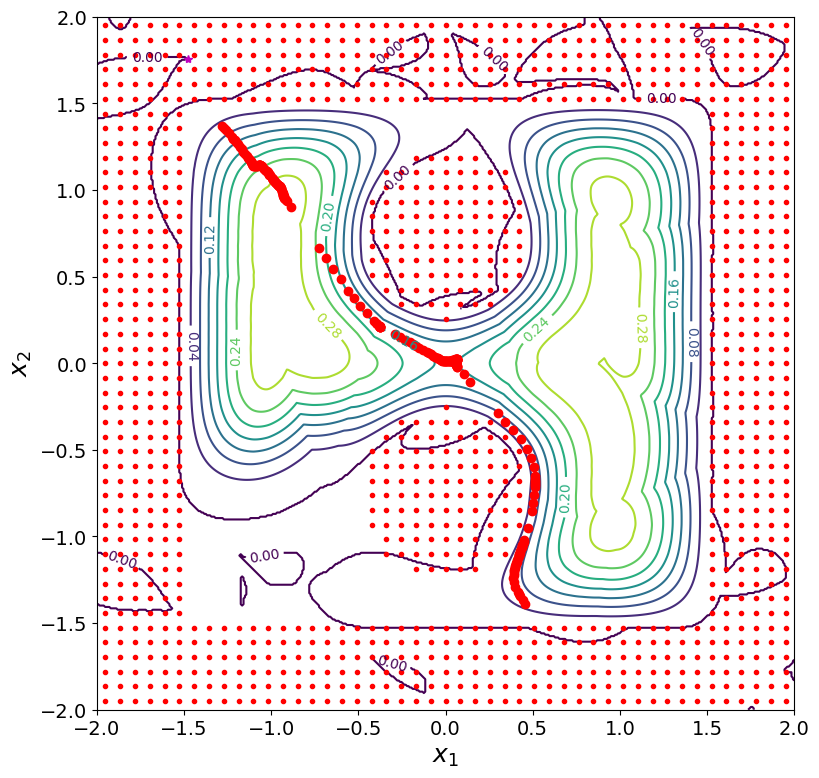

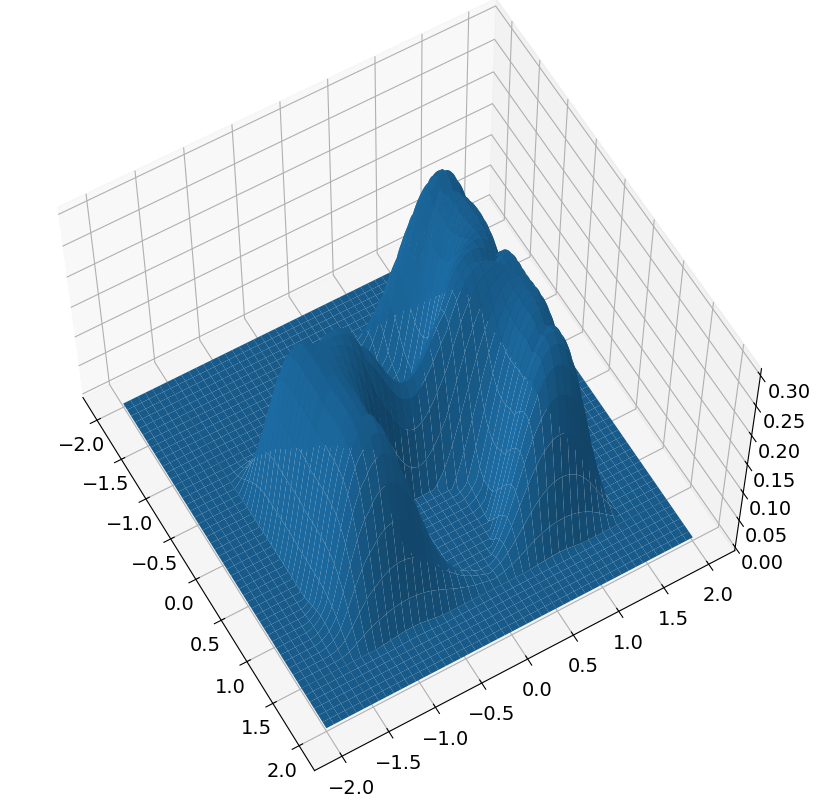

new position is [-1.28186726  1.37189374]
h is now 0.04999999999999994
new time is 1050
dx: 3.2637802465859918


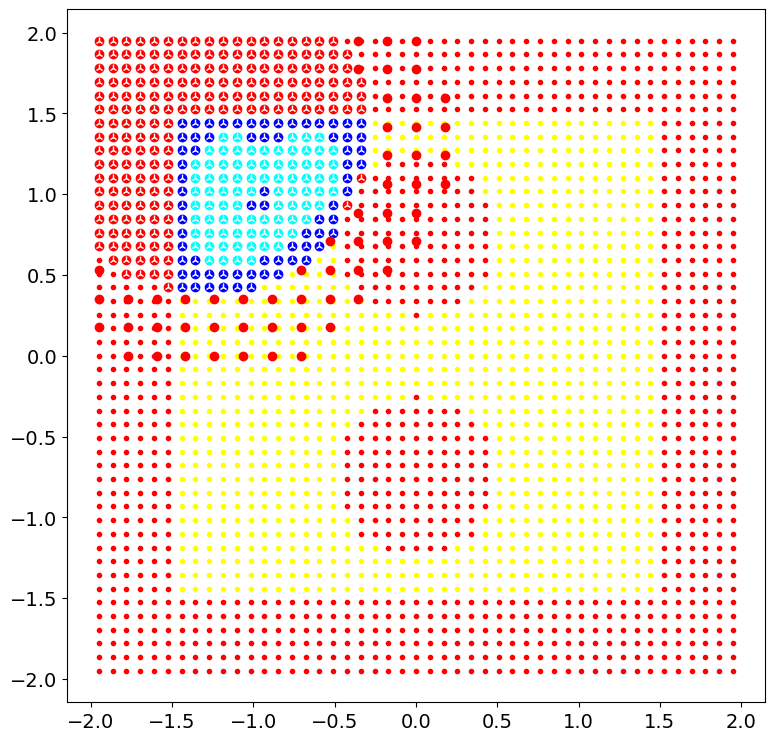

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          341     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.24450D+05    |proj g|=  1.07819D+02


 This problem is unconstrained.



At iterate   50    f=  4.97558D+02    |proj g|=  1.50659D+00

At iterate  100    f=  4.97486D+02    |proj g|=  9.36032D-01

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(341, 2)
numc 341
cmax before 441
numc <= self.cmax
Cnew shape before (341, 2)
Cnew shape after (341, 2)
theta shape before (341,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

    

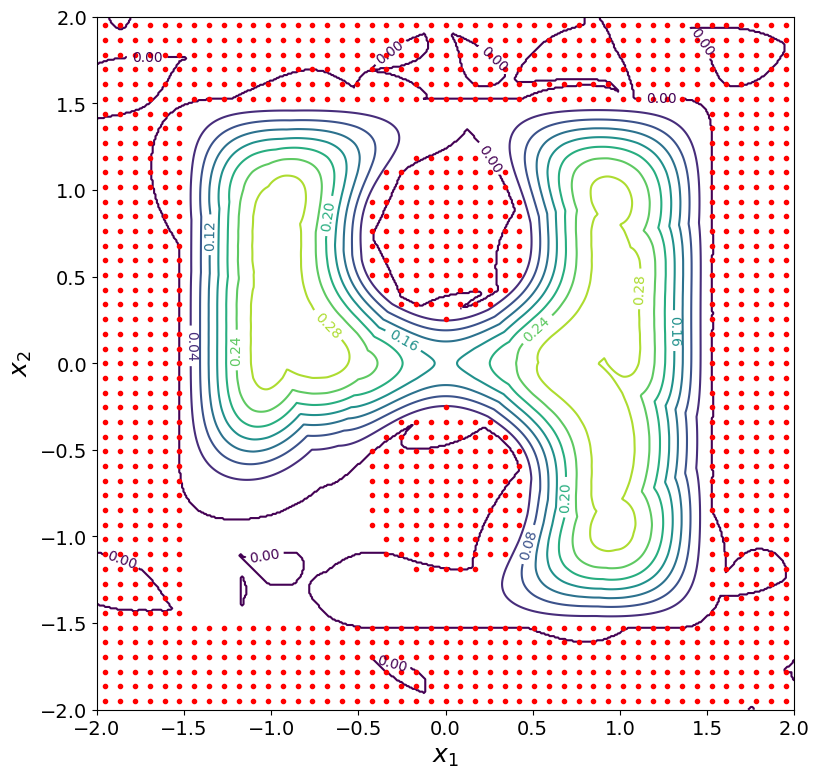

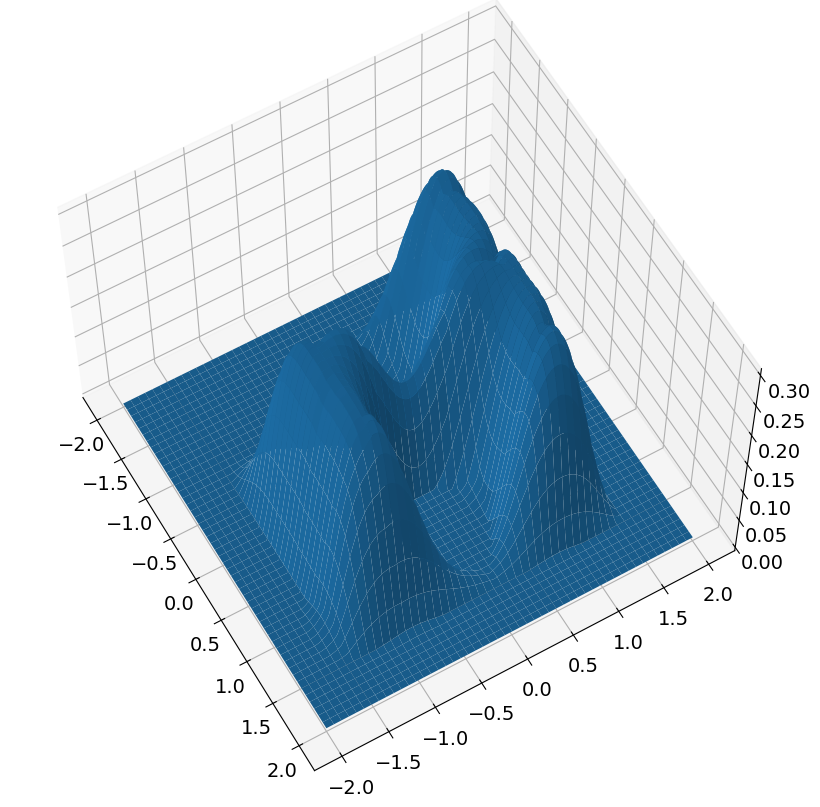

target: [1.1293735  1.84397032]
target in goto [1.1293735  1.84397032]
position is [-1.28186726  1.37189374]
h is 0.059427706992164236
start time is 1050


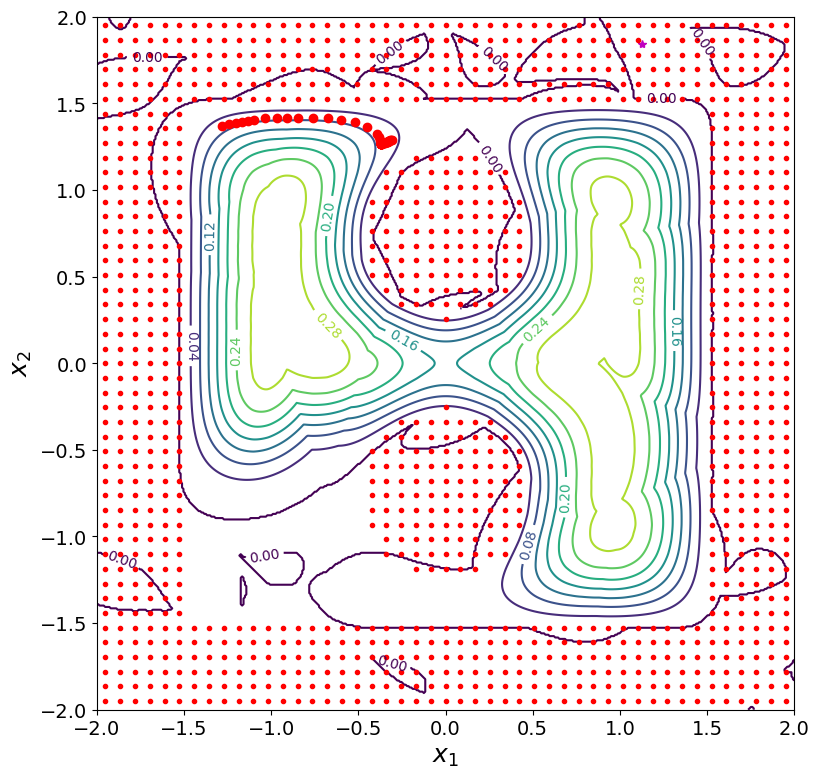

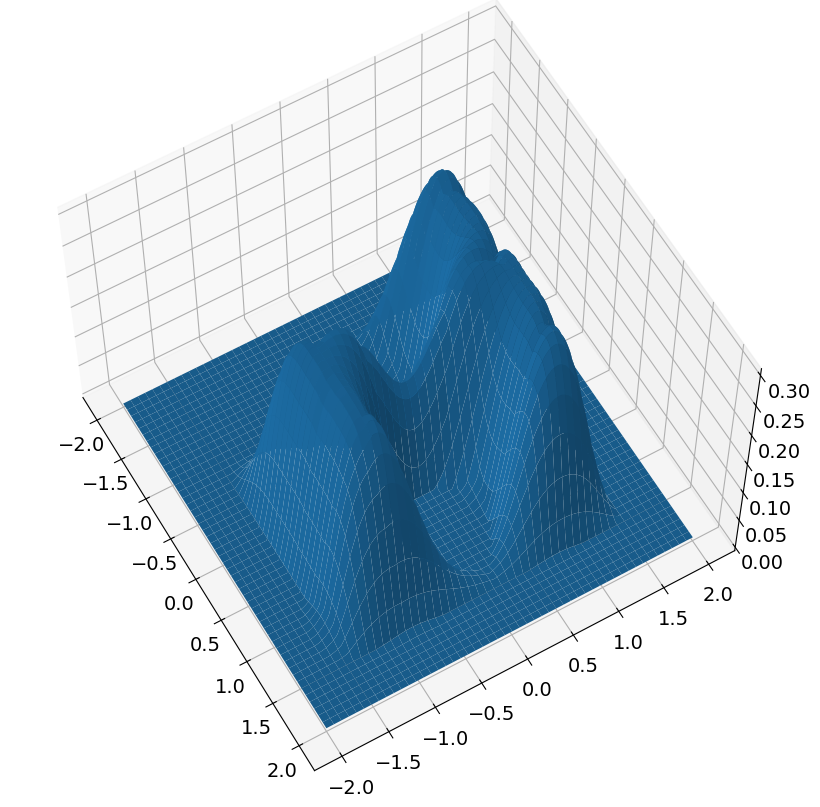

new position is [-0.30810229  1.29001864]
h is now 0.05000000000000001
new time is 1100
dx: 0.9772009729491345


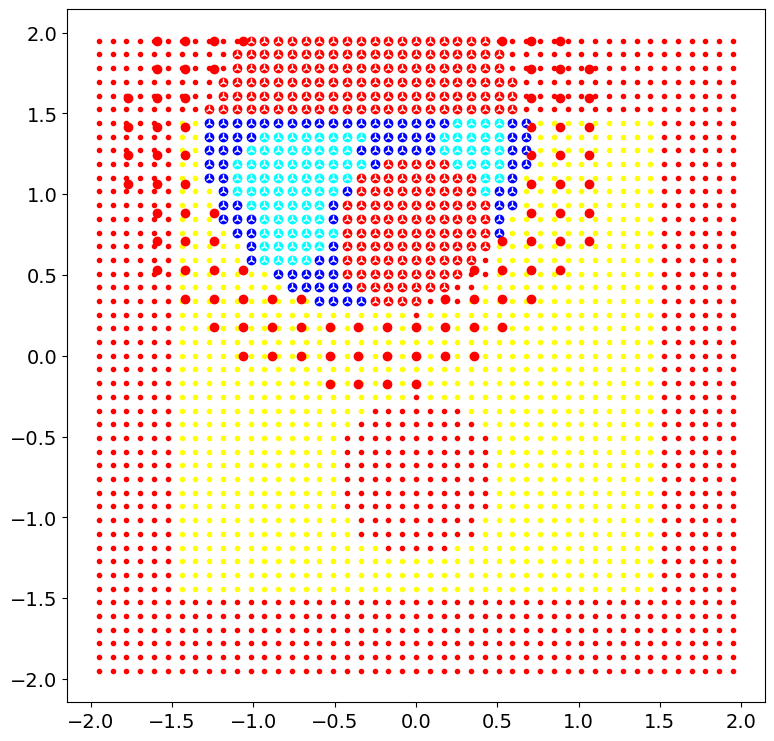

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          398     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.27333D+05    |proj g|=  1.05417D+02


 This problem is unconstrained.



At iterate   50    f=  5.99725D+02    |proj g|=  1.59663D+00

At iterate  100    f=  5.99578D+02    |proj g|=  1.81063D+00

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(398, 2)
numc 398
cmax before 441
numc <= self.cmax
Cnew shape before (398, 2)
Cnew shape after (398, 2)
theta shape before (398,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final fu

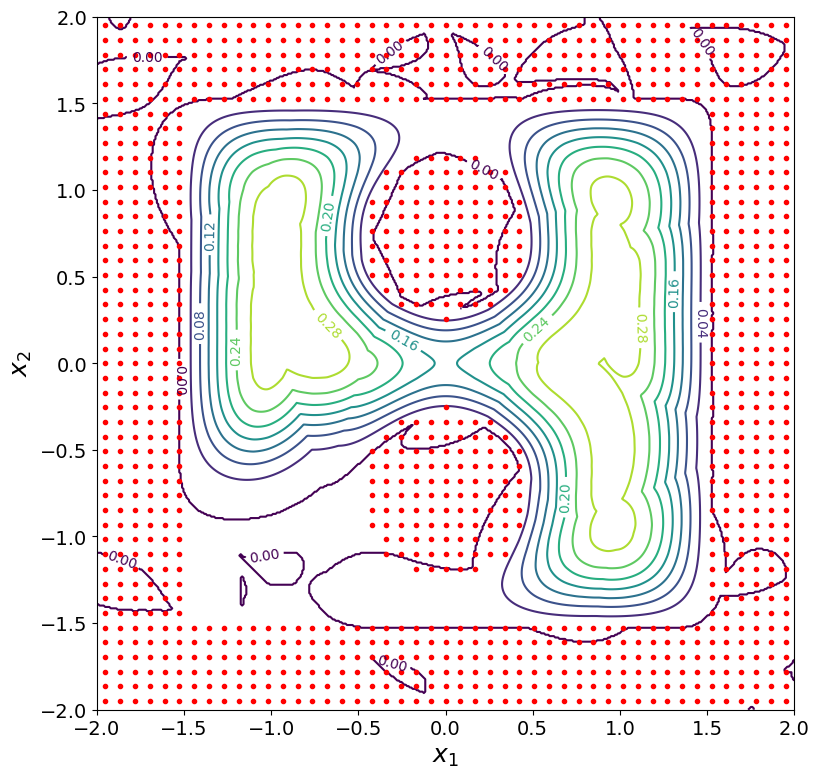

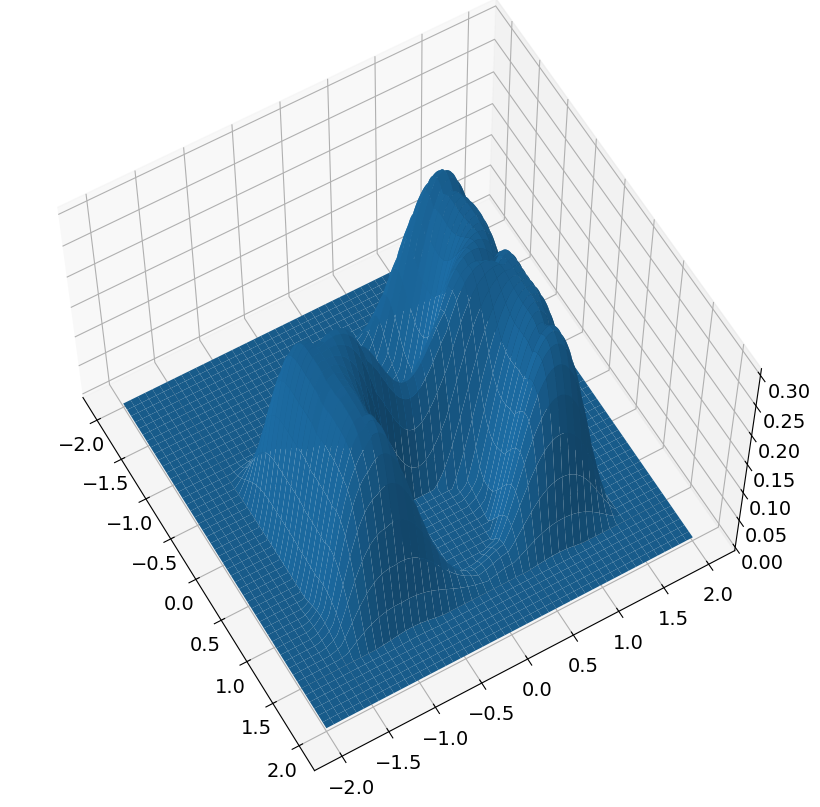

target: [-1.58091694 -0.73632865]
target in goto [-1.58091694 -0.73632865]
position is [-0.30810229  1.29001864]
h is 0.05000000000000001
start time is 1100


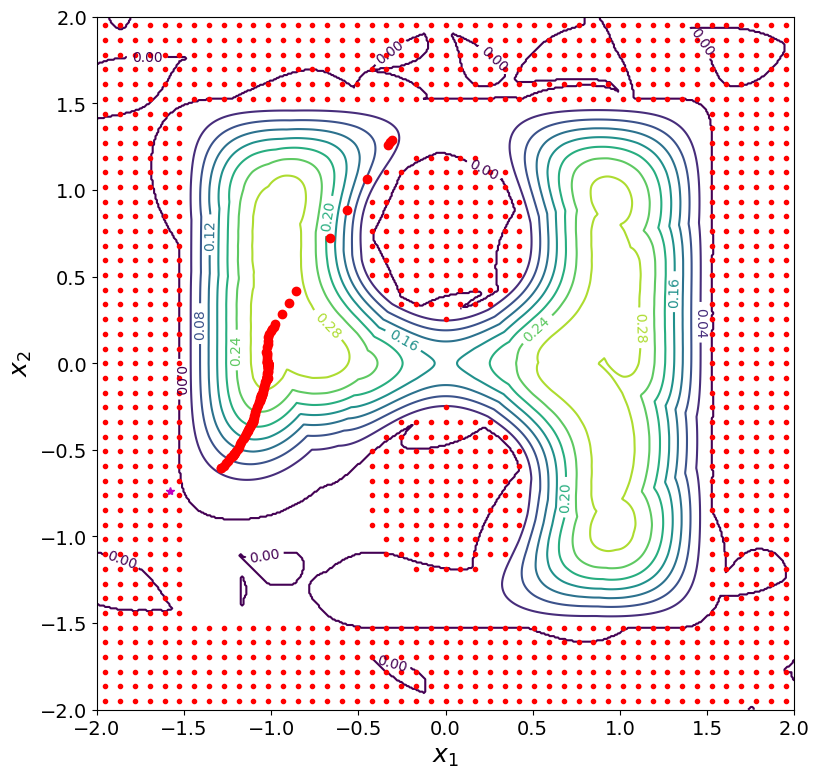

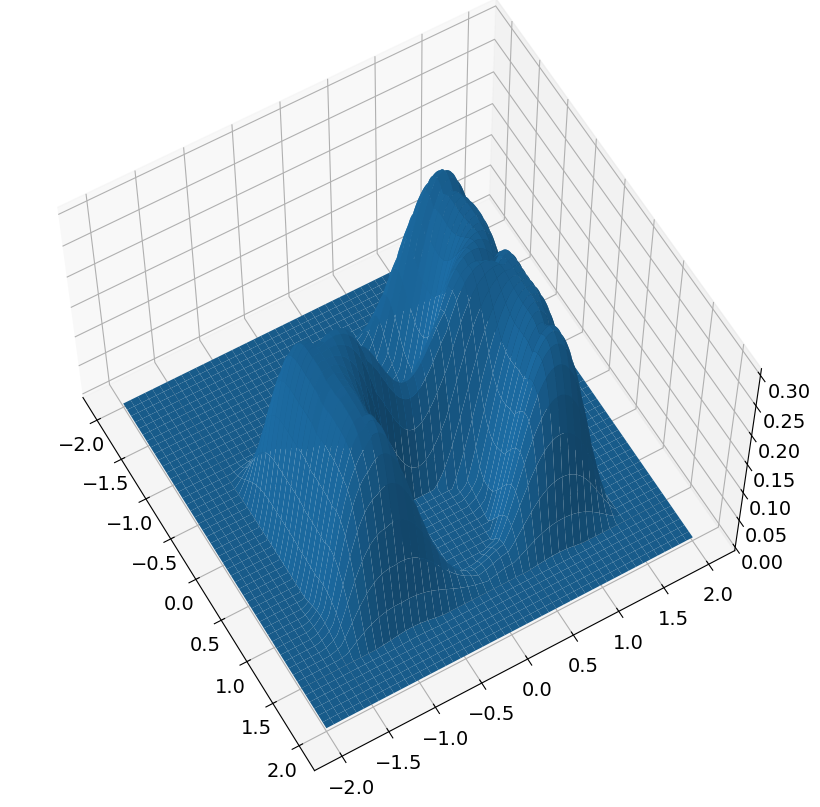

new position is [-1.28796407 -0.60728055]
h is now 0.05000000000000003
new time is 1150
dx: 2.1353859871631427


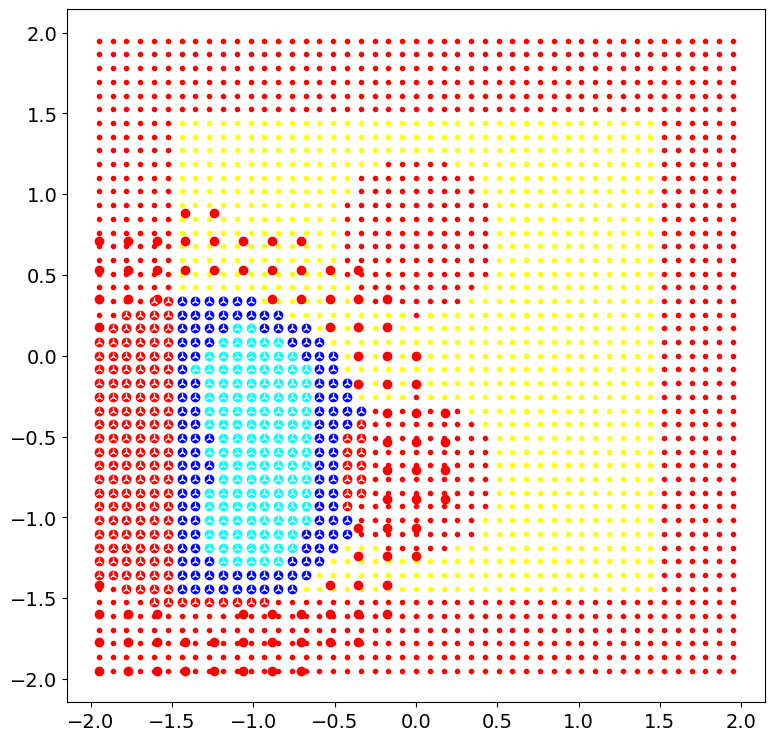

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          396     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.42212D+05    |proj g|=  1.08418D+02


 This problem is unconstrained.



At iterate   50    f=  6.48479D+02    |proj g|=  1.05511D+00

At iterate  100    f=  6.48377D+02    |proj g|=  9.36892D-01

At iterate  150    f=  6.48362D+02    |proj g|=  1.15960D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  396    193    325      1     0     0   9.101D-01   6.484D+02
  F =   648.35342087452432     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(396, 2)
numc 396
cmax before 441
numc <= se

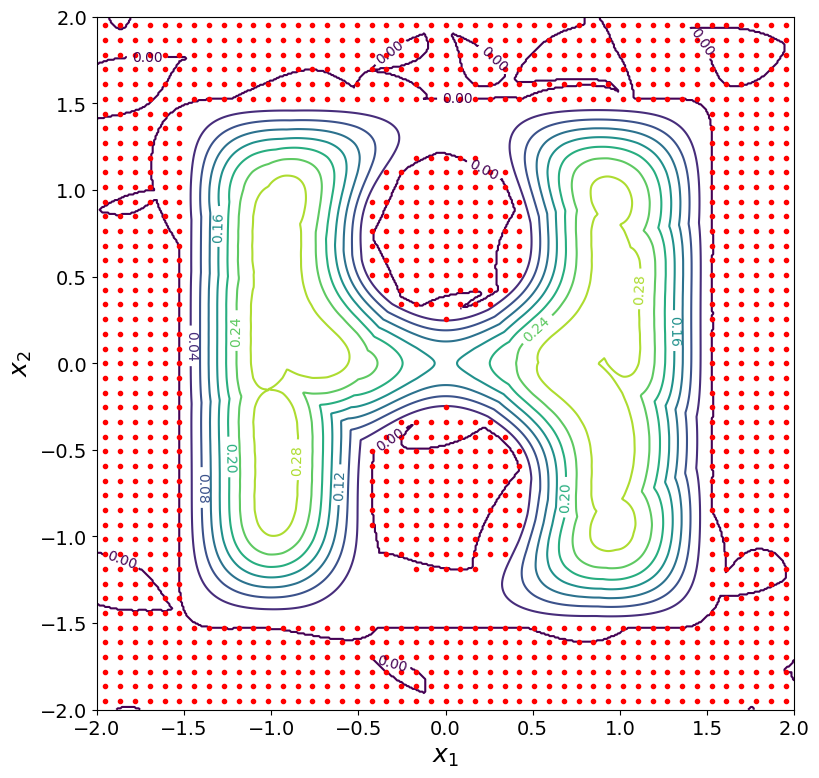

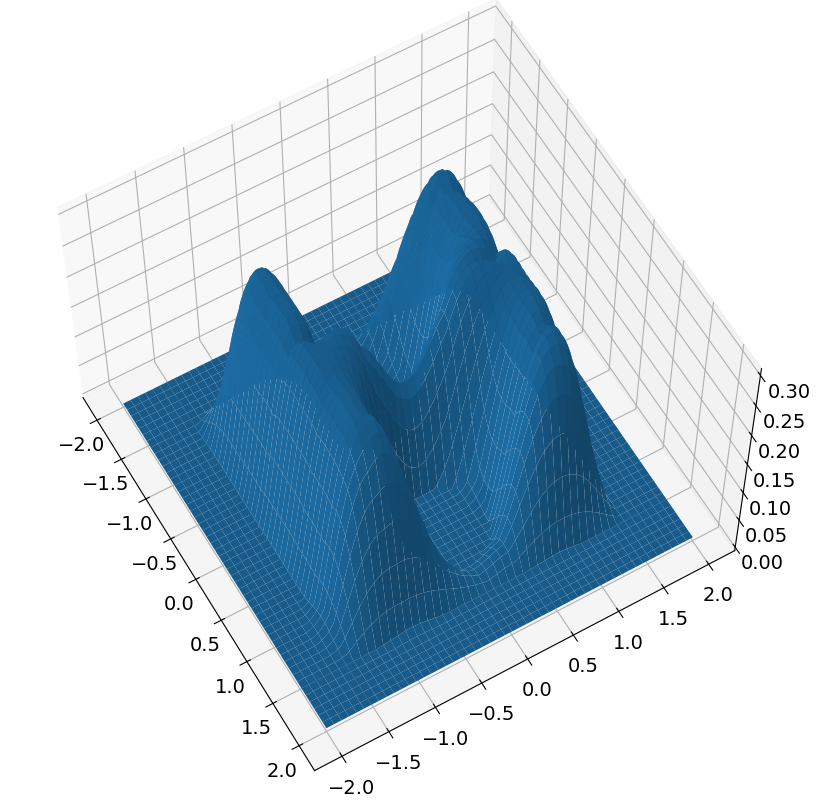

target: [-1.92438003 -1.91559258]
target in goto [-1.92438003 -1.91559258]
position is [-1.28796407 -0.60728055]
h is 0.16545383513067788
start time is 1150


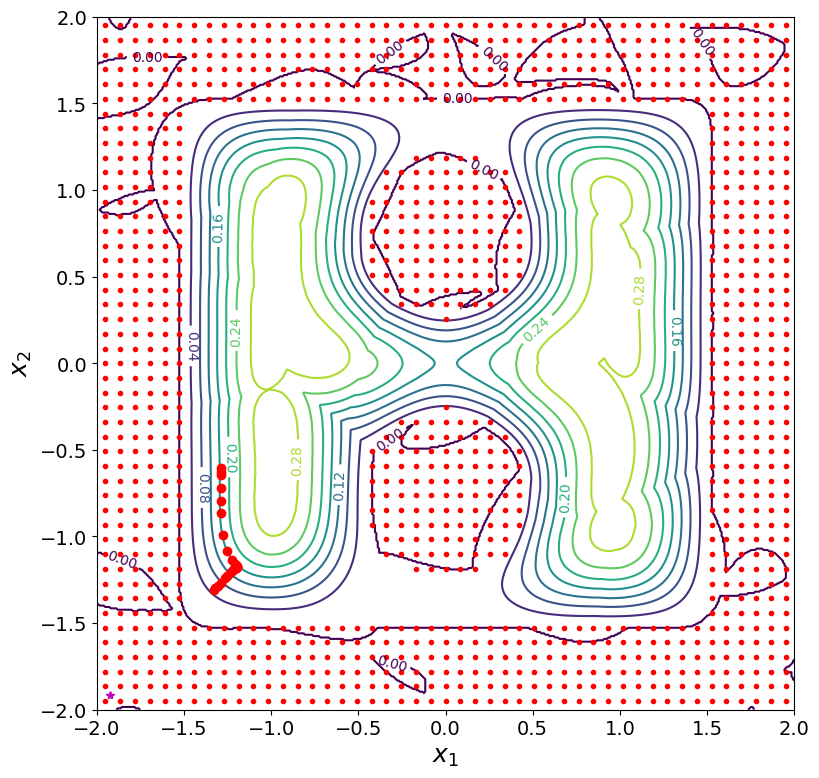

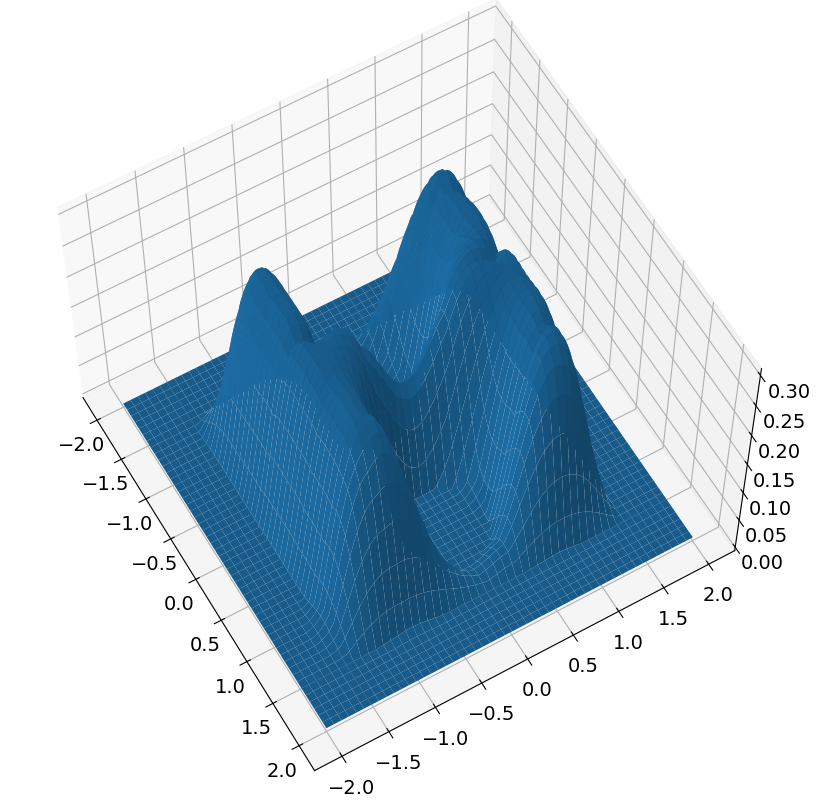

new position is [-1.32742973 -1.30695688]
h is now 0.04999999999999999
new time is 1200
dx: 0.7007884940934554


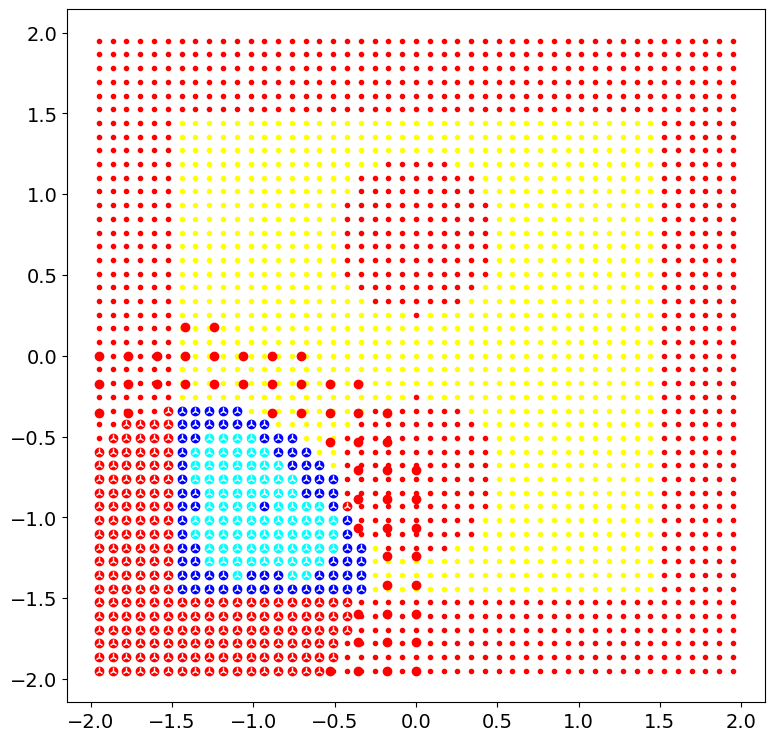

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          347     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.31193D+05    |proj g|=  1.12434D+02


 This problem is unconstrained.



At iterate   50    f=  4.85594D+02    |proj g|=  8.89620D-01

At iterate  100    f=  4.85515D+02    |proj g|=  7.15538D-01

At iterate  150    f=  4.85497D+02    |proj g|=  1.00387D+00

At iterate  200    f=  4.85486D+02    |proj g|=  1.46483D+00

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(347, 2)
numc 347
cmax before 441
numc <= self.cmax
Cnew shape before (347, 2)
Cnew shape after (347, 2)
theta shape before (347,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  

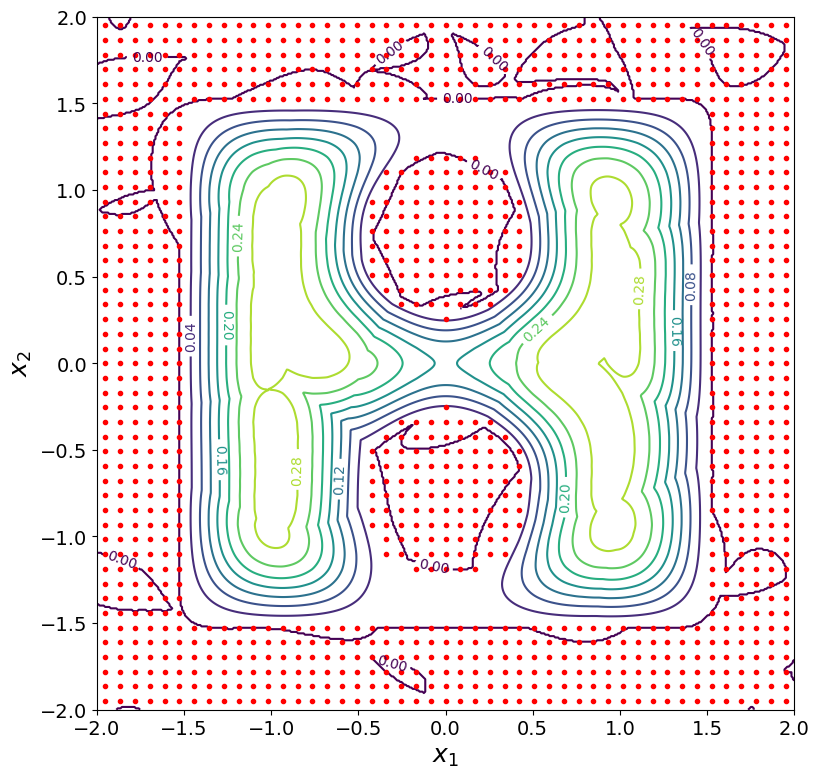

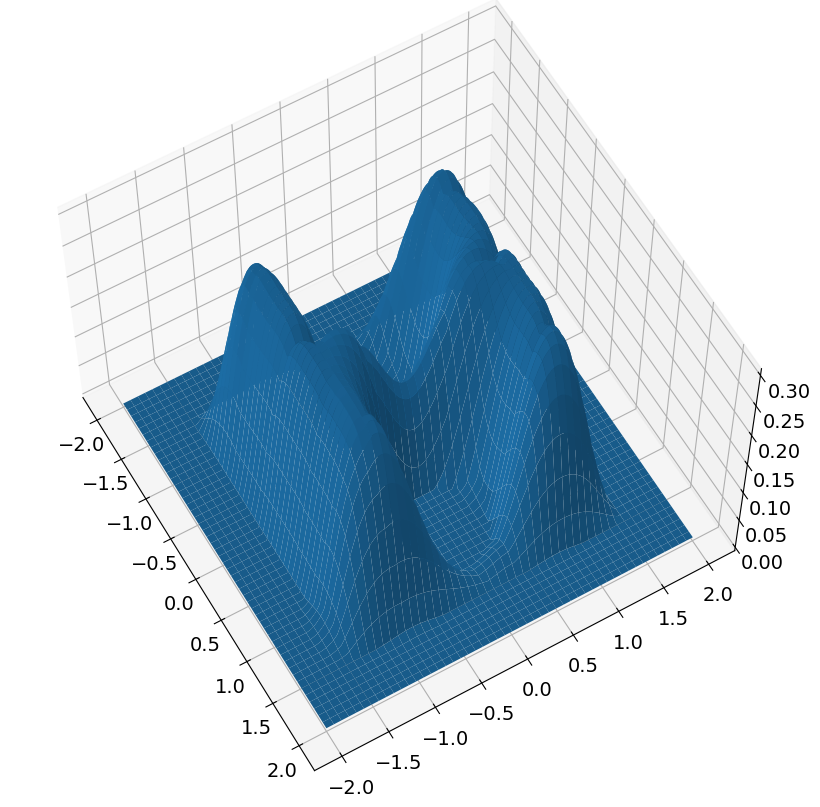

target: [-0.16280012 -0.65921163]
target in goto [-0.16280012 -0.65921163]
position is [-1.32742973 -1.30695688]
h is 0.0666299242729402
start time is 1200


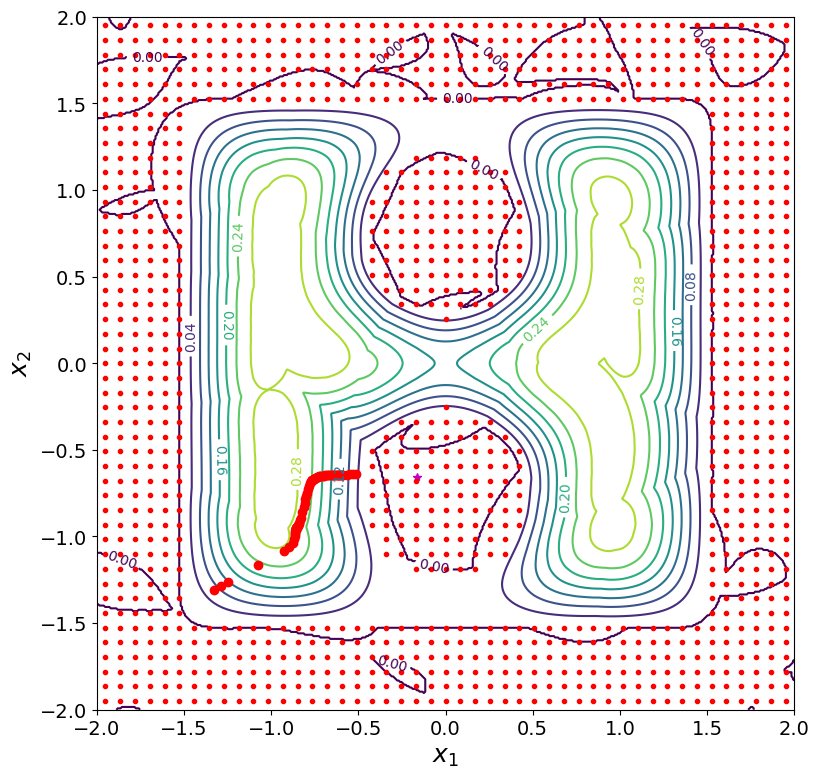

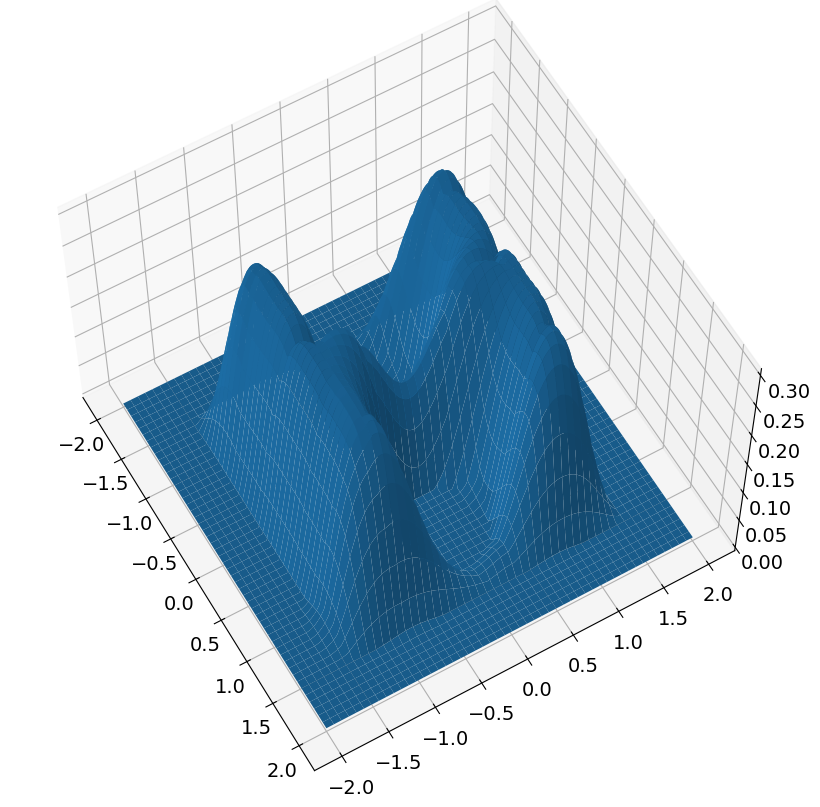

new position is [-0.51509165 -0.64096318]
h is now 0.04999999999999999
new time is 1250
dx: 1.0504478943119375


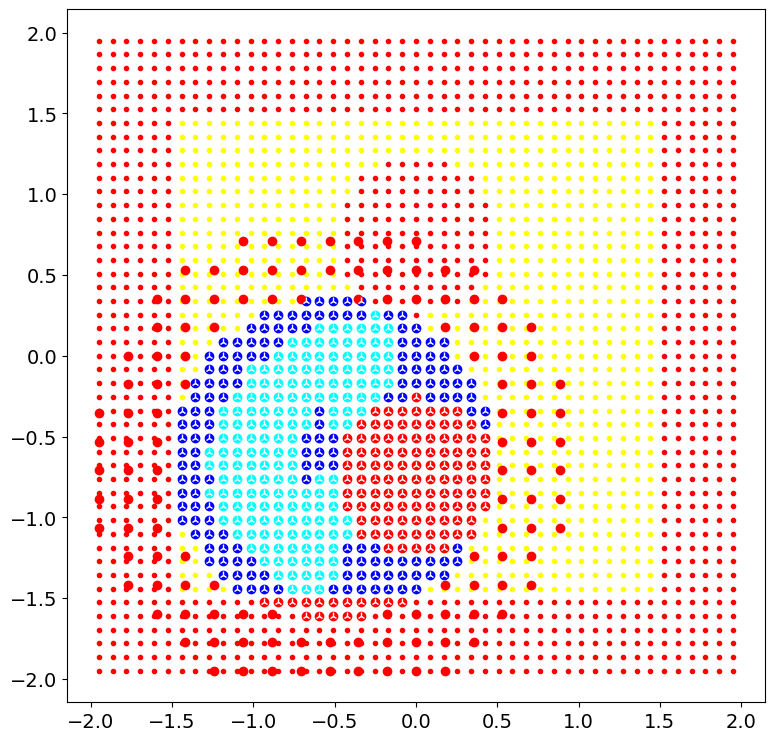

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          437     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  9.36354D+05    |proj g|=  1.05192D+02


 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  437     44     97      1     0     0   8.943D-01   8.966D+02
  F =   896.59007680032778     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(437, 2)
numc 437
cmax before 441
numc <= self.cmax
Cnew shape before (437, 2)
Cnew shape after (437, 2)
theta shape before (437,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(44


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


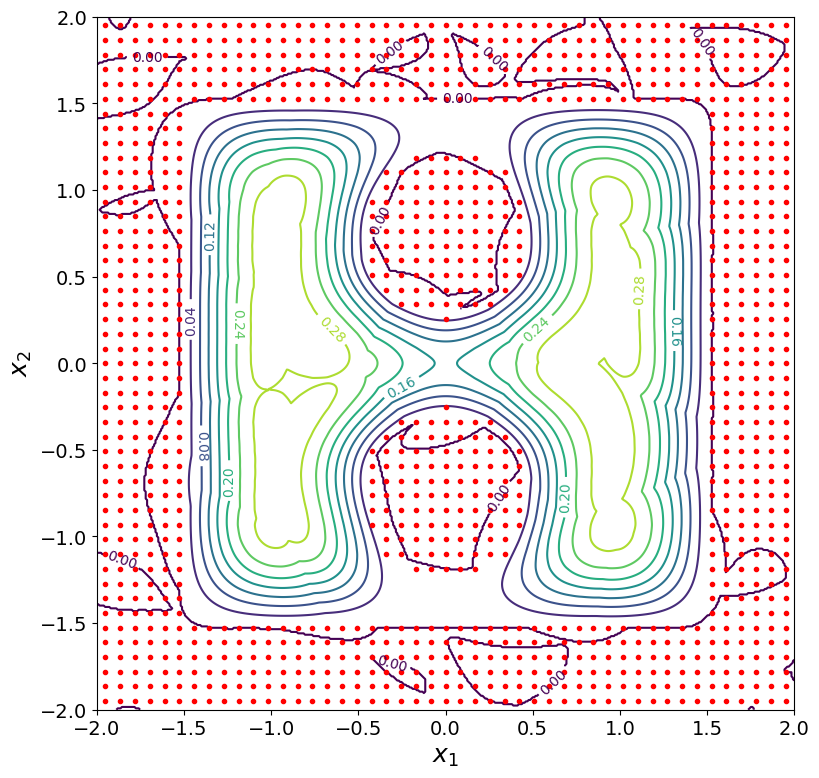

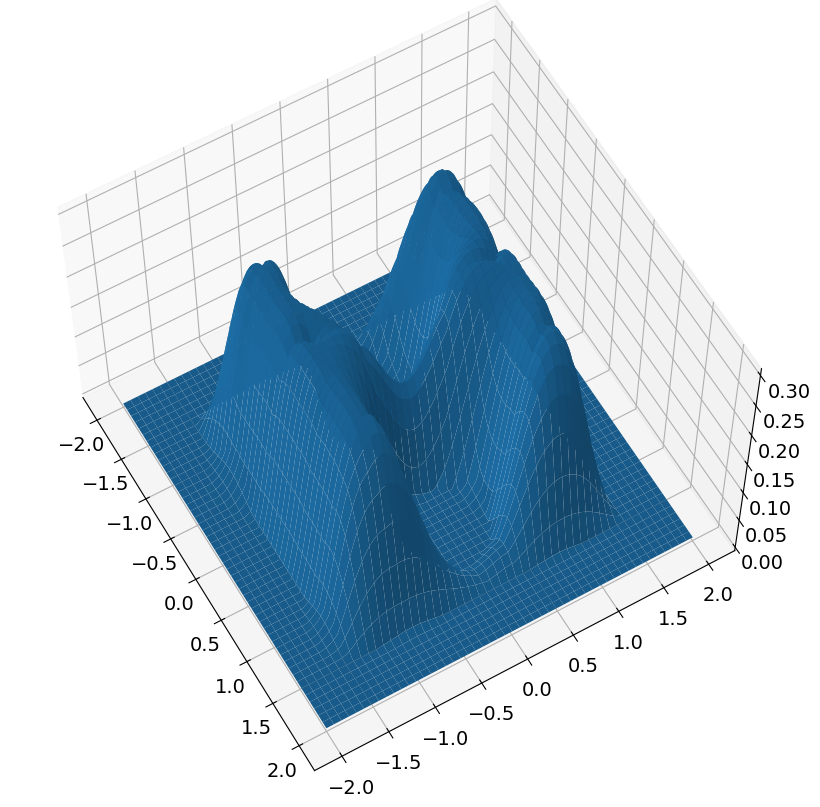

target: [-1.67564955 -1.77087065]
target in goto [-1.67564955 -1.77087065]
position is [-0.51509165 -0.64096318]
h is 0.06344383609332194
start time is 1250


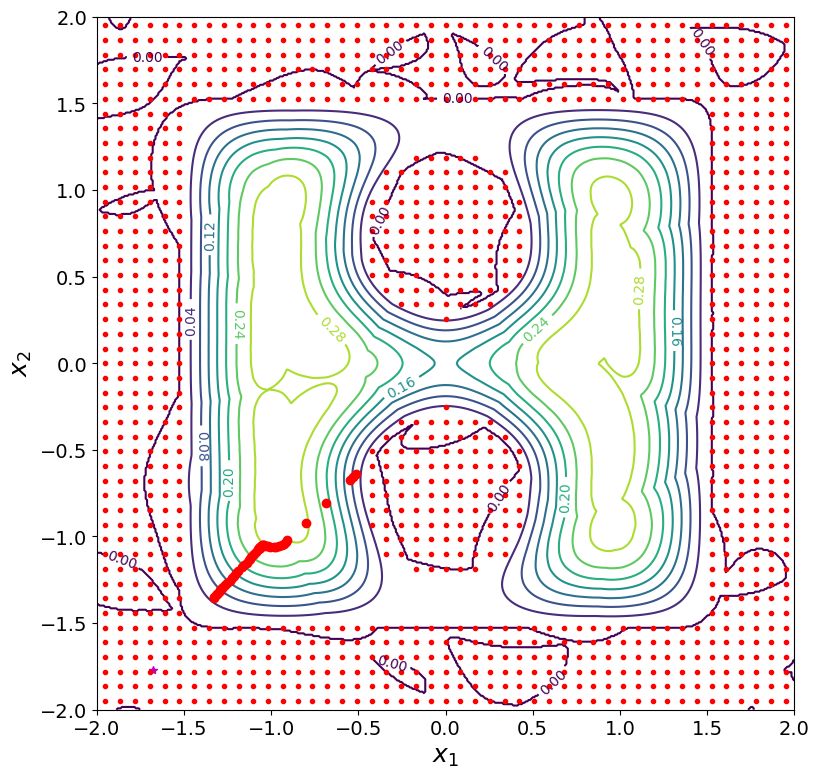

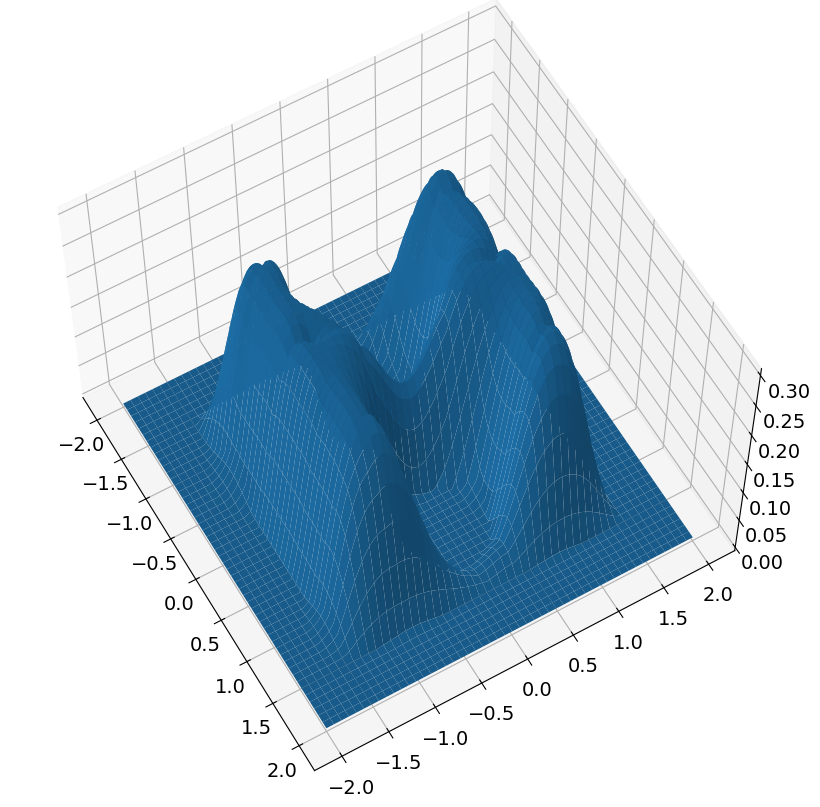

new position is [-1.33018223 -1.35249494]
h is now 0.05000000000000003
new time is 1300
dx: 1.0819658471015132


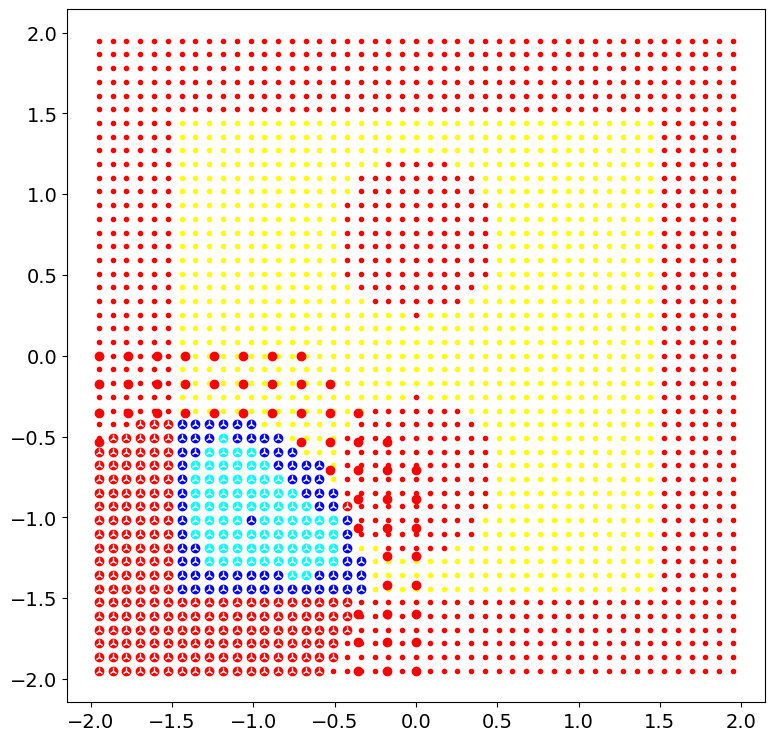

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          335     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.04803D+05    |proj g|=  1.10534D+02


 This problem is unconstrained.



At iterate   50    f=  4.65394D+02    |proj g|=  1.93780D+00

At iterate  100    f=  4.65317D+02    |proj g|=  4.91589D-01

centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(335, 2)
numc 335
cmax before 441
numc <= self.cmax
Cnew shape before (335, 2)
Cnew shape after (335, 2)
theta shape before (335,)
theta_shape after (441,)
cmax after 441
centers shape after
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Ca

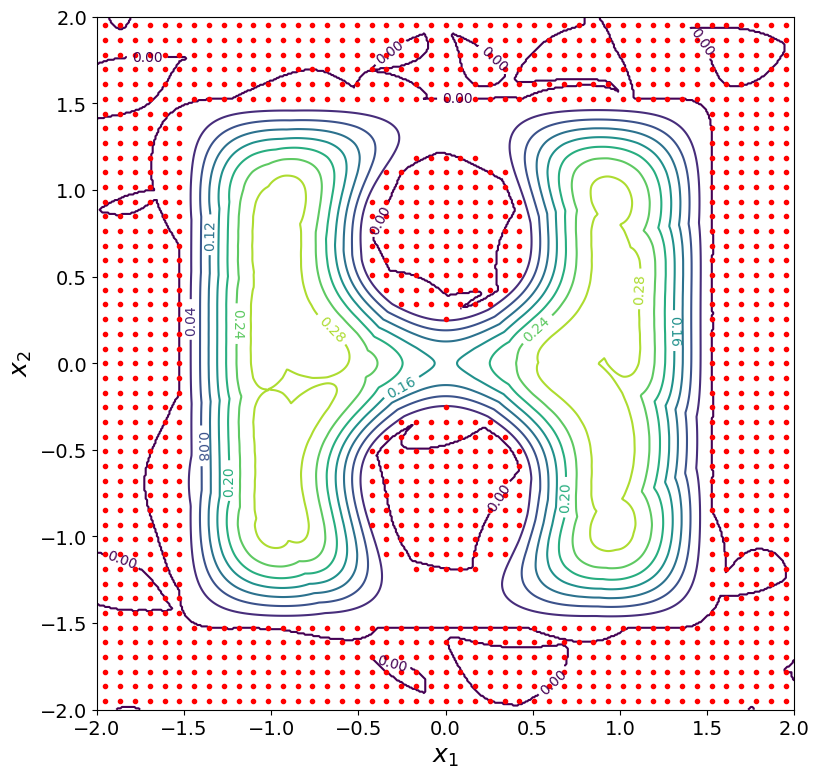

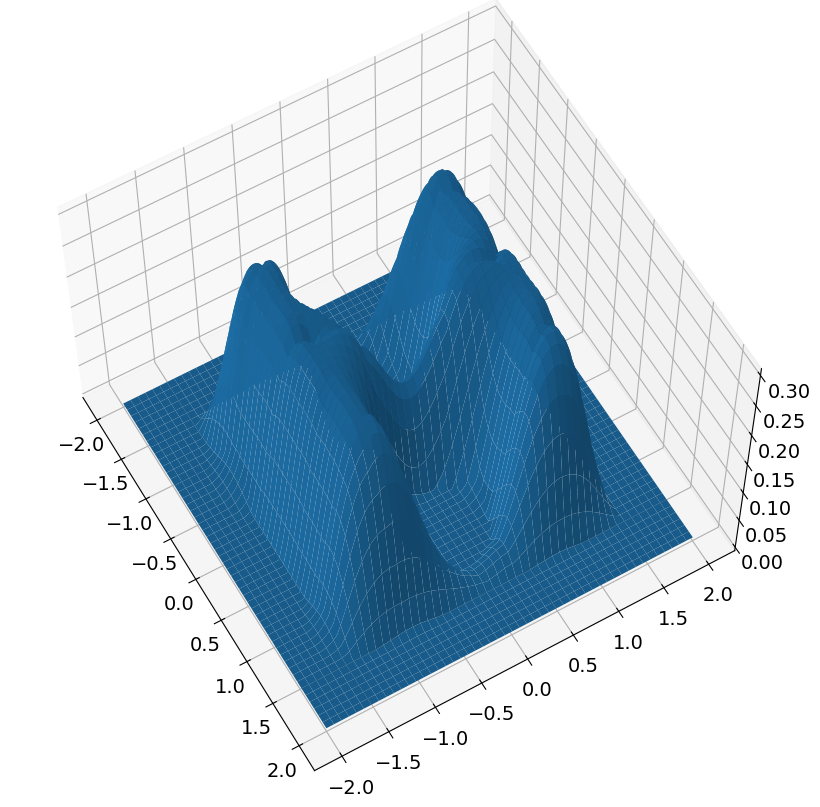

target: [-0.13336786  1.01745863]
target in goto [-0.13336786  1.01745863]
position is [-1.33018223 -1.35249494]
h is 0.05000000000000003
start time is 1300


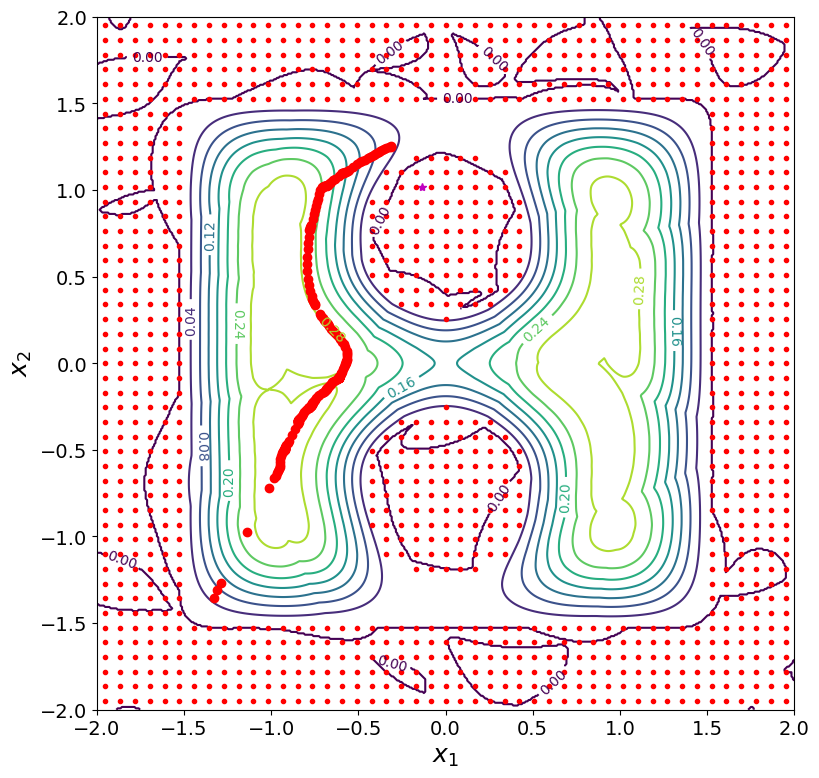

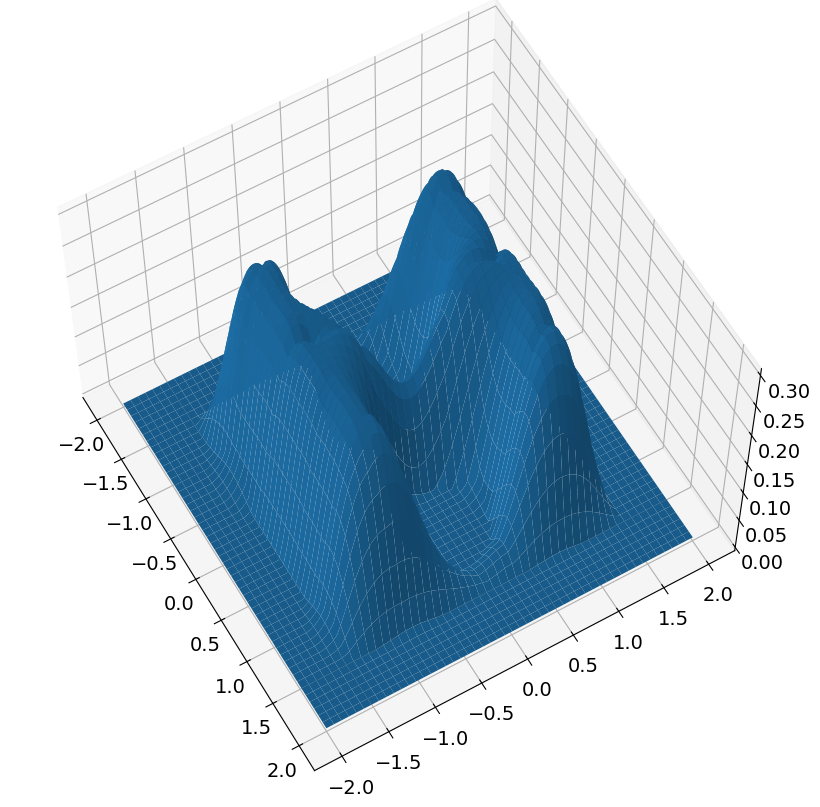

new position is [-0.31224213  1.25114489]
h is now 0.05
new time is 1350
dx: 2.795557619155639


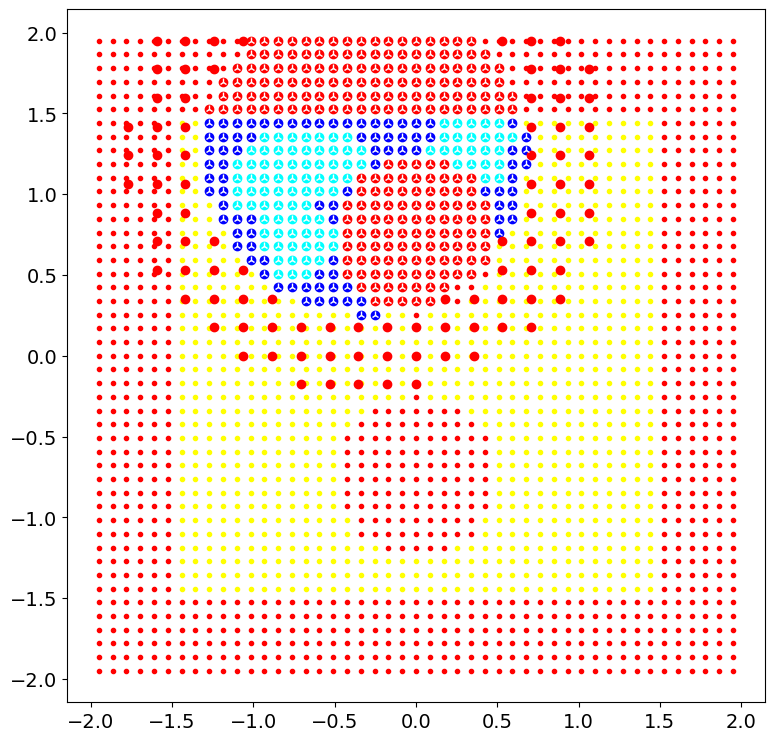

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          404     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.43568D+05    |proj g|=  1.06104D+02


 This problem is unconstrained.



At iterate   50    f=  6.36729D+02    |proj g|=  1.98982D+00

At iterate  100    f=  6.36557D+02    |proj g|=  9.72234D-01

At iterate  150    f=  6.36536D+02    |proj g|=  8.48496D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  404    172    243      1     0     0   9.250D-01   6.365D+02
  F =   636.53472147380876     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(404, 2)

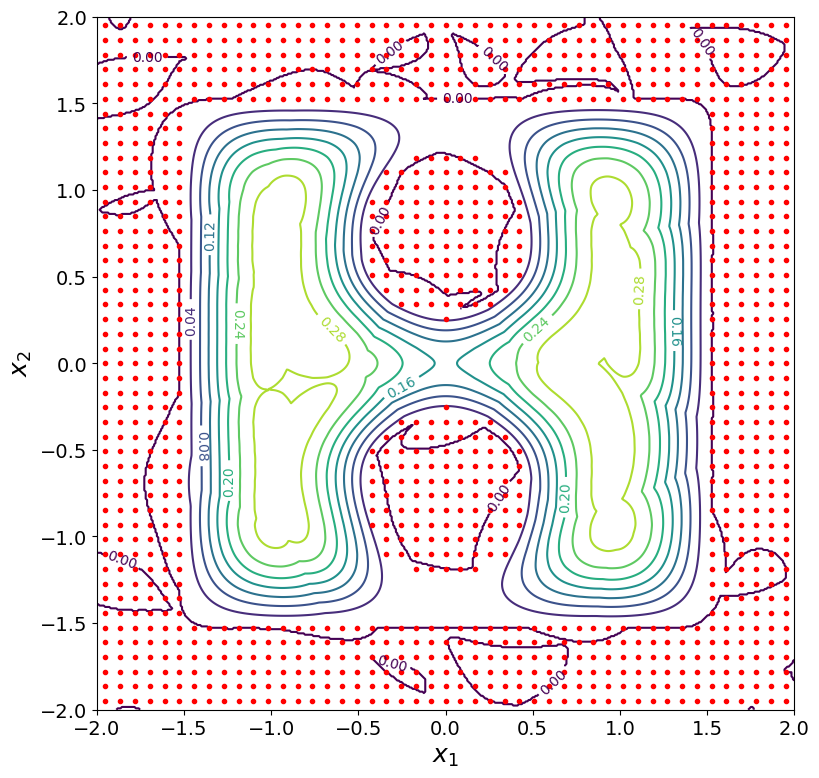

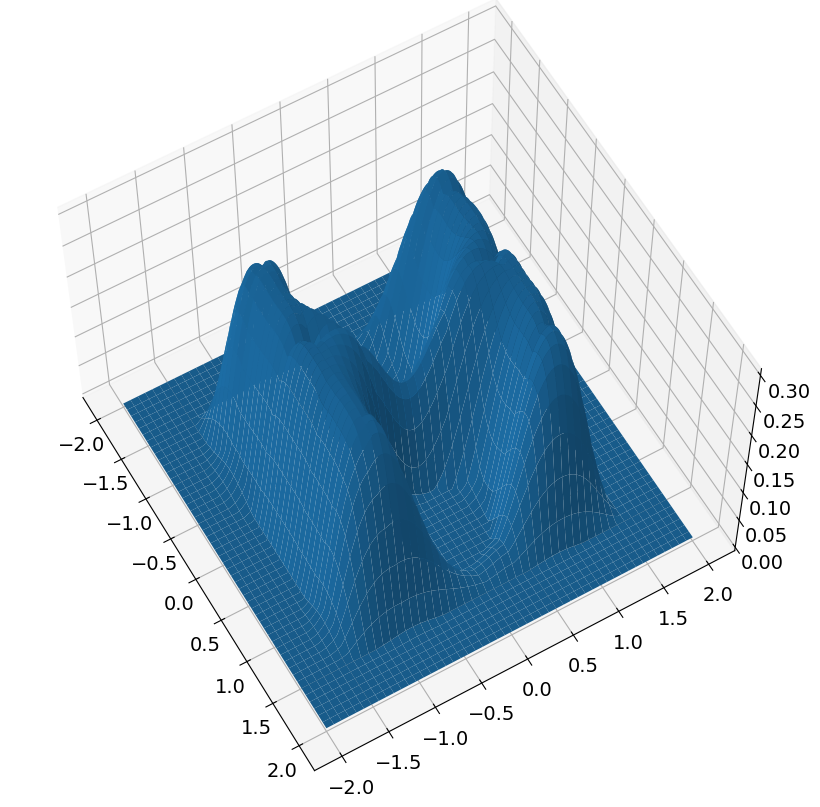

target: [-1.72592017 -1.14574469]
target in goto [-1.72592017 -1.14574469]
position is [-0.31224213  1.25114489]
h is 0.05
start time is 1350


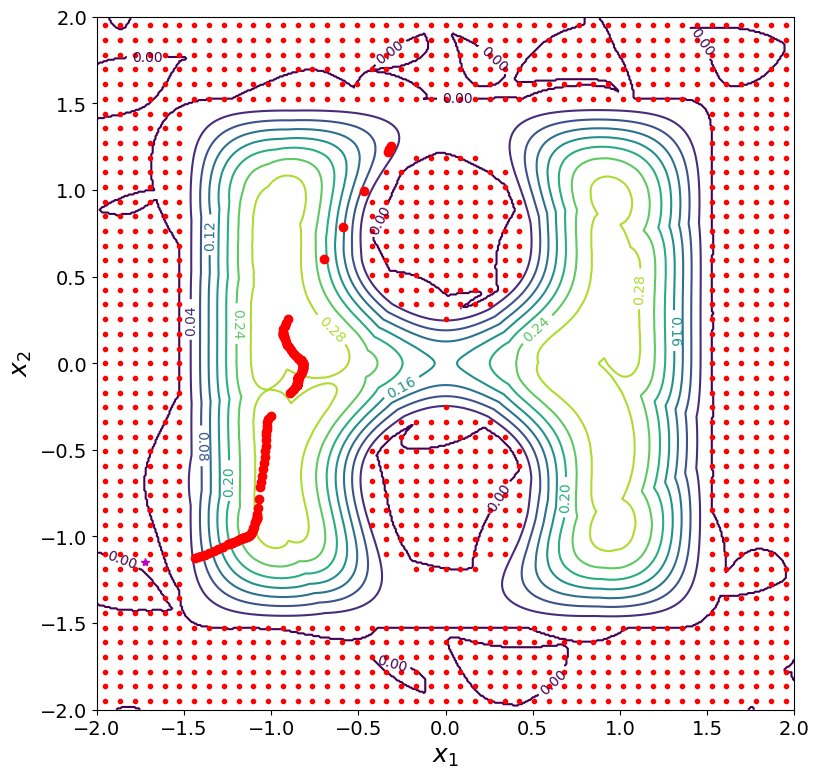

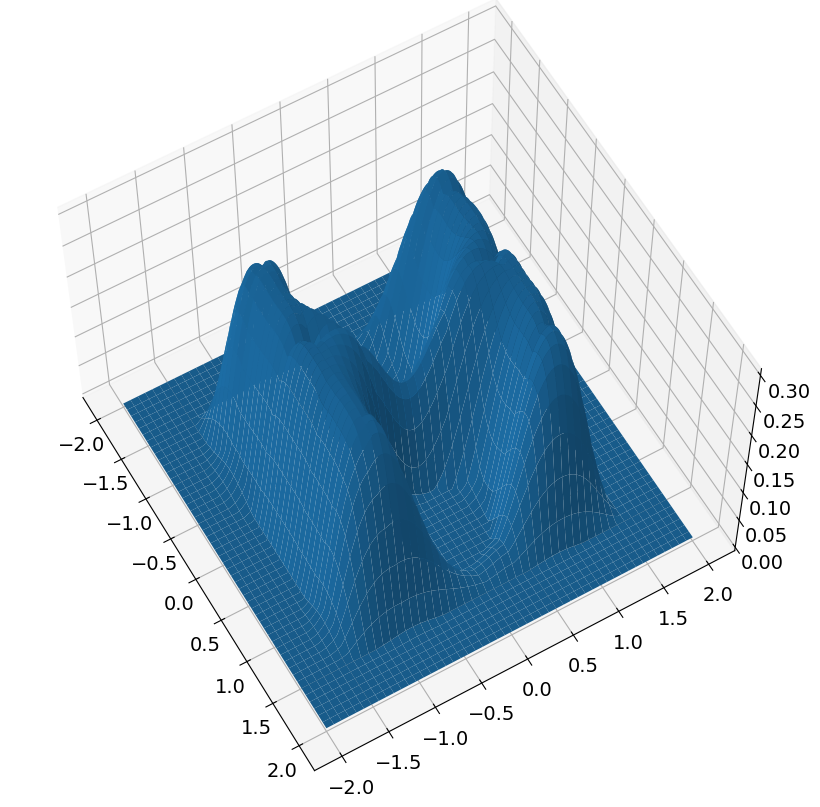

new position is [-1.43389211 -1.12140749]
h is now 0.049999999999999975
new time is 1400
dx: 2.6243291506709476


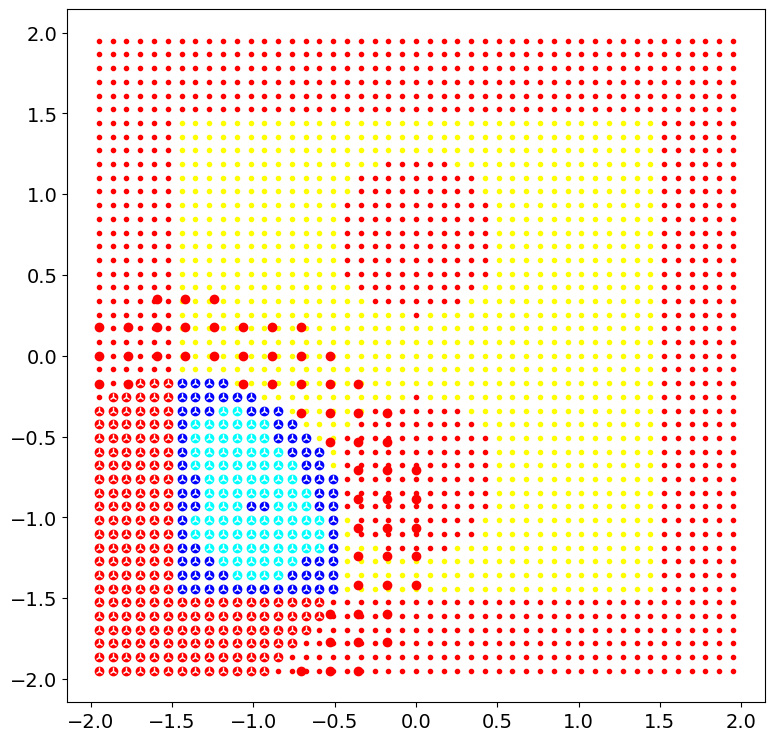

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          351     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.33632D+05    |proj g|=  1.07325D+02


 This problem is unconstrained.



At iterate   50    f=  5.08283D+02    |proj g|=  1.64351D+00

At iterate  100    f=  5.08148D+02    |proj g|=  5.03586D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  351    125    211      1     0     0   1.711D+00   5.081D+02
  F =   508.14366800982702     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(351, 2)
numc 351
cmax before 441
numc <= self.cmax
Cnew shap

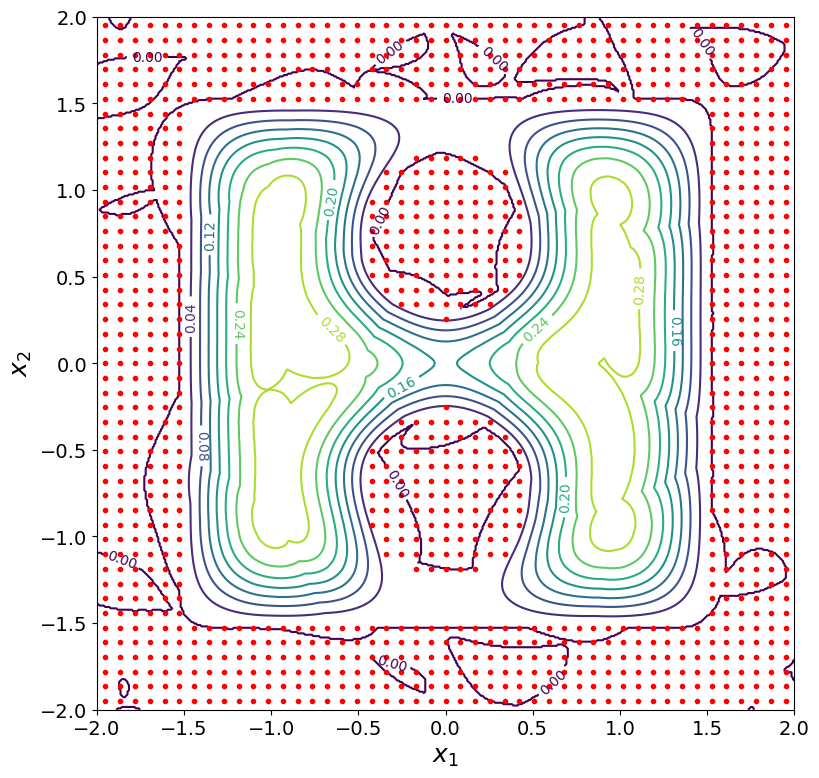

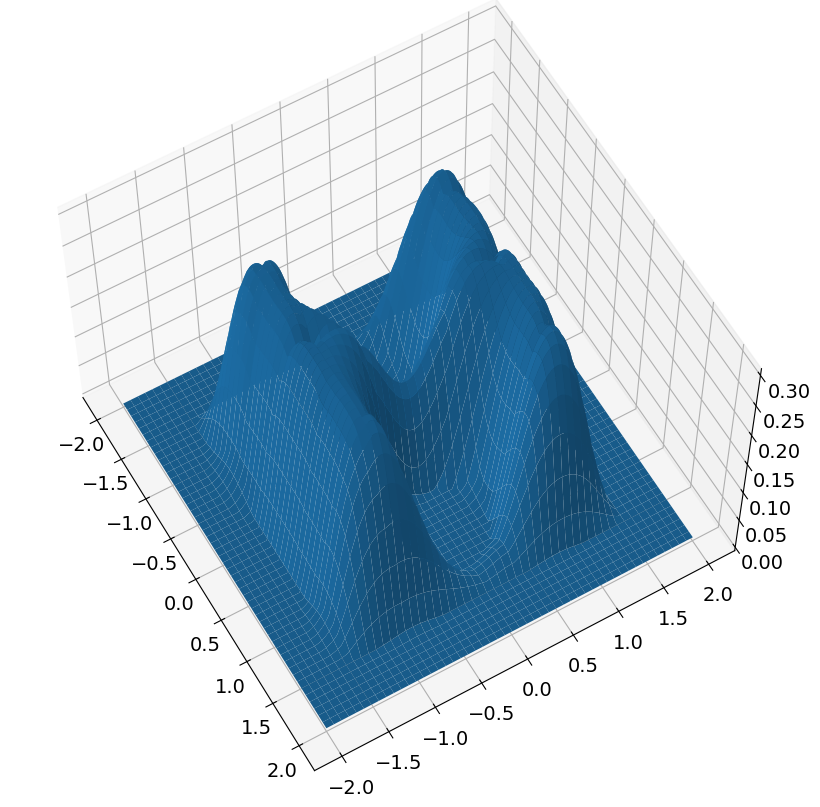

target: [-1.28024371  1.62591774]
target in goto [-1.28024371  1.62591774]
position is [-1.43389211 -1.12140749]
h is 0.049999999999999975
start time is 1400


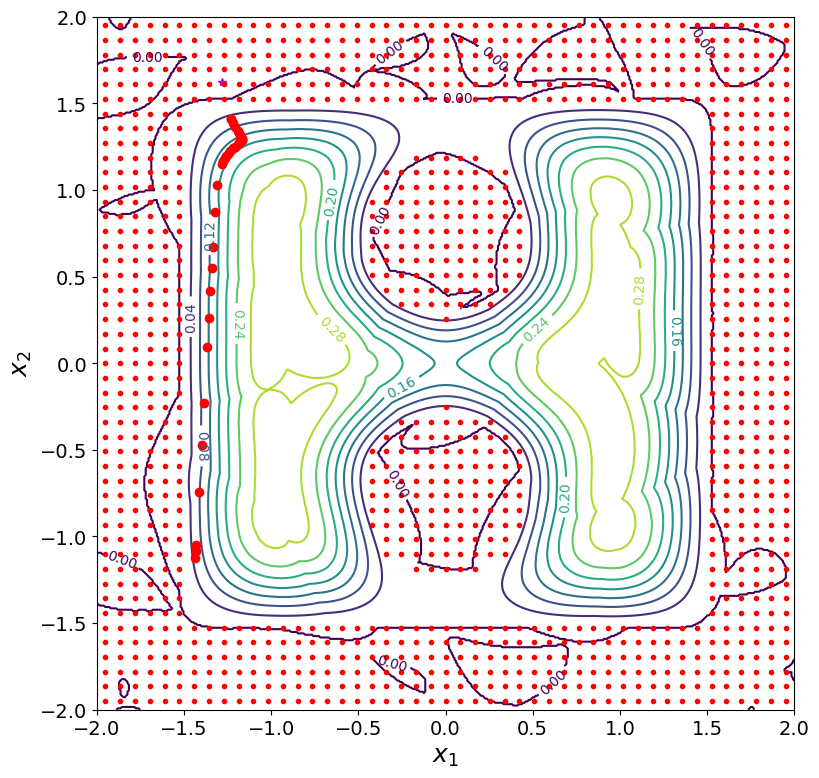

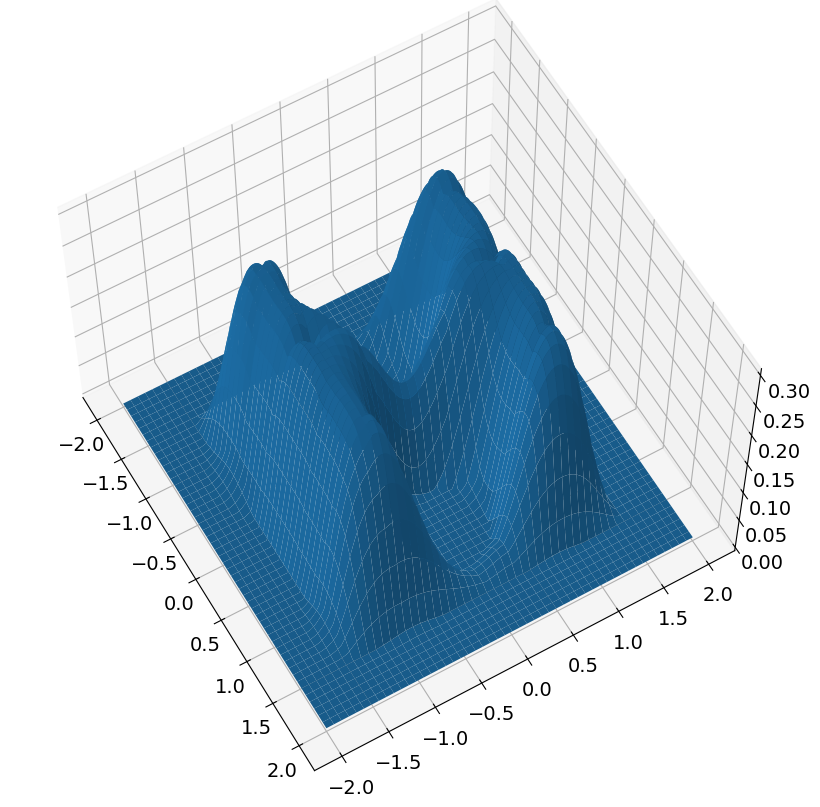

new position is [-1.23267843  1.4116806 ]
h is now 0.05000000000000003
new time is 1450
dx: 2.541067147184507


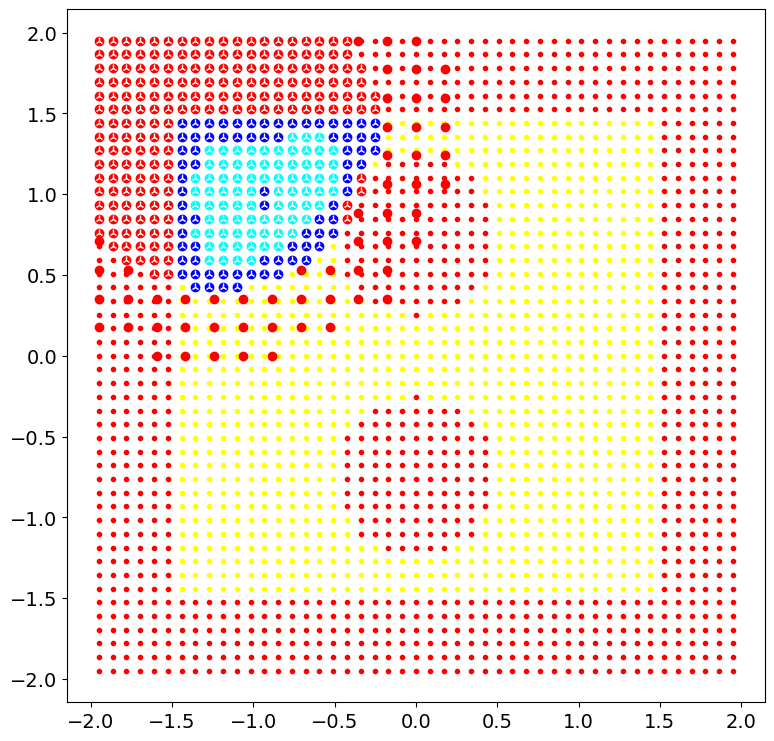

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          343     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.17697D+05    |proj g|=  1.06519D+02


 This problem is unconstrained.



At iterate   50    f=  4.70818D+02    |proj g|=  1.42390D+00

At iterate  100    f=  4.70672D+02    |proj g|=  9.13345D-01

At iterate  150    f=  4.70652D+02    |proj g|=  8.78880D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  343    191    323      1     0     0   9.943D-01   4.706D+02
  F =   470.64911142865930     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)
(441, 2)

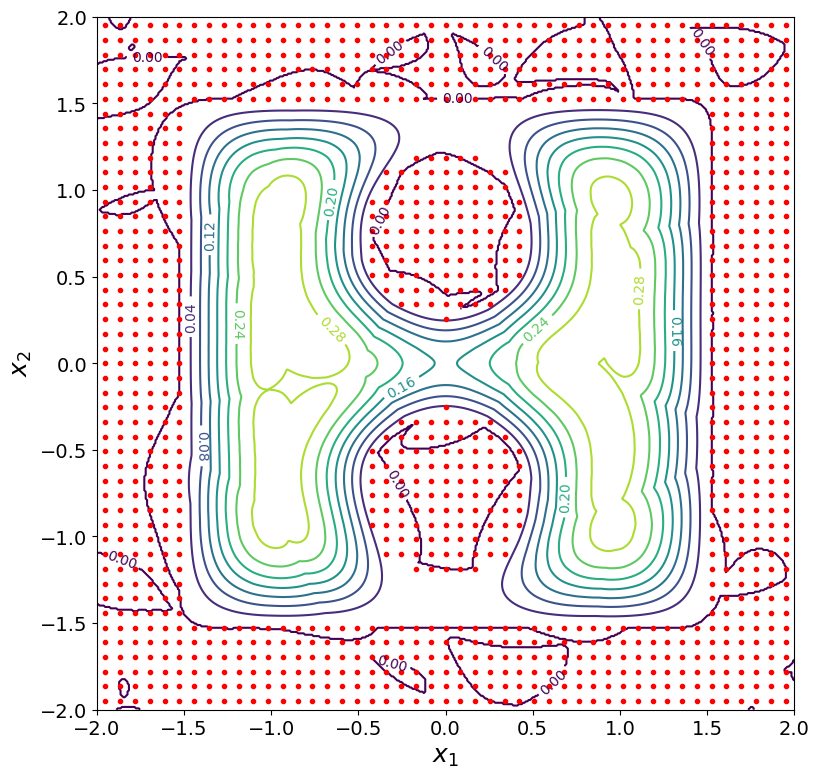

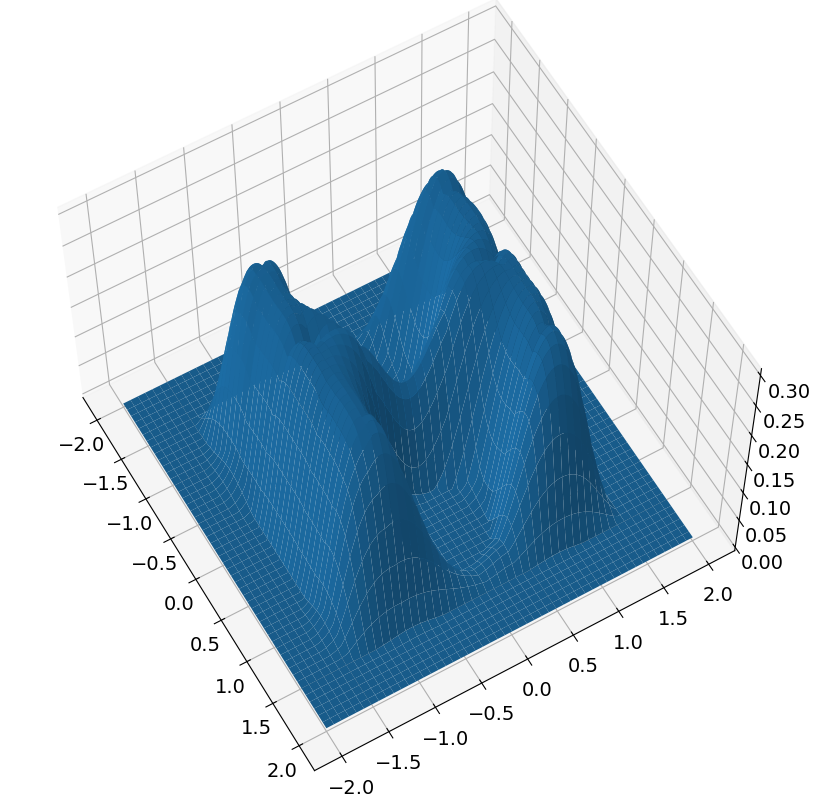

target: [-1.56345237  1.92168167]
target in goto [-1.56345237  1.92168167]
position is [-1.23267843  1.4116806 ]
h is 0.05000000000000003
start time is 1450


ValueError: f(a) and f(b) must have different signs

In [10]:
##########################
### Safe Exploration ###
##########################

for i in range(N):
    ######################
    ### Go to boundary ###
    ######################
    prev_pos = a.pos  
    while np.linalg.norm(a.pos - prev_pos) <= tol:    
        target=a.width*(1+unsafe_margin)*(np.random.rand(2)-0.5)  
        while h(target, np.array(a.centers), np.array(a.thetas))[0] > 0:
            target=a.width*(1+unsafe_margin)*(np.random.rand(2)-0.5)
        print("target:", target) 
        a.goto(target, T=T, tend=tend, tol=tol) 
        print("dx:", np.linalg.norm(a.pos - prev_pos))

    ####################
    ### Collect data ###
    ####################
    # unsafe data:
    scan_safe, scan_unsafe = a.scan()
    samples  = a.sample(rx, grid=s_grid) 
    if scan_unsafe.shape[0] != 0:
        x_unsafe = np.vstack((scan_unsafe, samples))
    else: 
        x_unsafe = samples 
    # safe and buffer data:
    n_safe = scan_safe.shape[0]
    x_buffer, x_safe = a.make_buffer(scan_safe, int(nm * n_safe), p)
    C  = [] 
    # centers:
    for x in c_grid:
        if np.linalg.norm(x - a.pos) <= rc:
            C.append(x)
    C = np.array(C)
    a.centers.append(C)
    plot_data(grid, obs_dict, [(x_safe  , "cyan"  , 'o'), 
                               (x_buffer, "blue"  , 'o'), 
                               (x_unsafe, "red"   , 'o'),
                               (C       , "white" , '2')])
    #####################
    ### Learn new CBF ###
    #####################

    L = get_learning_cbfs_lagrangian(a, x_safe, x_buffer, x_unsafe, lam_safe, lam_dyn, lam_unsafe, lam_dh, gamma_safe, gamma_dyn, gamma_unsafe)
    theta, _, _ = scipy.optimize.fmin_l_bfgs_b(L, 10*(np.random.rand(C.shape[0], 1)-5), approx_grad=False, iprint=50)
    a.thetas.append(theta)
    a.rectify_c_and_theta()
    plot_cbf(a, np.array(a.centers), np.array(a.thetas), obstacles=obstacles)